In [1]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Reading the data
exp_name = "cMzVMt3n"                     # 00qpnw78 JLcXrBTn VhrGCqQU 4wJ3GGzC 5yAGlOT6
# train_scores.nc path:
train_scores_path = f"/lustre_scratch/shaerdan/scores/train_scores_{exp_name}.nc"
# test_scores.nc path:
test_scores_path = f"/lustre_scratch/shaerdan/scores/test_scores_{exp_name}.nc"


ds_train_toy = xr.open_dataset(train_scores_path)
ds_test_toy = xr.open_dataset(test_scores_path)

print(ds_train_toy)
print(ds_test_toy)

save_plots_test = True
save_plots_train = True

print(ds_test_toy.x_eastings)
print(ds_test_toy.y_northings)


<xarray.Dataset>
Dimensions:                            (box: 15396, x: 100, y: 100, channel: 1, tasmax_chan: 1, y2: 10, x2: 10, land_cover_chan: 1, tasmin_chan: 1, rainfall_chan: 1, model_output_channel: 1, model_output_y: 100, model_output_x: 100)
Coordinates:
  * box                                (box) int64 0 1 2 3 ... 15393 15394 15395
  * x                                  (x) int64 0 1 2 3 4 5 ... 95 96 97 98 99
  * y                                  (y) int64 0 1 2 3 4 5 ... 95 96 97 98 99
  * channel                            (channel) int64 0
Dimensions without coordinates: tasmax_chan, y2, x2, land_cover_chan, tasmin_chan, rainfall_chan, model_output_channel, model_output_y, model_output_x
Data variables: (12/77)
    ST_slices                          (box, channel, y, x) float32 ...
    SW_corner_x                        (box) int32 ...
    SW_corner_y                        (box) int32 ...
    cloud_free_fractions               (box) float64 ...
    box_time             

In [2]:
# Urban Areas
urban_areas = [
    {"name": "London", "lon": -0.1276, "lat": 51.5074},
    {"name": "Birmingham", "lon": -1.8904, "lat": 52.4862},
    {"name": "Manchester", "lon": -2.2426, "lat": 53.4808},
    {"name": "Edinburgh", "lon": -3.1883, "lat": 55.9533},
    {"name": "Cardiff", "lon": -3.1791, "lat": 51.4816},
    {"name": "Glasgow", "lon": -4.2518, "lat": 55.8642},
    {"name": "Belfast", "lon": -5.9301, "lat": 54.5973},
]

# Coastal Areas
coastal_areas = [
    {"name": "Brighton", "lon": -0.1407, "lat": 50.8225},
    {"name": "Cornwall (Land's End)", "lon": -5.7126, "lat": 50.0657},
    {"name": "Blackpool", "lon": -3.0535, "lat": 53.8175},
    {"name": "Whitby", "lon": -0.6219, "lat": 54.4878},
    {"name": "Aberystwyth", "lon": -4.0836, "lat": 52.4151},
]

# Rural Areas
rural_areas = [
    {"name": "Lake District (Scafell Pike)", "lon": -3.2115, "lat": 54.4549},
    {"name": "Snowdonia (Mount Snowdon)", "lon": -4.0760, "lat": 53.0685},
    {"name": "Peak District (Mam Tor)", "lon": -1.7744, "lat": 53.3466},
    {"name": "The Cotswolds", "lon": -1.7603, "lat": 51.8838},
    {"name": "Northumberland National Park", "lon": -2.2468, "lat": 55.3167},
]

# Unique Landmarks
unique_landmarks = [
    {"name": "Stonehenge", "lon": -1.8262, "lat": 51.1788},
    {"name": "Hadrian's Wall (Housesteads)", "lon": -2.3288, "lat": 55.0121},
    {"name": "Giant's Causeway", "lon": -6.5116, "lat": 55.2408},
    {"name": "White Cliffs of Dover", "lon": 1.3646, "lat": 51.1257},
    {"name": "Isle of Skye (Old Man of Storr)", "lon": -6.0890, "lat": 57.5070},
]

# Forest and Woodland Areas
forests = [
    {"name": "Sherwood Forest", "lon": -1.0658, "lat": 53.2091},
    {"name": "New Forest", "lon": -1.5735, "lat": 50.8748},
    {"name": "Kielder Forest", "lon": -2.5711, "lat": 55.2298},
    {"name": "Forest of Dean", "lon": -2.6293, "lat": 51.8332},
]

# Islands
islands = [
    {"name": "Isle of Wight", "lon": -1.2112, "lat": 50.5953},
    {"name": "Anglesey", "lon": -4.6313, "lat": 53.3099},
    {"name": "Isle of Man", "lon": -4.4781, "lat": 54.1502},
]

# Extreme Points
extreme_points = [
    {"name": "Dunnet Head (Northernmost)", "lon": -3.3754, "lat": 58.6713},
    {"name": "Lizard Point (Southernmost)", "lon": -5.2040, "lat": 49.9608},
    {"name": "Corrachadh Mòr (Westernmost)", "lon": -6.2292, "lat": 56.7366},
    {"name": "Lowestoft Ness (Easternmost)", "lon": 1.7516, "lat": 52.4830},
]

# Combine all into one list
all_locations = (
    urban_areas
    + coastal_areas
    + rural_areas
    + unique_landmarks
    + forests
    + islands
    + extreme_points
)


In [3]:
from pyproj import Transformer

# Define transformer for converting British National Grid (EPSG:27700) back to GPS (EPSG:4326)
transformer_to_gps = Transformer.from_crs("EPSG:27700", "EPSG:4326", always_xy=True)


# Function to find coordinates from location name
def get_coordinates(location_name, all_locations):
    """
    Fetch latitude and longitude for a given location name from all_locations.
    """
    for location in all_locations:
        if location["name"].lower() == location_name.lower():
            return location["lon"], location["lat"]
    raise ValueError(f"Location '{location_name}' not found in the list of predefined locations.")

# Function to find closest scenes
def find_all_closest_scenes(ds, lon, lat, max_distance=None):
    """
    Find all box indices and their distances for scenes closest to a given GPS location (longitude, latitude).
    """
    from pyproj import Transformer
    import numpy as np

    # Define transformer for converting GPS (WGS84) to British National Grid (EPSG:4326 -> EPSG:27700)
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:27700", always_xy=True)

    # Convert the target GPS coordinates to eastings and northings
    target_easting, target_northing = transformer.transform(lon, lat)

    # Initialize list to store distances for each box
    distances = []

    # Iterate through each box index to calculate distances
    for box_index in range(ds.x_eastings.shape[0]):  # Loop over boxes
        # Extract eastings and northings for the current box
        eastings = ds.x_eastings[box_index, :].values
        northings = ds.y_northings[box_index, :].values

        # Calculate the middle point for the current box
        middle_x = eastings[len(eastings) // 2]
        middle_y = northings[len(northings) // 2]

        # Calculate the Euclidean distance to the target
        distance = np.sqrt((middle_x - target_easting) ** 2 + (middle_y - target_northing) ** 2)

        # Store the box index and distance
        distances.append((box_index, distance))

    # Optionally filter by max distance
    if max_distance is not None:
        distances = [(box_idx, dist) for box_idx, dist in distances if dist <= max_distance]

    # Sort distances by proximity
    closest_scenes = sorted(distances, key=lambda x: x[1])

    return closest_scenes

# Example usage
try:
    location_name = "London"  # Replace with the desired location name
    lon, lat = get_coordinates(location_name, all_locations)
    print(f"Coordinates for {location_name}: lon={lon}, lat={lat}")

    # Assuming ds_test_toy is defined as your xarray dataset
    all_closest_scenes = find_all_closest_scenes(ds_test_toy, lon, lat, max_distance=20000)

    # Print all the closest scenes
    for box_index, distance in all_closest_scenes:
        print(f"Scene (Box): {box_index}, Distance: {distance:.2f} meters")

except ValueError as e:
    print(e)

Coordinates for London: lon=-0.1276, lat=51.5074


In [4]:
from pyproj import Transformer

# Define transformer for converting British National Grid (EPSG:27700) back to GPS (EPSG:4326)
transformer_to_gps = Transformer.from_crs("EPSG:27700", "EPSG:4326", always_xy=True)

for box_index, distance in all_closest_scenes:
    # Extract ground truth and estimation data
    estimation = ds_test_toy.hires_estimate[box_index, 0, :, :].values
    ground_truth = ds_test_toy.ST_slices[box_index, 0, :, :].values

    # Determine shared color scale limits
    vmin = min(estimation.min(), ground_truth.min())
    vmax = max(estimation.max(), ground_truth.max())

    plt.figure(figsize=(16, 6))  # Set a larger figure size

    # Plot the estimated high resolution
    plt.subplot(1, 5, 1)  # 1 row, 5 columns, 1st subplot
    plt.pcolormesh(estimation, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Estimation")

    # Plot the actual high resolution (ground truth)
    plt.subplot(1, 5, 2)  # 1 row, 5 columns, 2nd subplot
    plt.pcolormesh(ground_truth, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Ground Truth")

    # Plot the land cover
    plt.subplot(1, 5, 3)  # 1 row, 5 columns, 3rd subplot
    plt.pcolormesh(ds_test_toy.land_cover[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Land Cover")   

    # Plot the albedo
    plt.subplot(1, 5, 4)  # 1 row, 5 columns, 4th subplot
    plt.pcolormesh(ds_test_toy.albedo[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Albedo Climatology")     

    # Plot the elevation
    plt.subplot(1, 5, 5)  # 1 row, 5 columns, 5th subplot
    plt.pcolormesh(ds_test_toy.elevation[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Elevation")        

    plt.tight_layout()
    plt.show()

    # Extract easting and northing for the center of the box
    eastings = ds_test_toy.x_eastings[box_index, :].values
    northings = ds_test_toy.y_northings[box_index, :].values

    # Calculate the middle point
    middle_easting = eastings[len(eastings) // 2]
    middle_northing = northings[len(northings) // 2]

    # Convert middle point back to GPS coordinates
    lon, lat = transformer_to_gps.transform(middle_easting, middle_northing)

    # Print additional information
    print(f"Date: {ds_test_toy.box_time[box_index].values}")
    print(f"GPS Location (lat, lon): ({lat:.6f}, {lon:.6f})")
    print(f"Easting, Northing: ({middle_easting}, {middle_northing})")


In [5]:
try:
    location_name = "Birmingham"  # Replace with the desired location name
    lon, lat = get_coordinates(location_name, all_locations)
    print(f"Coordinates for {location_name}: lon={lon}, lat={lat}")

    # Assuming ds_test_toy is defined as your xarray dataset
    all_closest_scenes = find_all_closest_scenes(ds_test_toy, lon, lat, max_distance=20000)

    # Print all the closest scenes
    for box_index, distance in all_closest_scenes:
        print(f"Scene (Box): {box_index}, Distance: {distance:.2f} meters")

except ValueError as e:
    print(e)
    
for box_index, distance in all_closest_scenes:
    estimation = ds_test_toy.hires_estimate[box_index, 0, :, :].values
    ground_truth = ds_test_toy.ST_slices[box_index, 0, :, :].values

    vmin = min(estimation.min(), ground_truth.min())
    vmax = max(estimation.max(), ground_truth.max())

    plt.figure(figsize=(16, 6))  # Set a larger figure size

    # estimated high resolution
    plt.subplot(1, 5, 1)  # 1 row, 5 columns, 1st subplot
    plt.pcolormesh(estimation, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Estimation")

    # actual high resolution (ground truth)
    plt.subplot(1, 5, 2)  # 1 row, 5 columns, 2nd subplot
    plt.pcolormesh(ground_truth, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Ground Truth")

    # the land cover
    plt.subplot(1, 5, 3)  # 1 row, 5 columns, 3rd subplot
    plt.pcolormesh(ds_test_toy.land_cover[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Land Cover")   

    # the albedo
    plt.subplot(1, 5, 4)  # 1 row, 5 columns, 4th subplot
    plt.pcolormesh(ds_test_toy.albedo[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Albedo Climatology")     

    # the elevation
    plt.subplot(1, 5, 5)  # 1 row, 5 columns, 5th subplot
    plt.pcolormesh(ds_test_toy.elevation[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Elevation")        

    plt.tight_layout()
    plt.show()

    eastings = ds_test_toy.x_eastings[box_index, :].values
    northings = ds_test_toy.y_northings[box_index, :].values
    middle_easting = eastings[len(eastings) // 2]
    middle_northing = northings[len(northings) // 2]

    # Convert middle point back to GPS coordinates
    lon, lat = transformer_to_gps.transform(middle_easting, middle_northing)

    # Print additional information
    print(f"Date: {ds_test_toy.box_time[box_index].values}")
    print(f"GPS Location (lat, lon): ({lat:.6f}, {lon:.6f})")
    print(f"Easting, Northing: ({middle_easting}, {middle_northing})")    
    

Coordinates for Birmingham: lon=-1.8904, lat=52.4862


Coordinates for New Forest: lon=-1.5735, lat=50.8748
Scene (Box): 9922, Distance: 46058.86 meters
Scene (Box): 10508, Distance: 46058.86 meters
Scene (Box): 10690, Distance: 46058.86 meters
Scene (Box): 10091, Distance: 46082.67 meters
Scene (Box): 10570, Distance: 46082.67 meters
Scene (Box): 10607, Distance: 46082.67 meters
Scene (Box): 10565, Distance: 46128.14 meters
Scene (Box): 10276, Distance: 46195.22 meters
Scene (Box): 10096, Distance: 46283.81 meters
Scene (Box): 9951, Distance: 46393.80 meters
Scene (Box): 10538, Distance: 46393.80 meters
Scene (Box): 10762, Distance: 46525.02 meters
Scene (Box): 10890, Distance: 46525.02 meters
Scene (Box): 10618, Distance: 46677.30 meters
Scene (Box): 10031, Distance: 46850.44 meters
Scene (Box): 10059, Distance: 47058.78 meters
Scene (Box): 10137, Distance: 47058.78 meters
Scene (Box): 10399, Distance: 47058.78 meters
Scene (Box): 10847, Distance: 47058.78 meters
Scene (Box): 9924, Distance: 47082.08 meters
Scene (Box): 10068, Distance: 

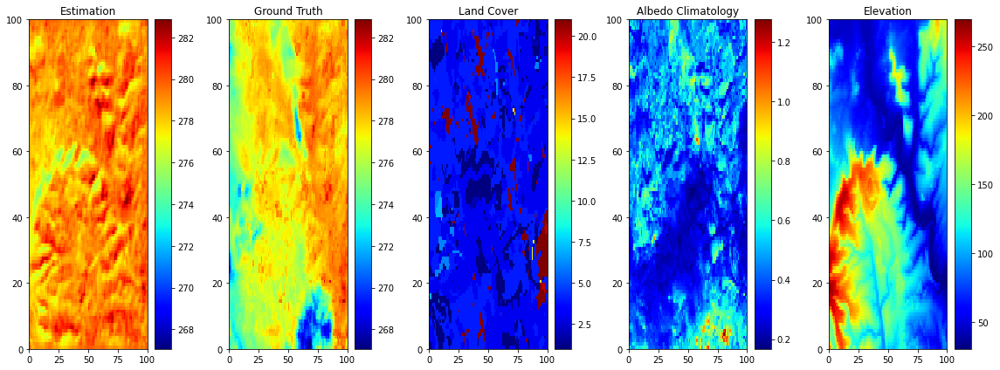

Date: 2014-02-01T10:59:38.000000000
GPS Location (lat, lon): (50.880719, -2.228089)
Easting, Northing: (384050, 109050)


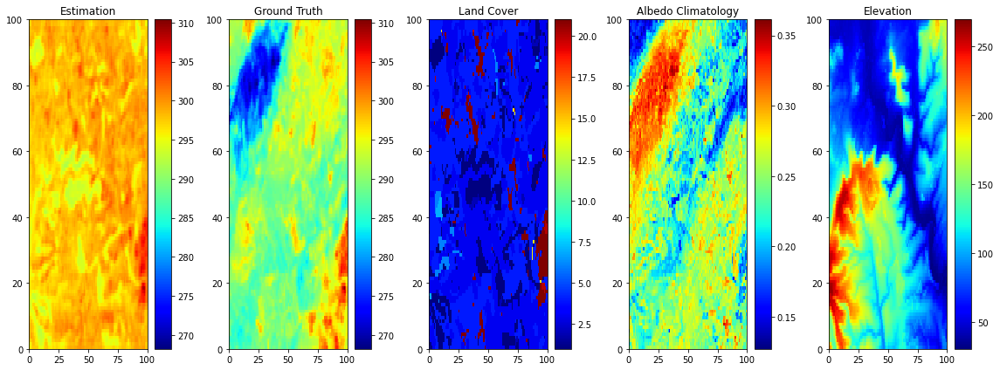

Date: 2020-05-08T10:57:57.000000000
GPS Location (lat, lon): (50.880719, -2.228089)
Easting, Northing: (384050, 109050)


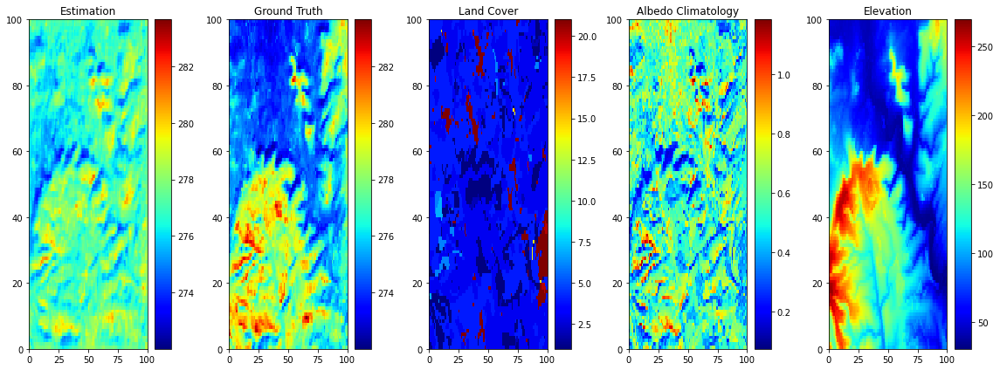

Date: 2022-01-13T11:04:59.000000000
GPS Location (lat, lon): (50.880719, -2.228089)
Easting, Northing: (384050, 109050)


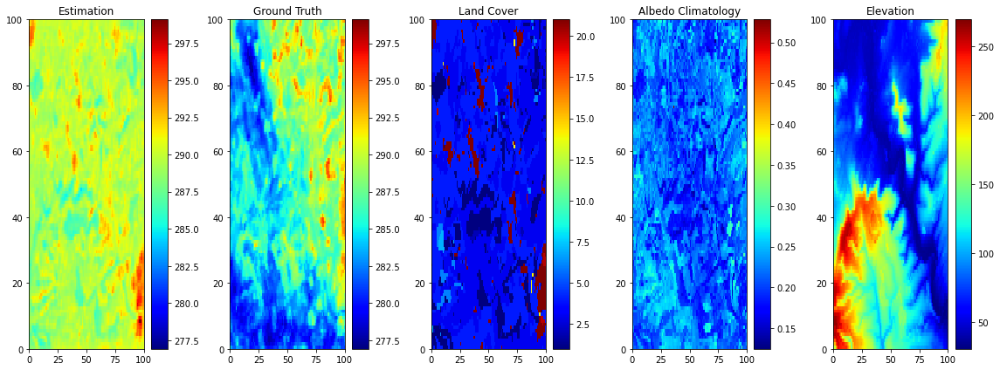

Date: 2016-05-04T11:04:22.000000000
GPS Location (lat, lon): (50.889712, -2.228133)
Easting, Northing: (384050, 110050)


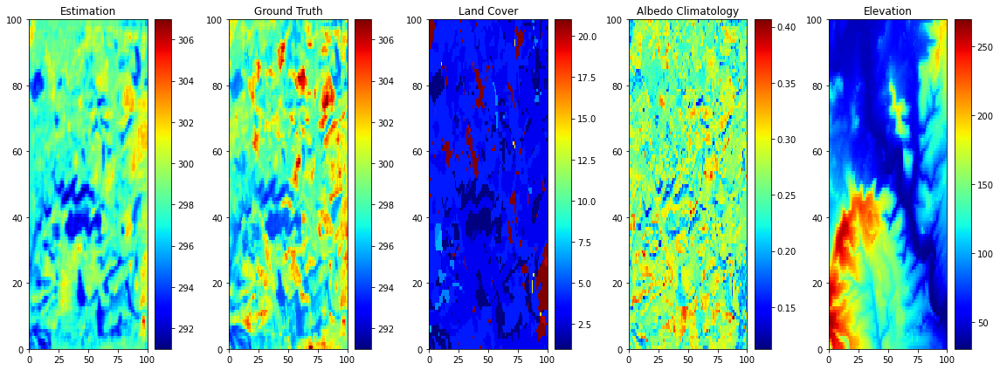

Date: 2020-09-13T10:58:48.000000000
GPS Location (lat, lon): (50.889712, -2.228133)
Easting, Northing: (384050, 110050)


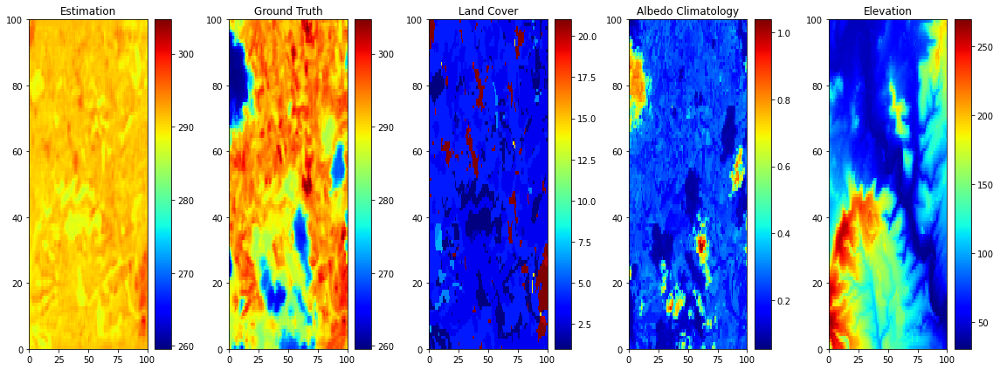

Date: 2021-05-02T11:04:17.000000000
GPS Location (lat, lon): (50.889712, -2.228133)
Easting, Northing: (384050, 110050)


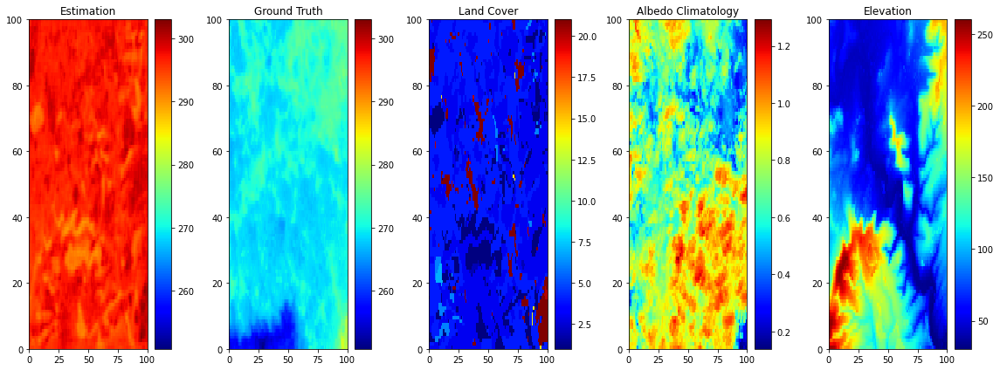

Date: 2020-09-04T11:05:19.000000000
GPS Location (lat, lon): (50.898704, -2.228177)
Easting, Northing: (384050, 111050)


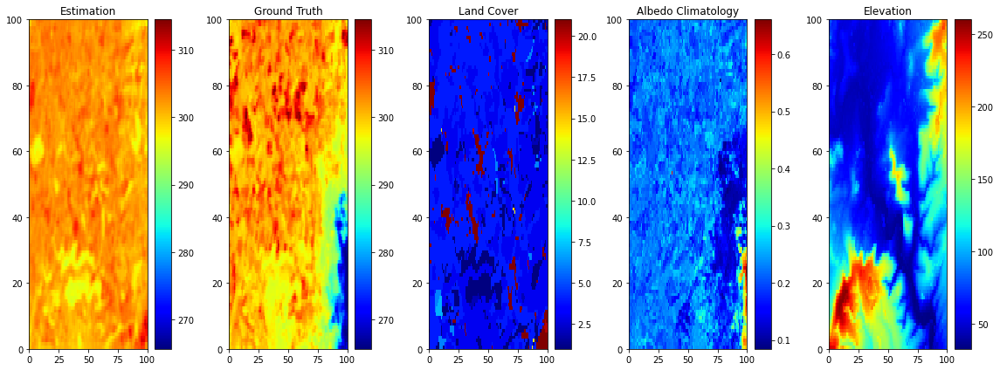

Date: 2018-06-11T11:03:36.000000000
GPS Location (lat, lon): (50.907696, -2.228221)
Easting, Northing: (384050, 112050)


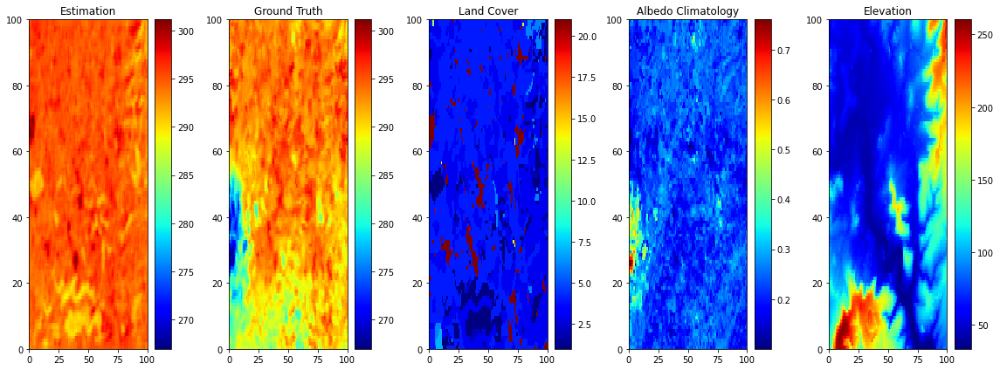

Date: 2016-05-13T10:58:06.000000000
GPS Location (lat, lon): (50.916689, -2.228265)
Easting, Northing: (384050, 113050)


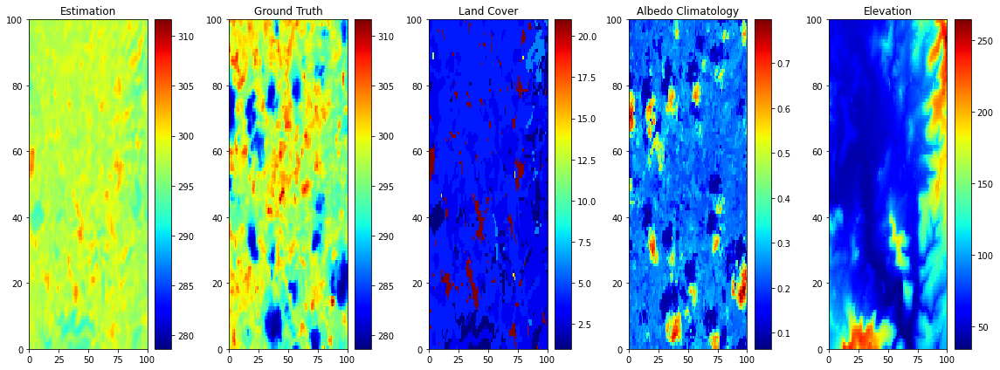

Date: 2014-06-25T10:58:17.000000000
GPS Location (lat, lon): (50.925681, -2.228309)
Easting, Northing: (384050, 114050)


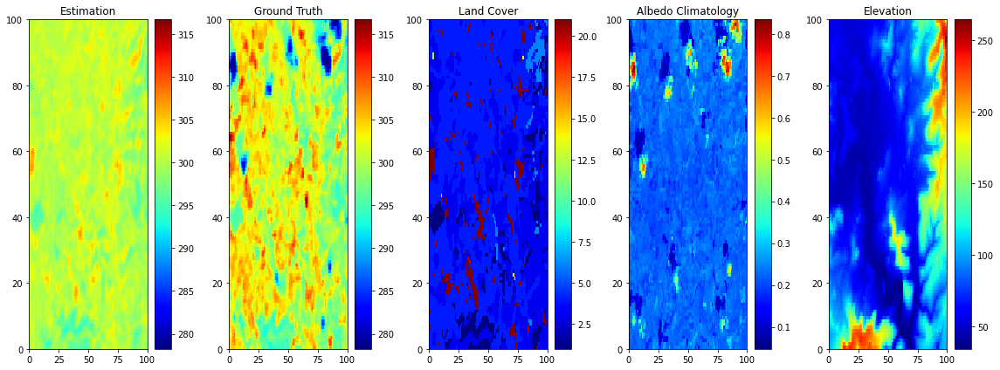

Date: 2020-06-09T10:58:09.000000000
GPS Location (lat, lon): (50.925681, -2.228309)
Easting, Northing: (384050, 114050)


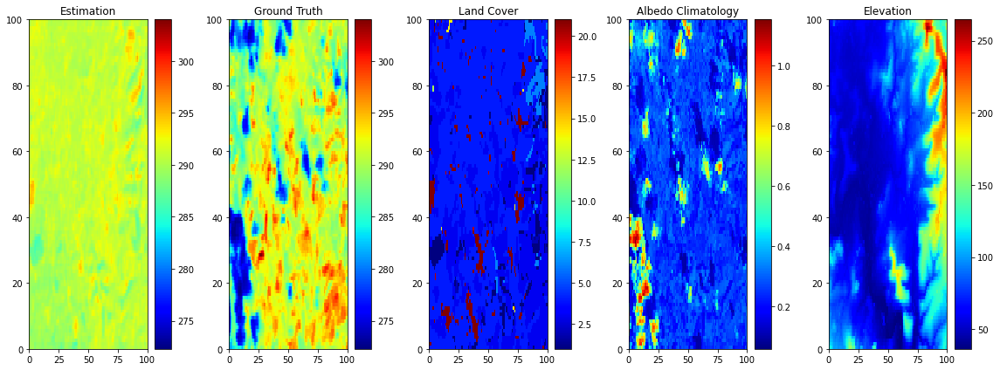

Date: 2022-04-19T11:04:34.000000000
GPS Location (lat, lon): (50.934673, -2.228353)
Easting, Northing: (384050, 115050)


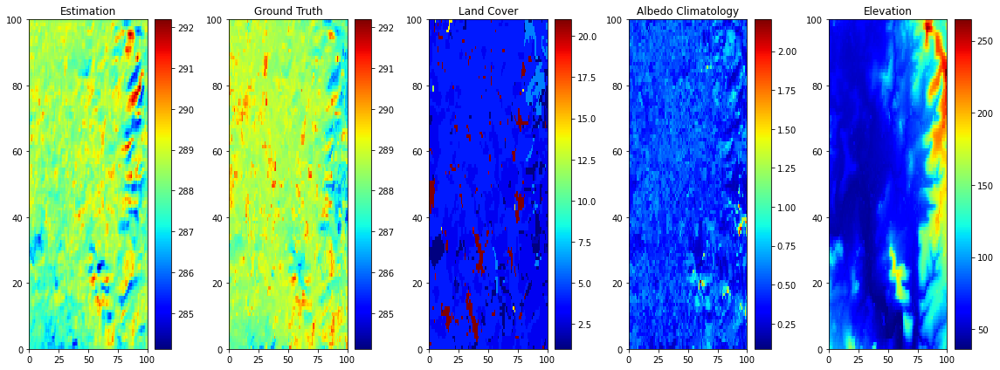

Date: 2022-11-13T11:05:19.000000000
GPS Location (lat, lon): (50.934673, -2.228353)
Easting, Northing: (384050, 115050)


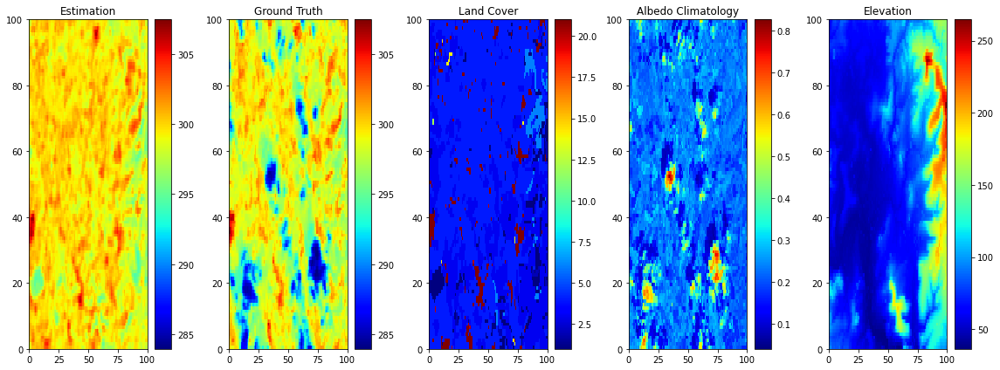

Date: 2021-07-14T10:58:29.000000000
GPS Location (lat, lon): (50.943665, -2.228397)
Easting, Northing: (384050, 116050)


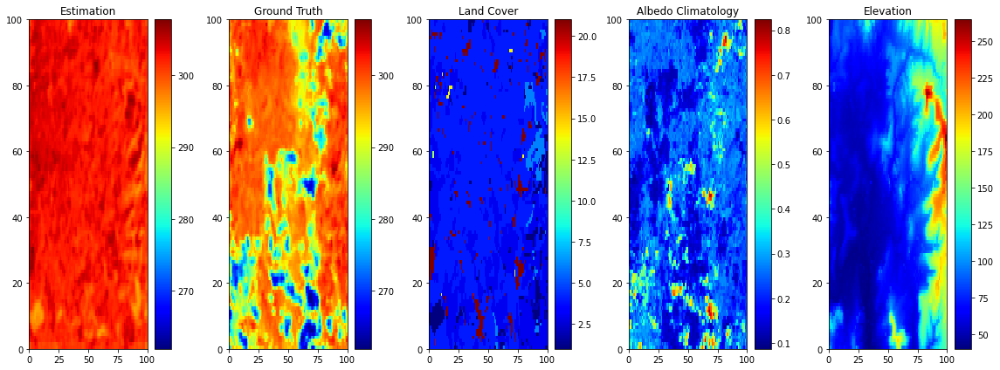

Date: 2015-08-22T11:04:31.000000000
GPS Location (lat, lon): (50.952658, -2.228441)
Easting, Northing: (384050, 117050)


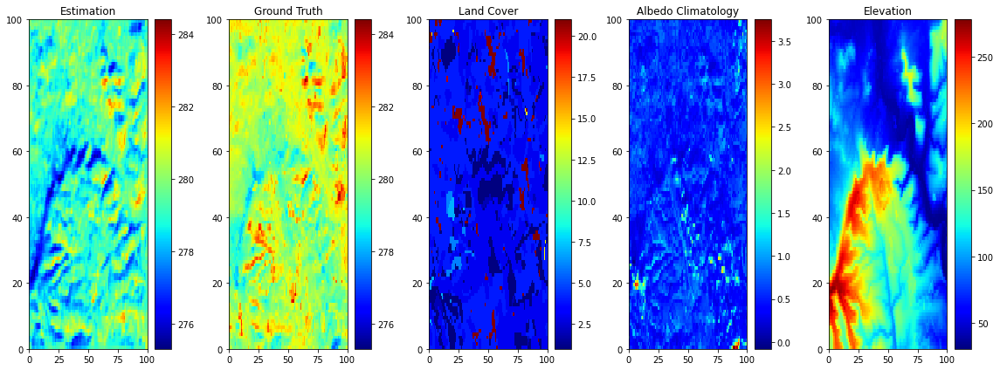

Date: 2016-01-06T10:59:02.000000000
GPS Location (lat, lon): (50.880691, -2.242303)
Easting, Northing: (383050, 109050)


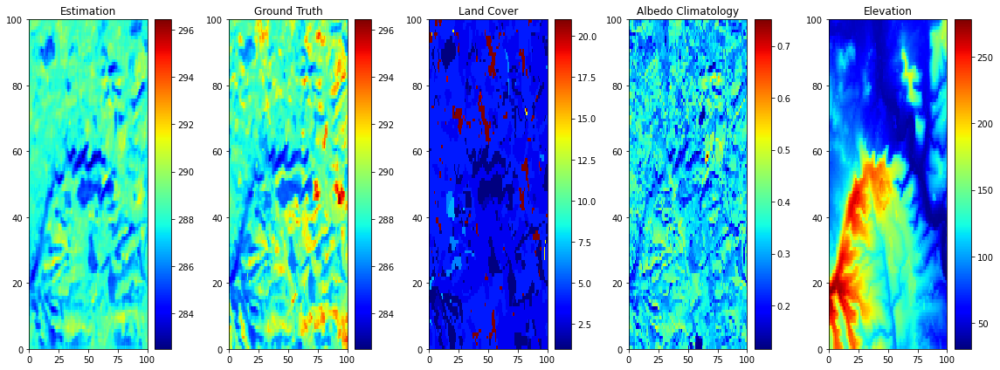

Date: 2016-10-11T11:05:03.000000000
GPS Location (lat, lon): (50.880691, -2.242303)
Easting, Northing: (383050, 109050)


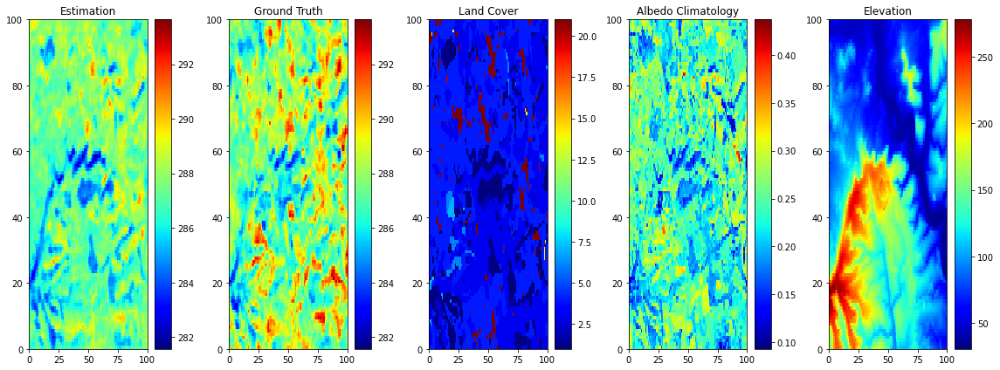

Date: 2019-04-11T11:04:14.000000000
GPS Location (lat, lon): (50.880691, -2.242303)
Easting, Northing: (383050, 109050)


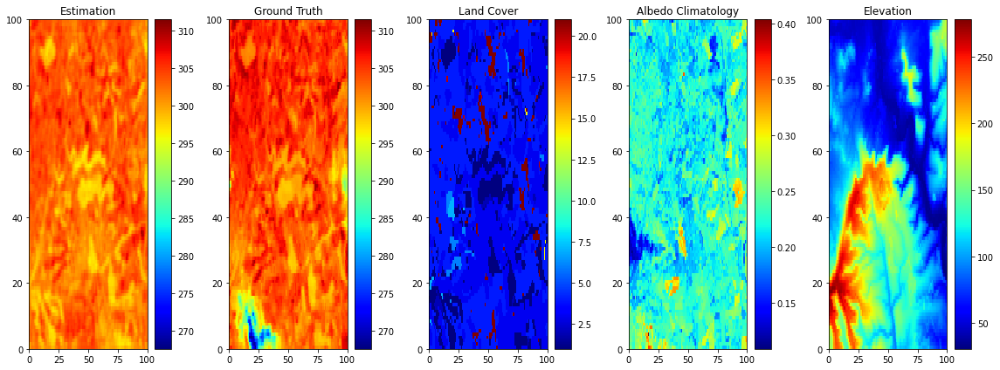

Date: 2022-07-17T10:58:49.000000000
GPS Location (lat, lon): (50.880691, -2.242303)
Easting, Northing: (383050, 109050)


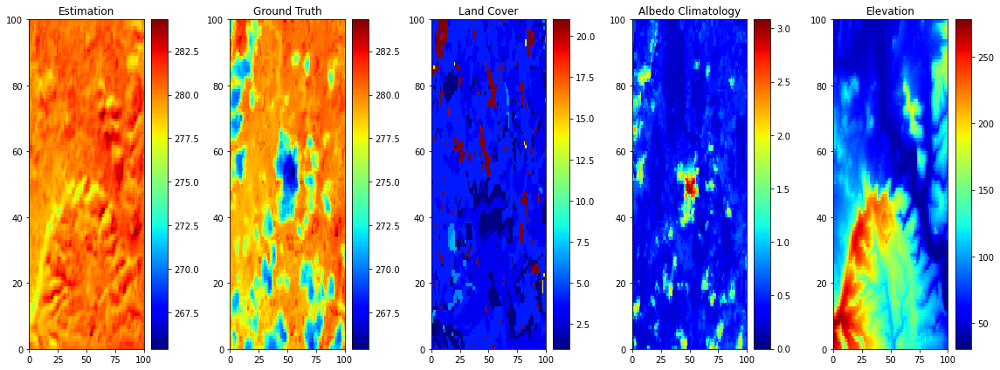

Date: 2014-02-08T11:05:42.000000000
GPS Location (lat, lon): (50.889683, -2.242350)
Easting, Northing: (383050, 110050)


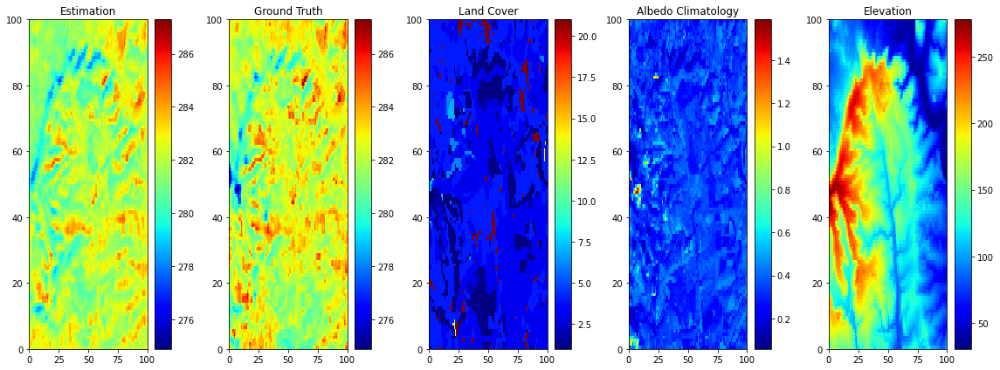

Date: 2016-02-23T10:58:28.000000000
GPS Location (lat, lon): (50.853713, -2.242163)
Easting, Northing: (383050, 106050)


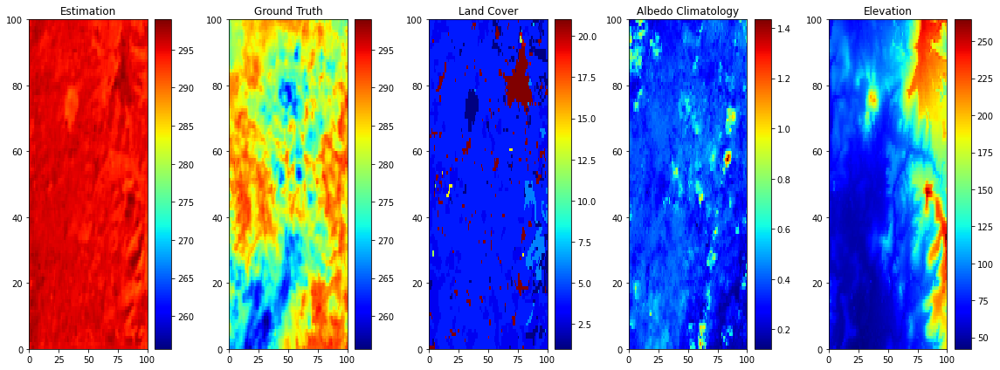

Date: 2014-09-29T10:59:06.000000000
GPS Location (lat, lon): (50.979634, -2.228574)
Easting, Northing: (384050, 120050)


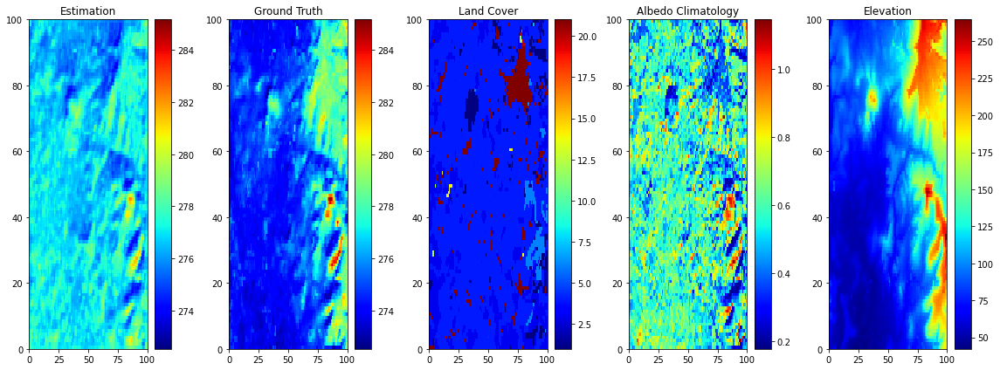

Date: 2022-01-13T11:04:59.000000000
GPS Location (lat, lon): (50.979634, -2.228574)
Easting, Northing: (384050, 120050)


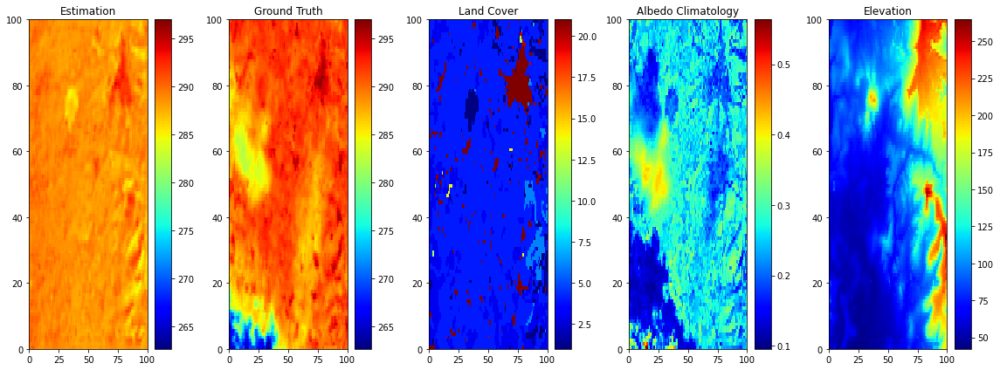

Date: 2022-04-11T11:04:38.000000000
GPS Location (lat, lon): (50.979634, -2.228574)
Easting, Northing: (384050, 120050)


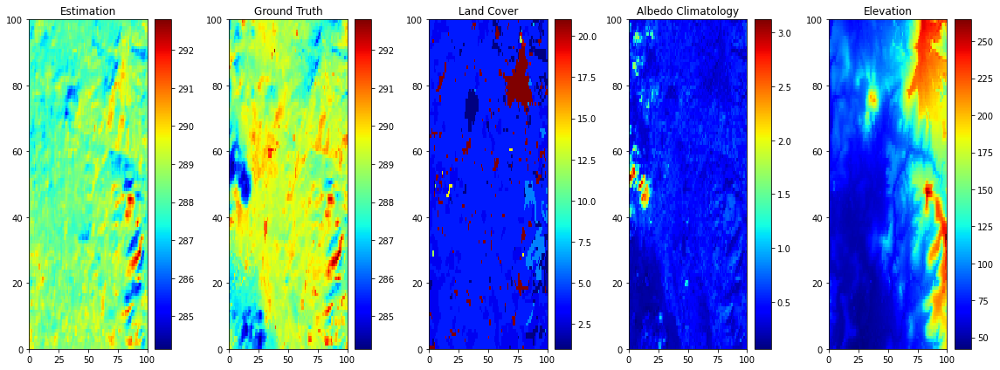

Date: 2022-11-14T10:59:26.000000000
GPS Location (lat, lon): (50.979634, -2.228574)
Easting, Northing: (384050, 120050)


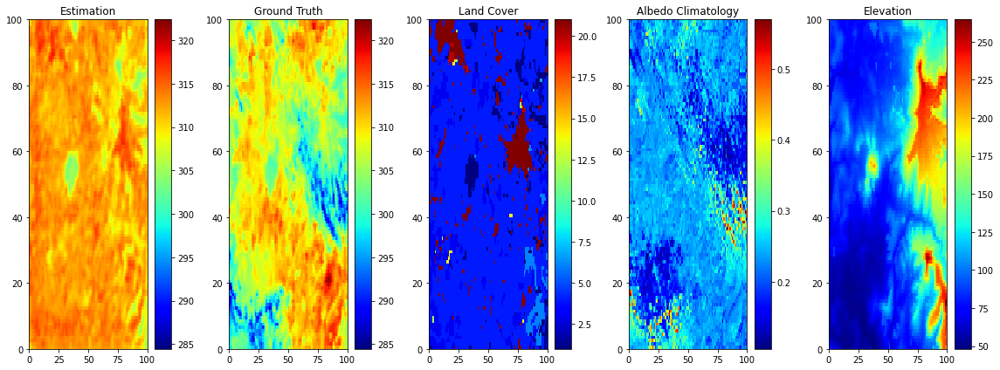

Date: 2020-08-12T10:58:33.000000000
GPS Location (lat, lon): (50.997619, -2.228662)
Easting, Northing: (384050, 122050)


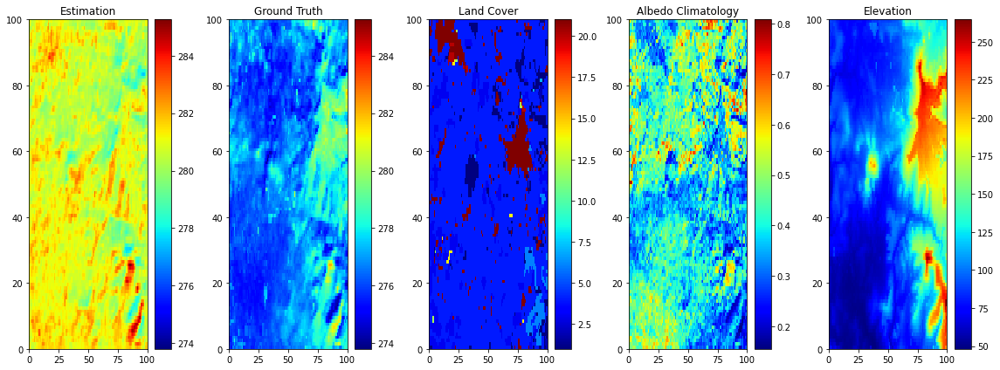

Date: 2022-01-30T10:58:51.000000000
GPS Location (lat, lon): (50.997619, -2.228662)
Easting, Northing: (384050, 122050)


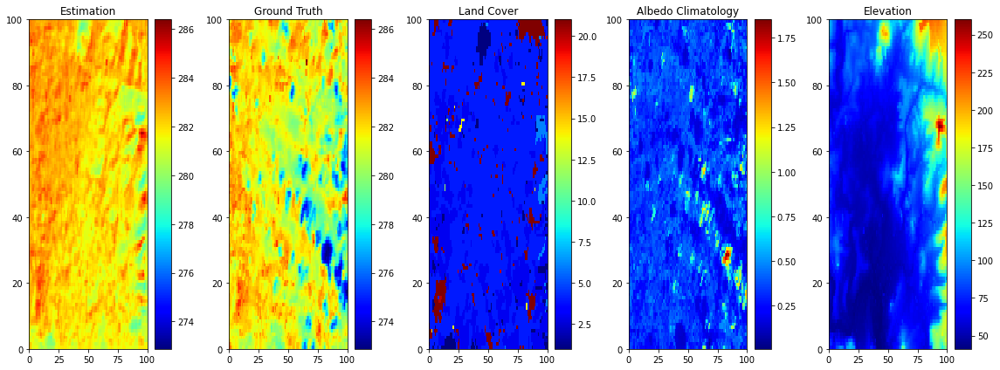

Date: 2015-02-27T11:04:32.000000000
GPS Location (lat, lon): (50.961621, -2.242724)
Easting, Northing: (383050, 118050)


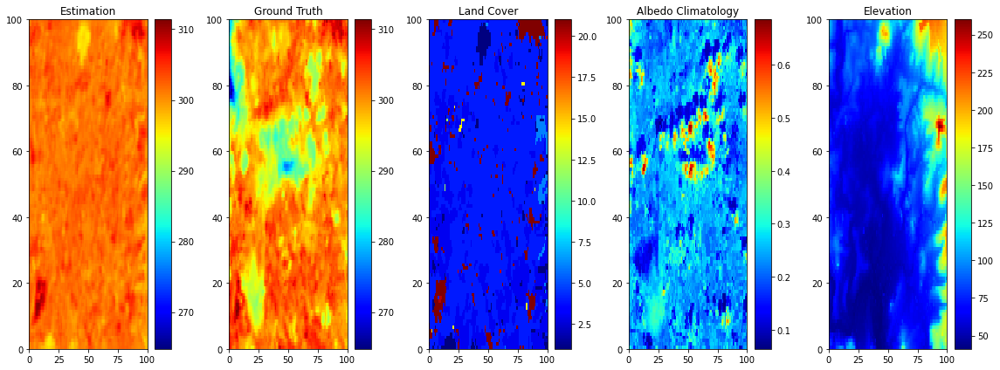

Date: 2016-07-16T10:58:32.000000000
GPS Location (lat, lon): (50.961621, -2.242724)
Easting, Northing: (383050, 118050)


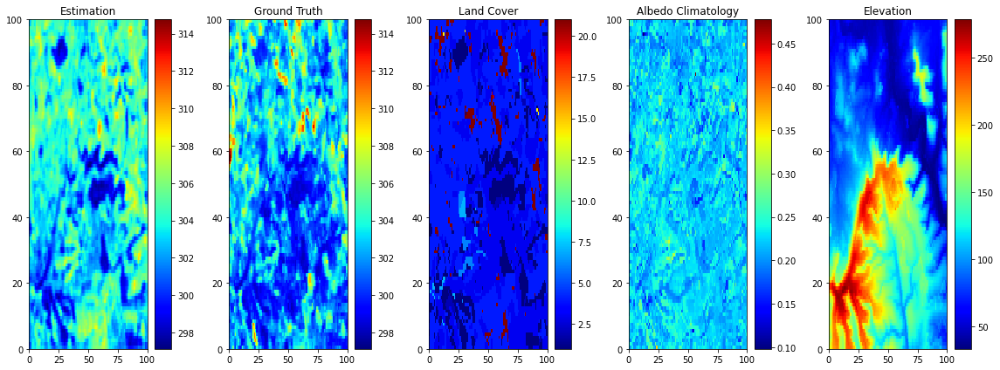

Date: 2013-07-08T11:00:34.000000000
GPS Location (lat, lon): (50.880660, -2.256517)
Easting, Northing: (382050, 109050)


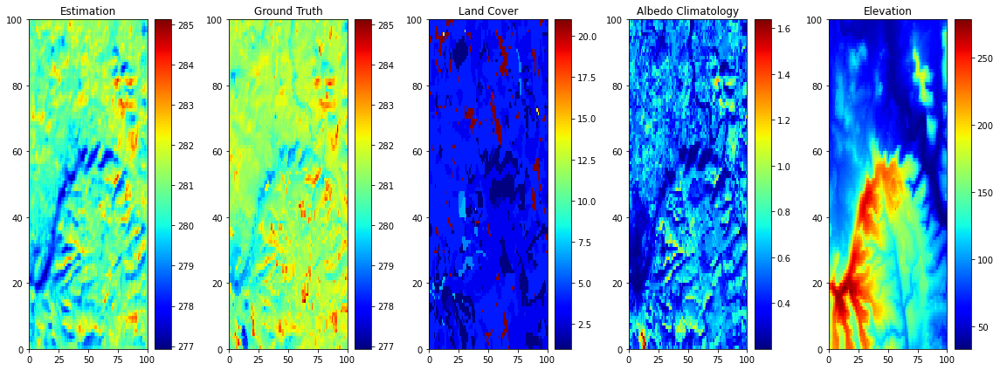

Date: 2018-12-20T11:05:01.000000000
GPS Location (lat, lon): (50.880660, -2.256517)
Easting, Northing: (382050, 109050)


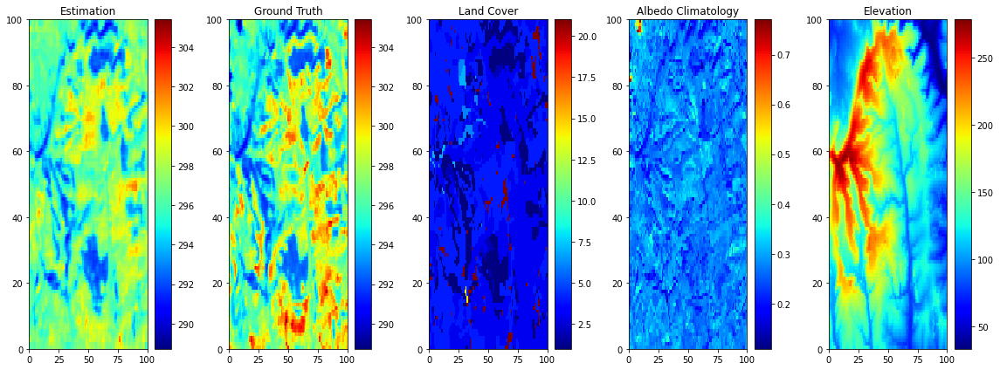

Date: 2016-09-18T10:58:48.000000000
GPS Location (lat, lon): (50.844691, -2.256320)
Easting, Northing: (382050, 105050)


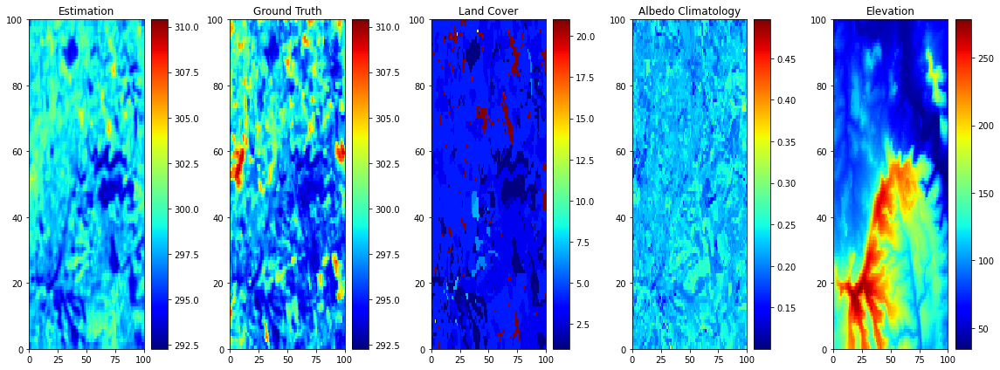

Date: 2013-06-06T11:00:36.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


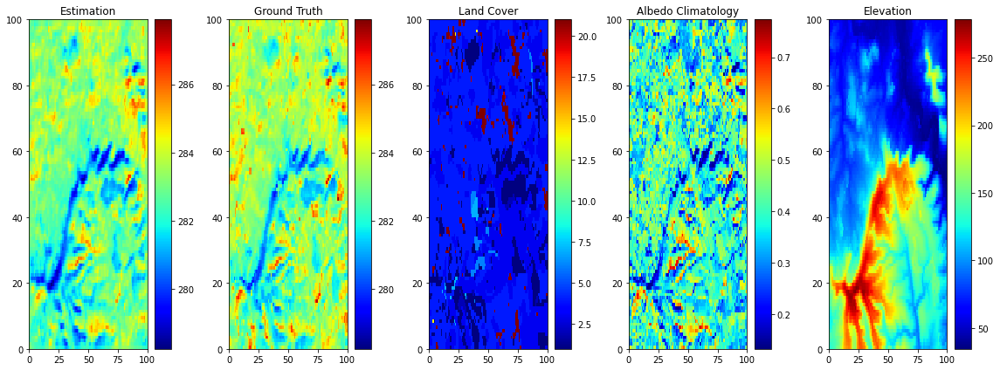

Date: 2013-11-04T11:06:30.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


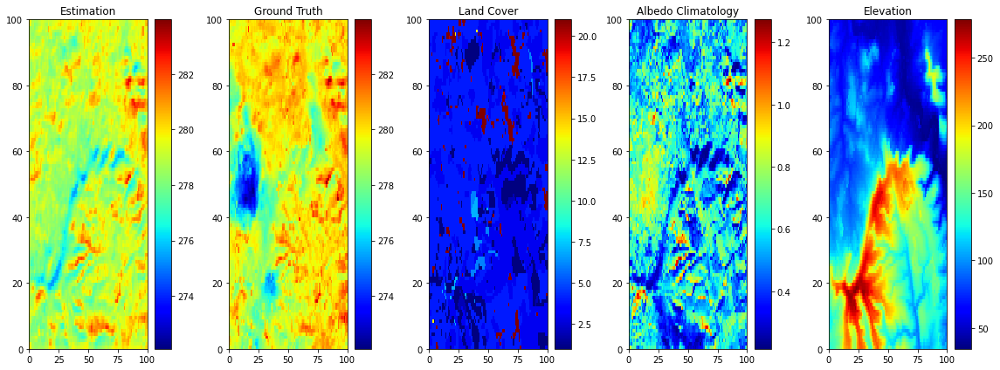

Date: 2013-12-06T11:06:22.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


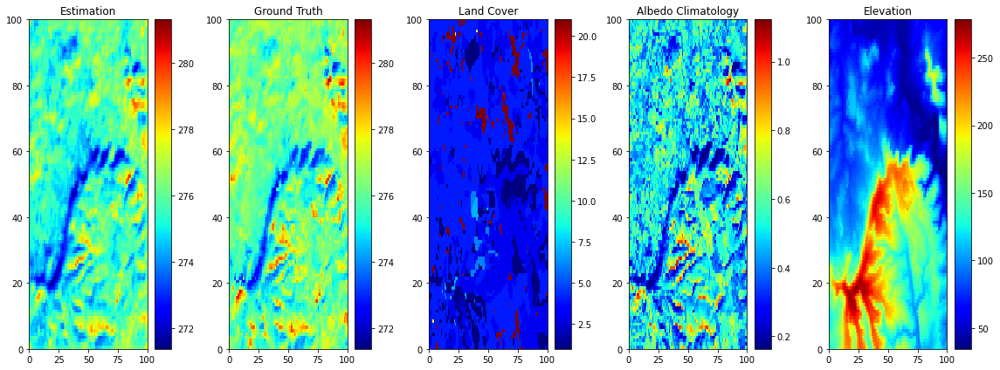

Date: 2015-01-19T10:58:34.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


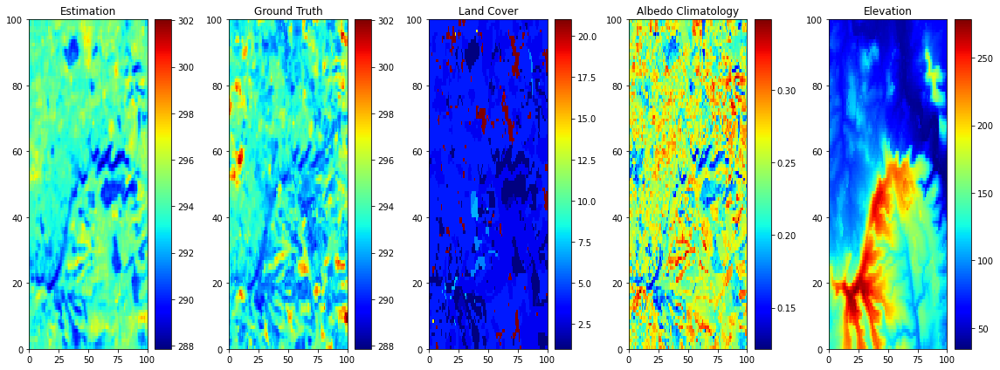

Date: 2015-04-09T10:57:56.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


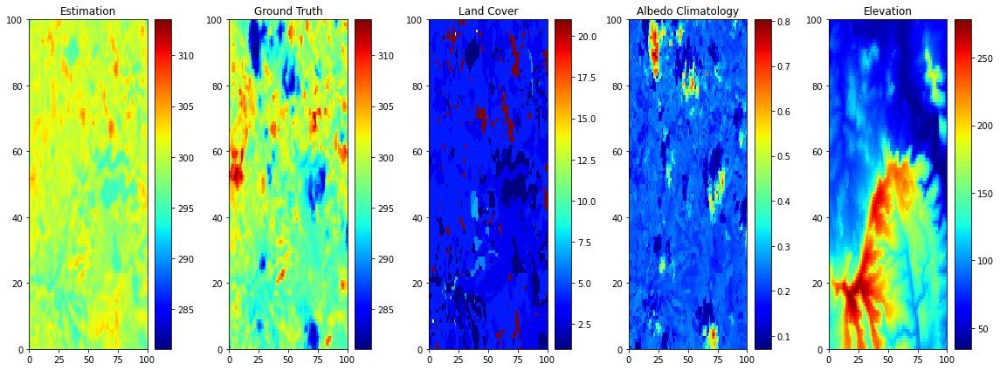

Date: 2015-06-19T11:04:03.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


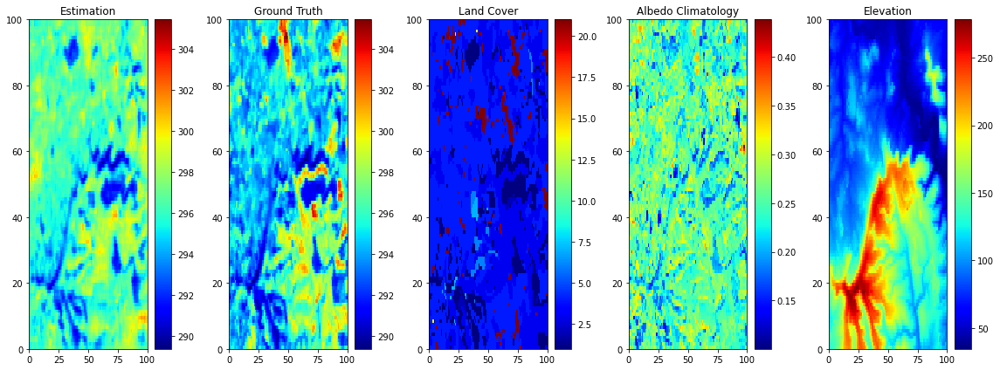

Date: 2015-09-07T11:04:36.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


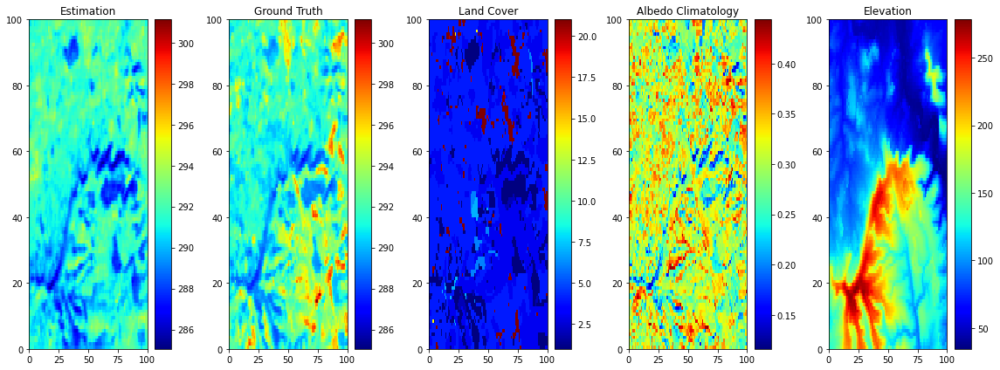

Date: 2015-10-02T10:58:35.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


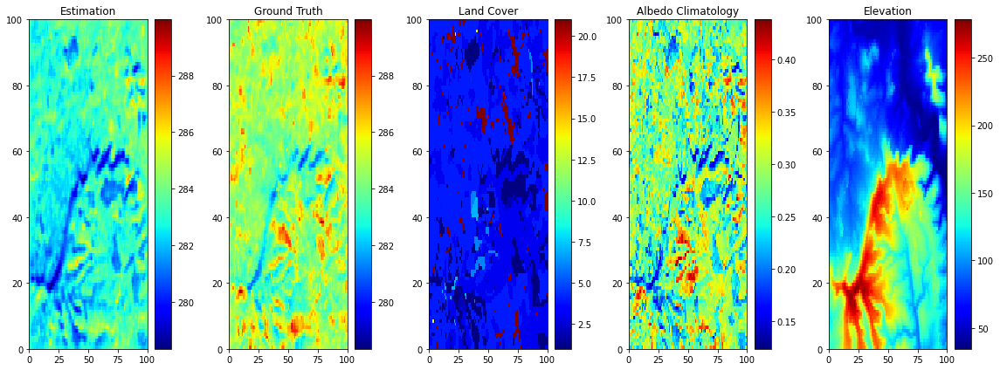

Date: 2016-03-17T11:04:34.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


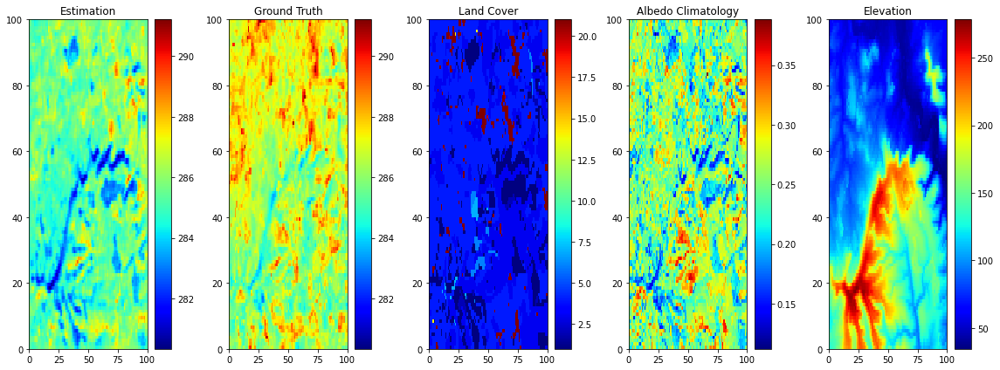

Date: 2016-04-02T11:04:24.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


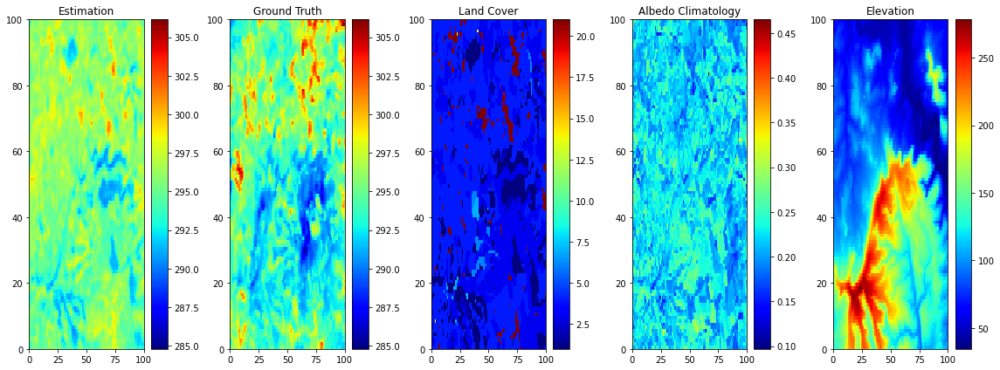

Date: 2016-05-29T10:58:13.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


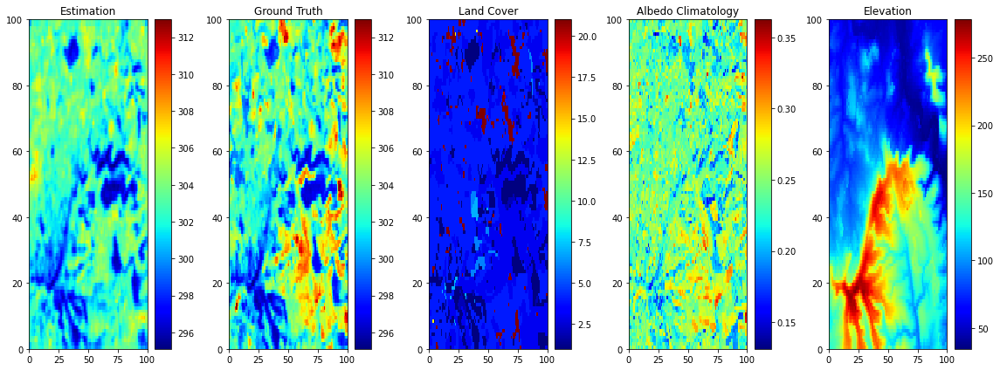

Date: 2016-08-17T10:58:39.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


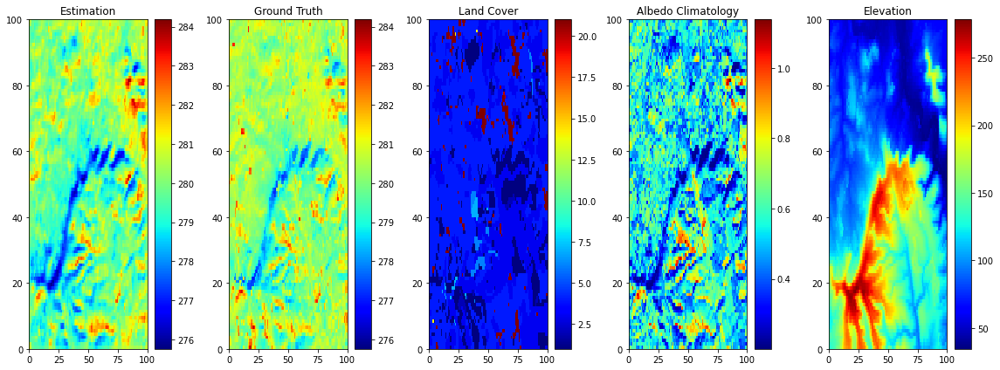

Date: 2016-11-28T11:05:05.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


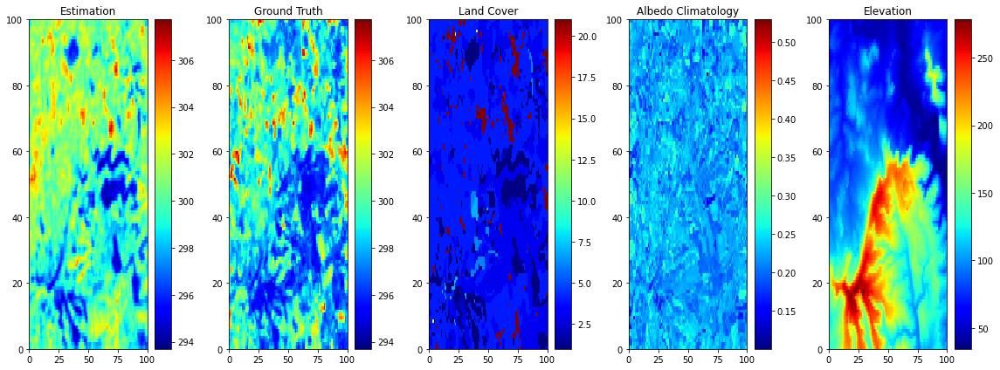

Date: 2017-06-01T10:58:10.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


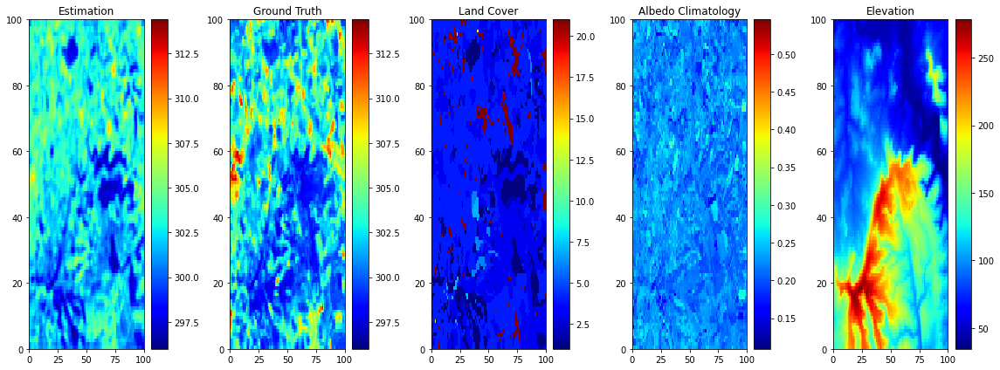

Date: 2017-06-17T10:58:17.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


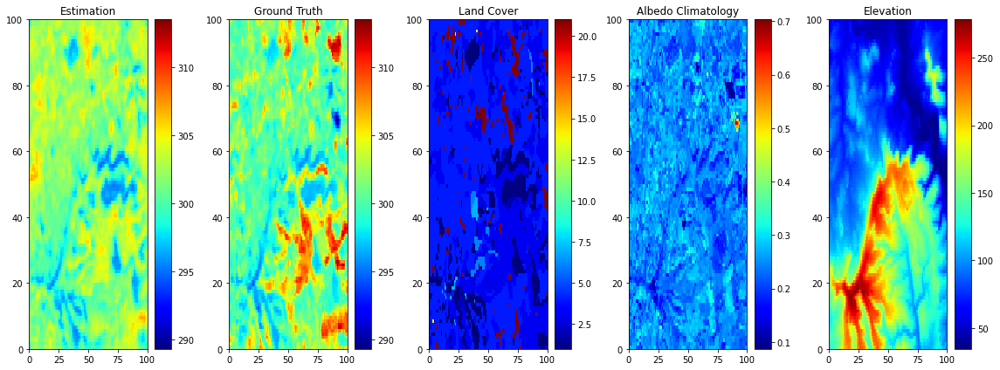

Date: 2017-08-27T11:04:50.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


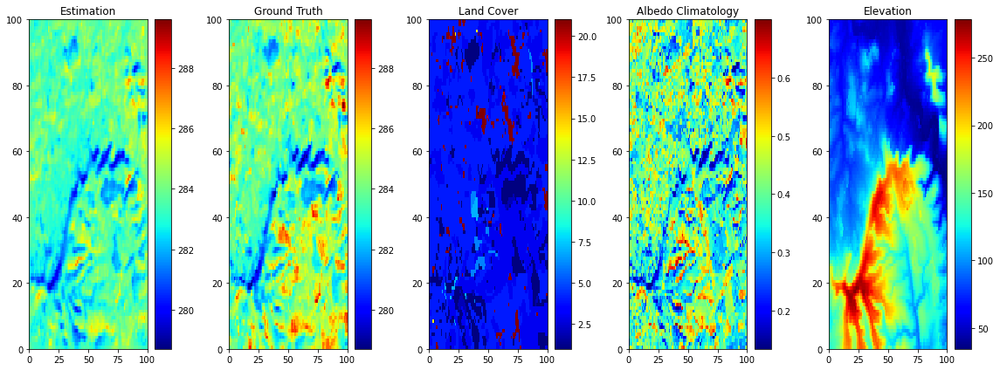

Date: 2017-10-30T11:05:03.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


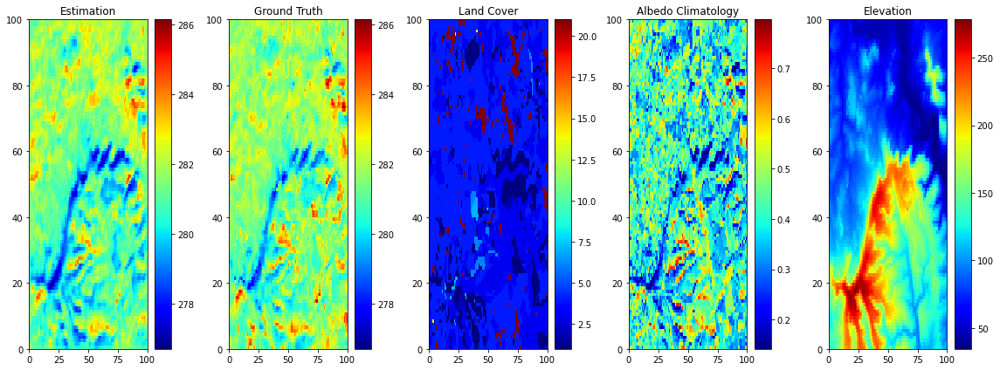

Date: 2017-11-08T10:58:51.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


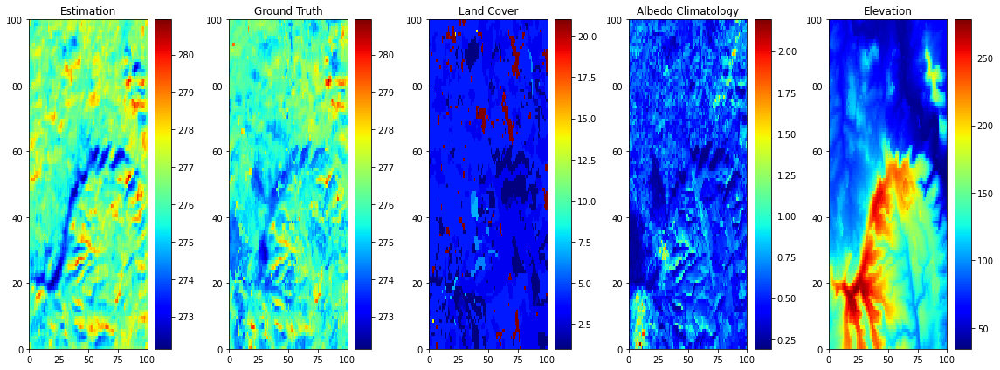

Date: 2017-12-01T11:04:54.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


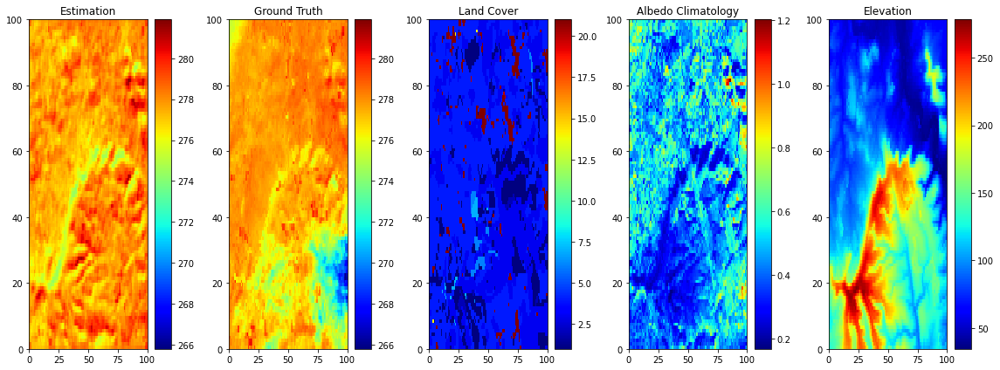

Date: 2017-12-26T10:59:09.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


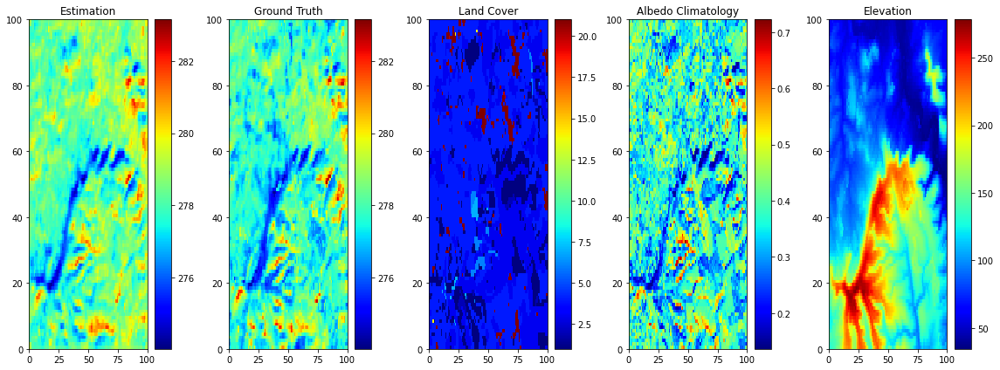

Date: 2018-02-12T10:58:23.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


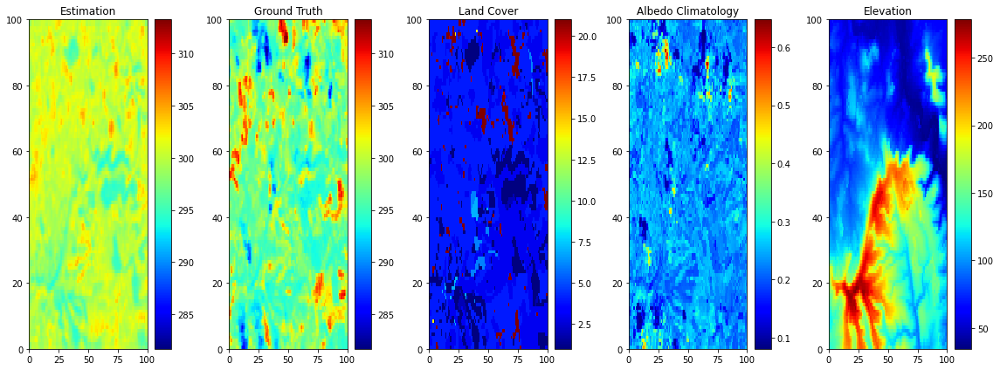

Date: 2018-05-19T10:57:32.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


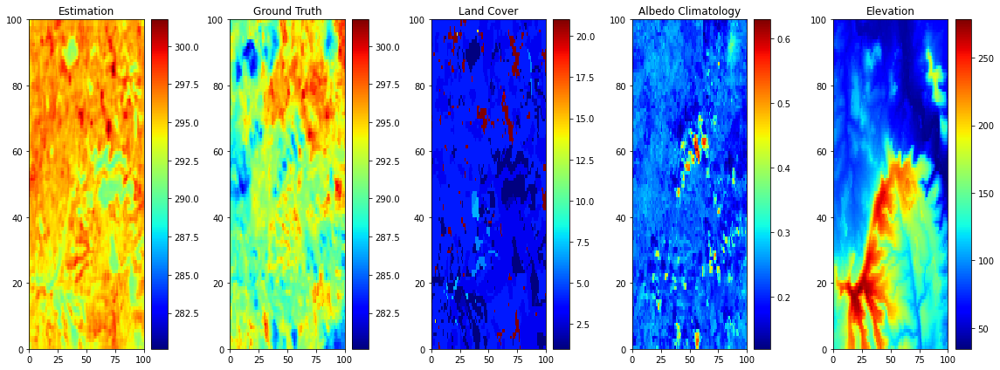

Date: 2018-05-26T11:04:01.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


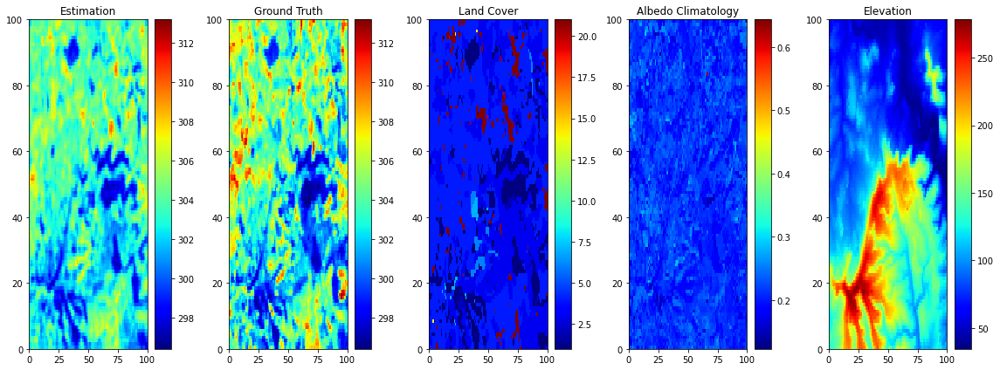

Date: 2018-06-27T11:03:46.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


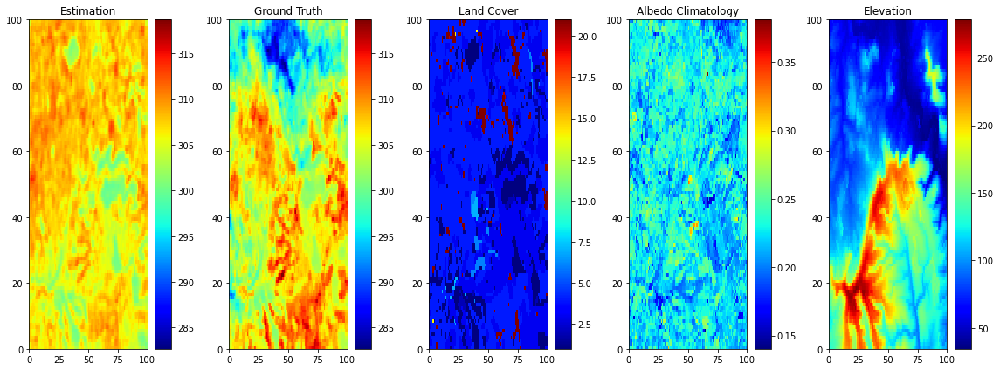

Date: 2018-07-06T10:57:40.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


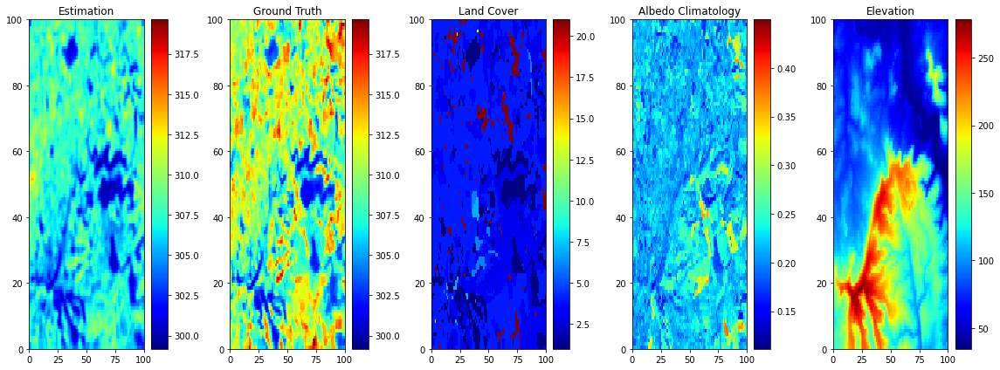

Date: 2018-07-22T10:57:47.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


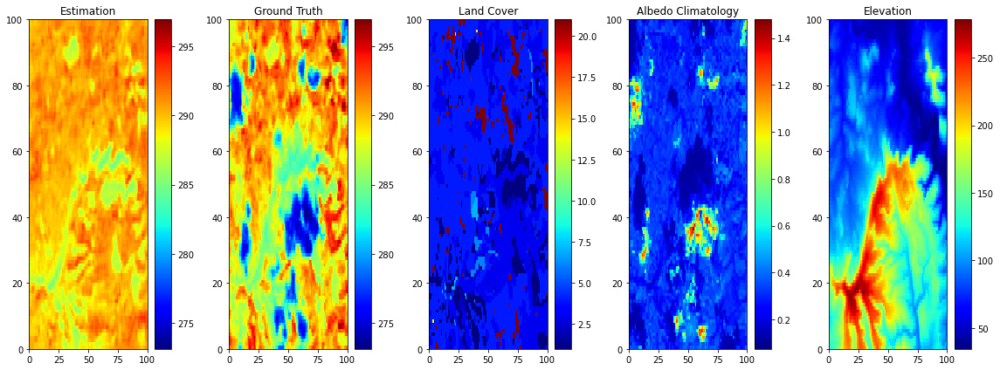

Date: 2018-10-01T11:04:29.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


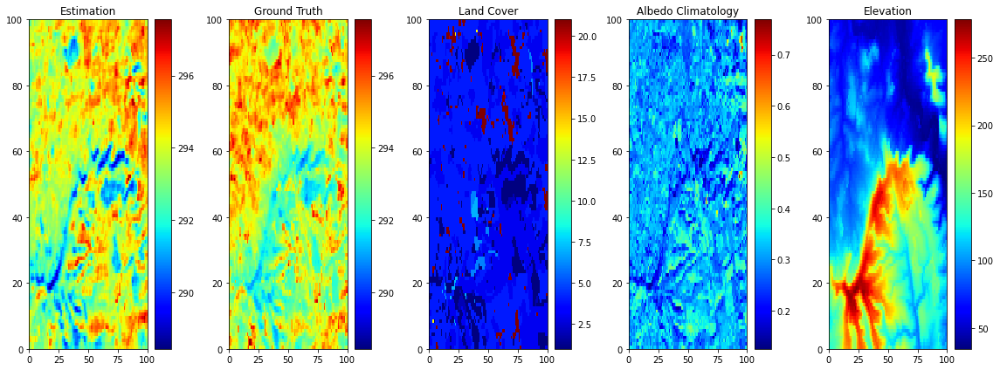

Date: 2018-10-10T10:58:23.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


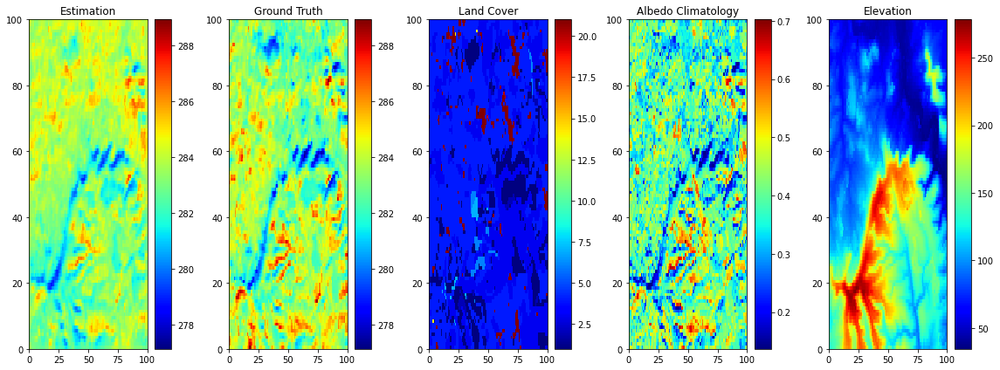

Date: 2018-11-02T11:04:40.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


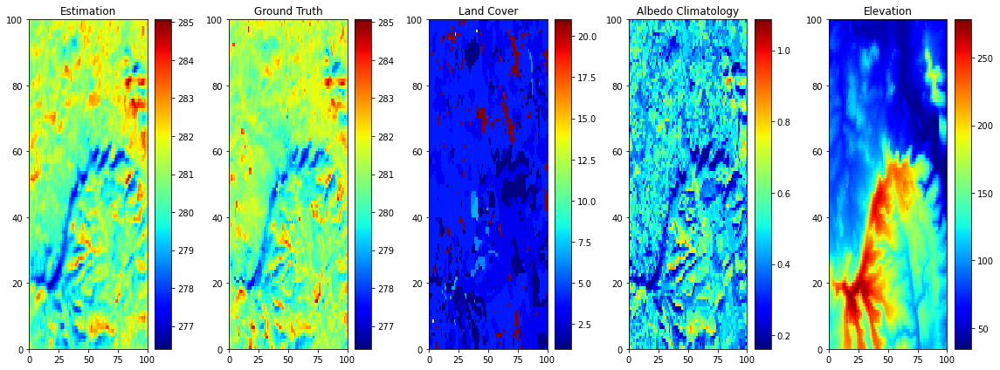

Date: 2018-11-18T11:04:41.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


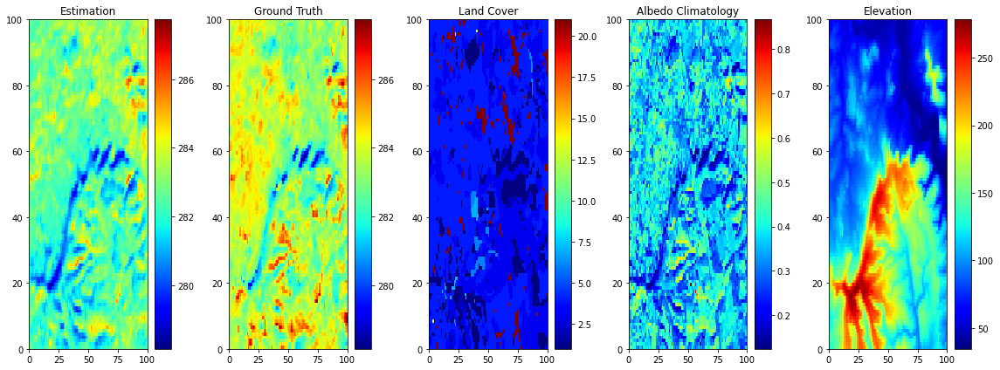

Date: 2019-02-15T10:58:18.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


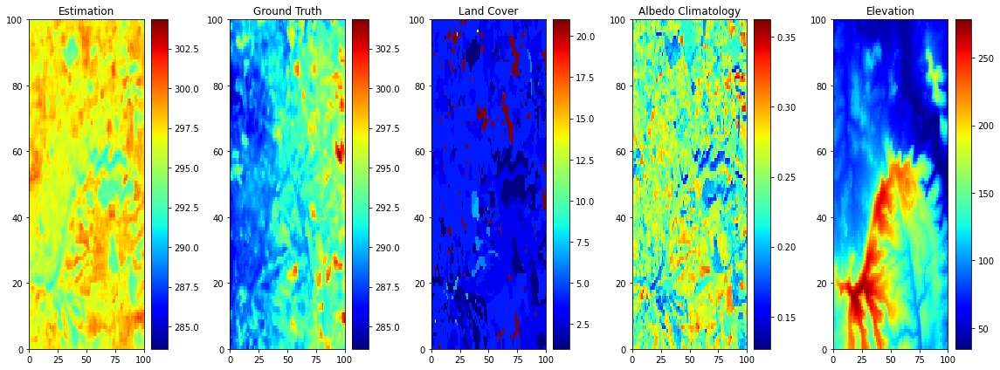

Date: 2019-04-20T10:58:00.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


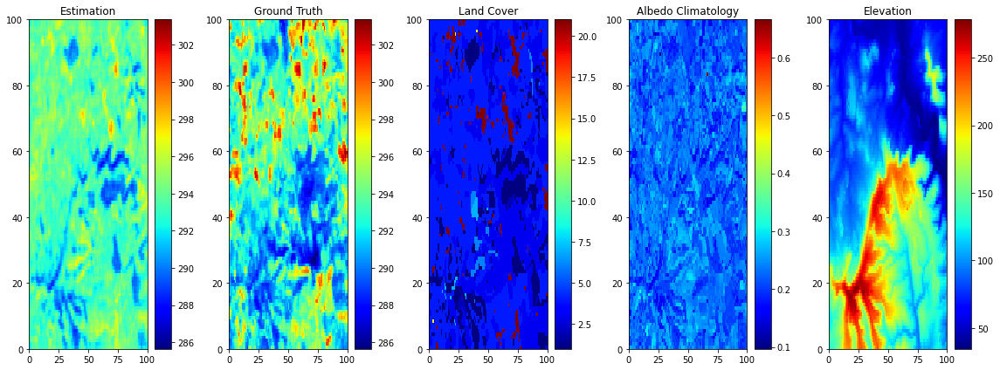

Date: 2019-05-13T11:04:18.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


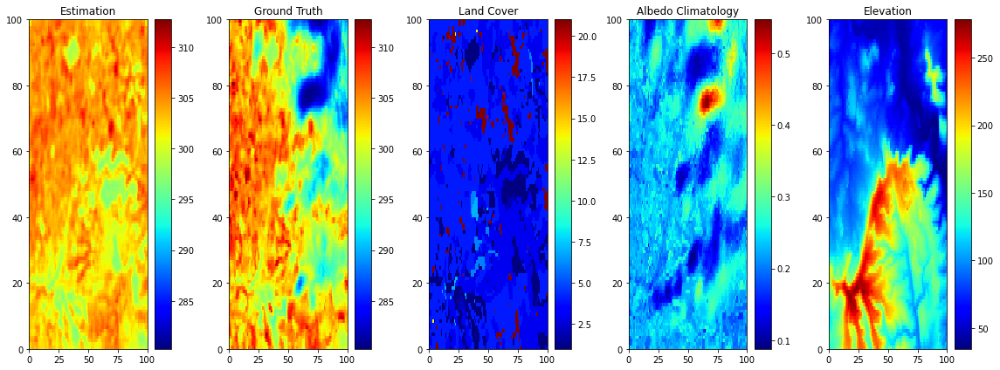

Date: 2019-07-09T10:58:54.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


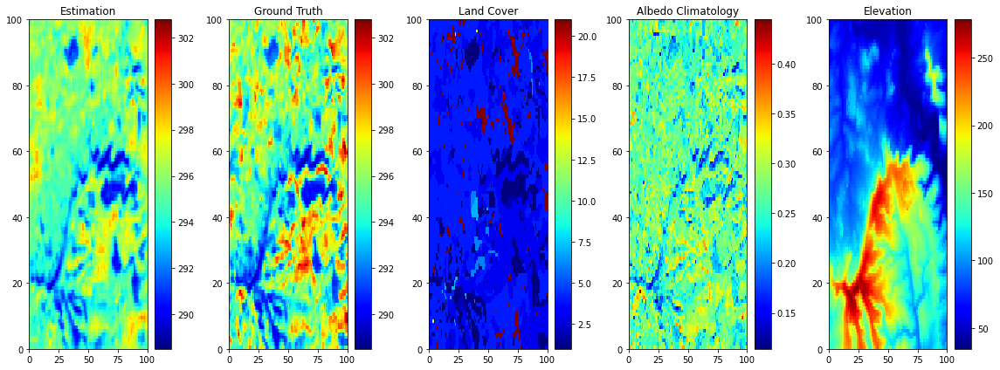

Date: 2019-09-18T11:05:02.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


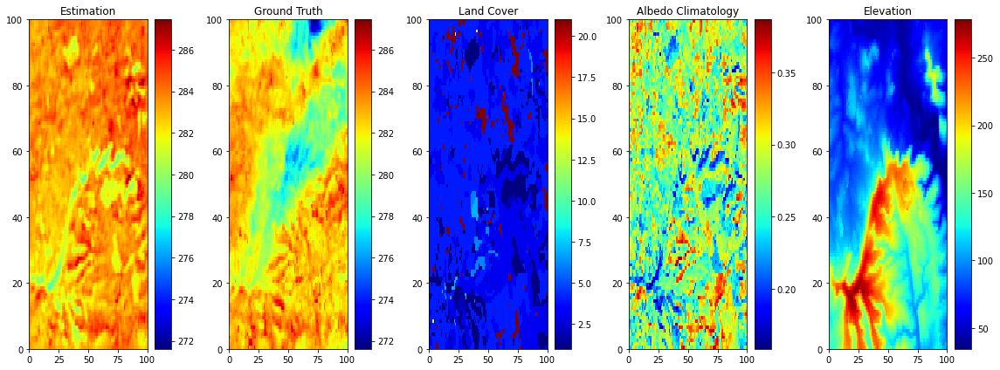

Date: 2020-03-21T10:58:22.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


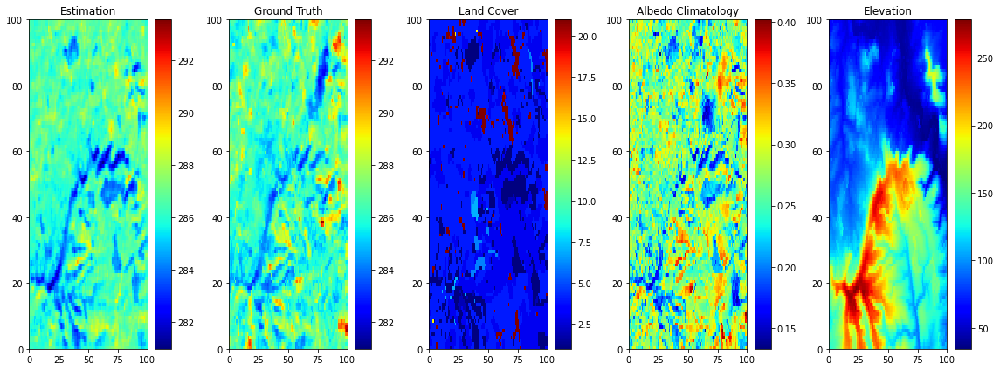

Date: 2020-03-28T11:04:29.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


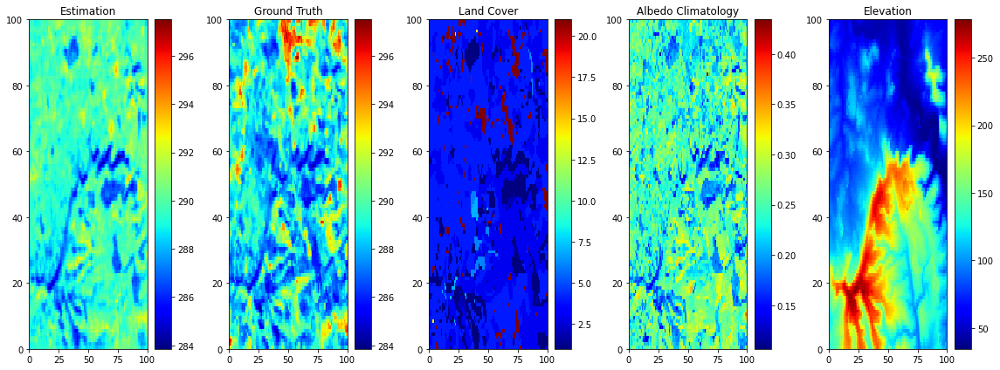

Date: 2020-04-13T11:04:22.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


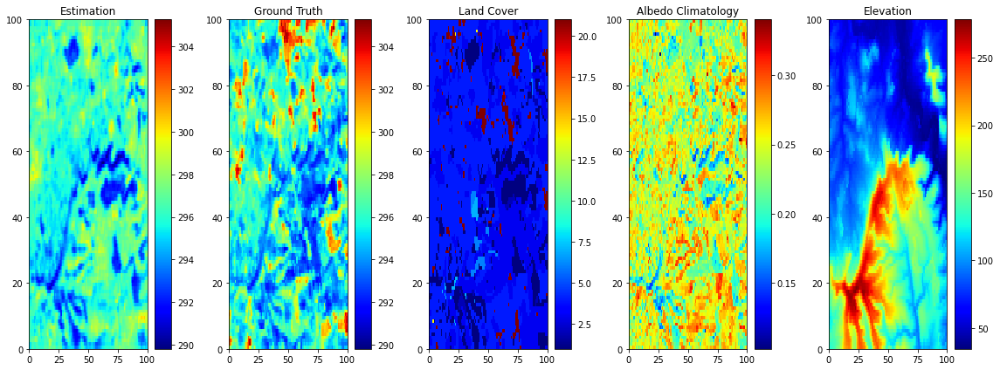

Date: 2020-04-22T10:58:07.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


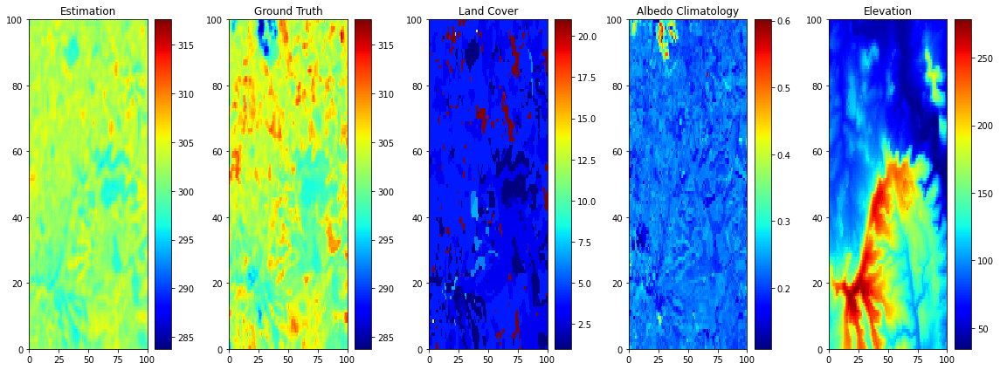

Date: 2020-05-31T11:04:14.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


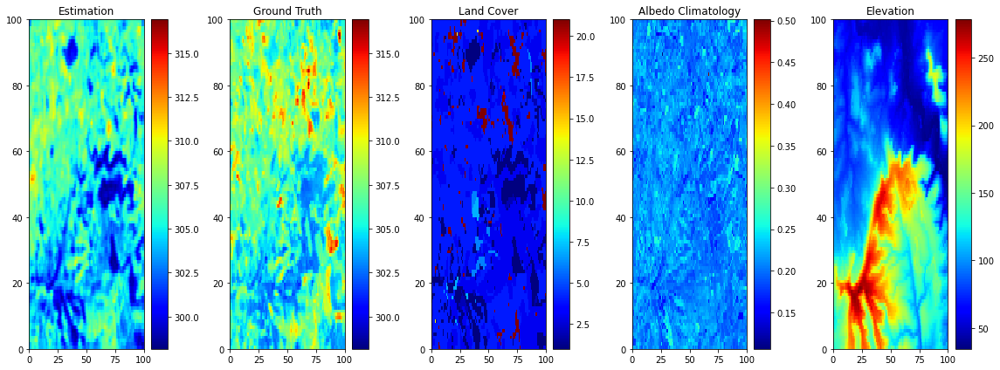

Date: 2020-06-25T10:58:18.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


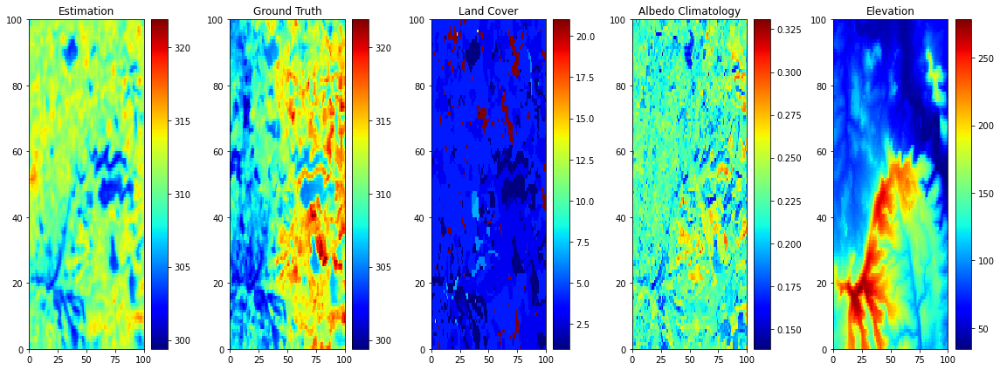

Date: 2020-08-12T10:58:33.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


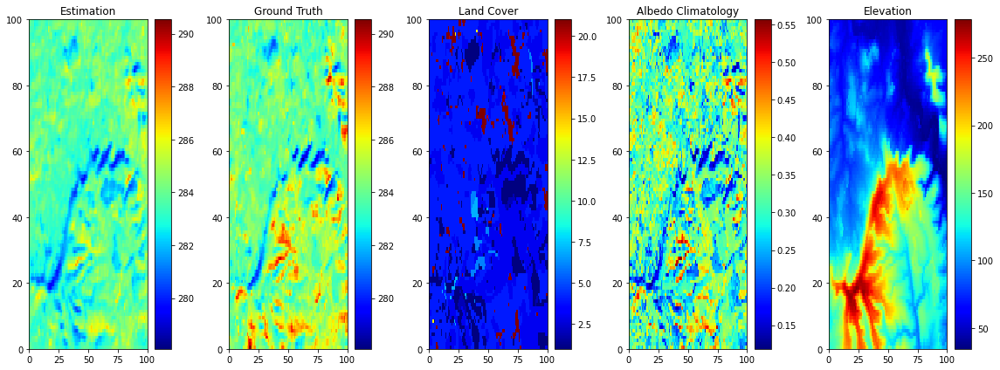

Date: 2021-02-27T11:04:45.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


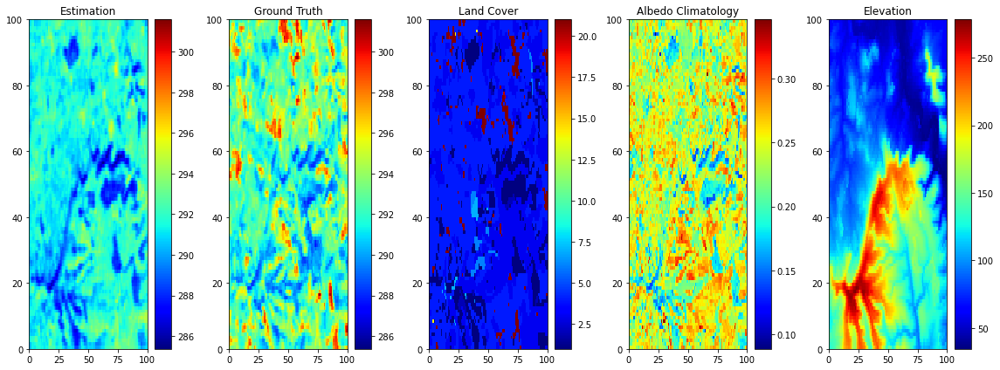

Date: 2021-04-25T10:58:10.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


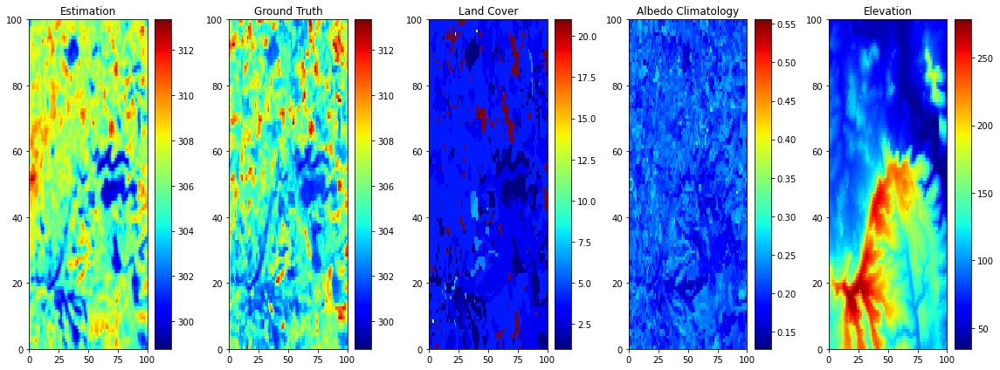

Date: 2021-07-21T11:04:43.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


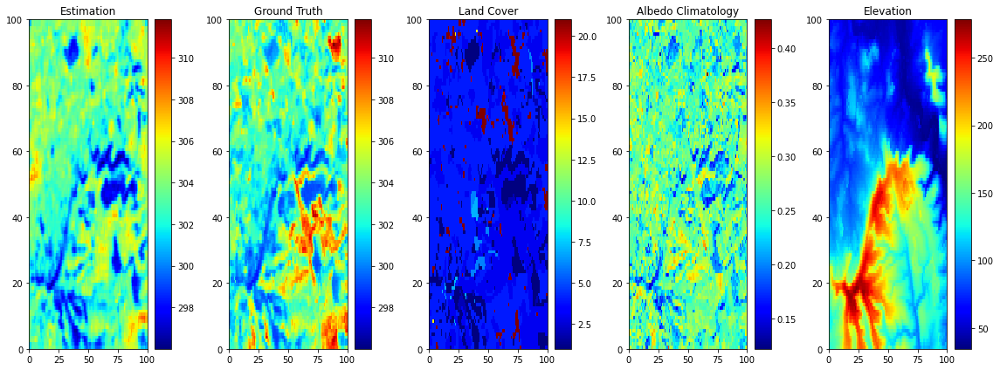

Date: 2021-09-07T11:05:00.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


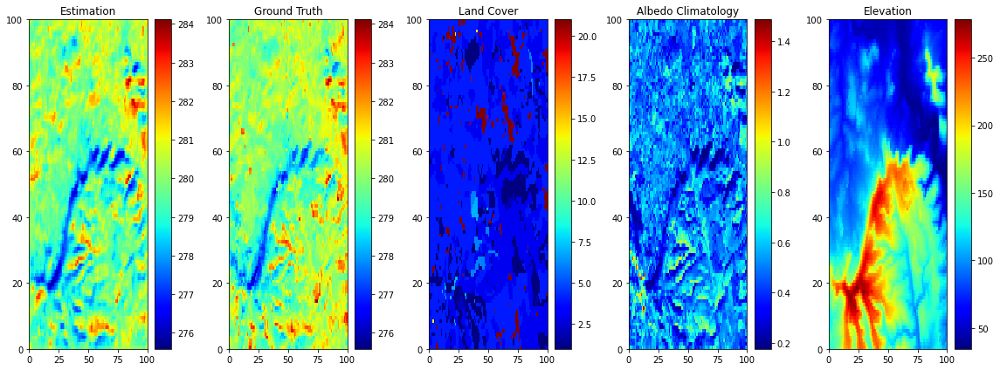

Date: 2021-11-22T11:05:14.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


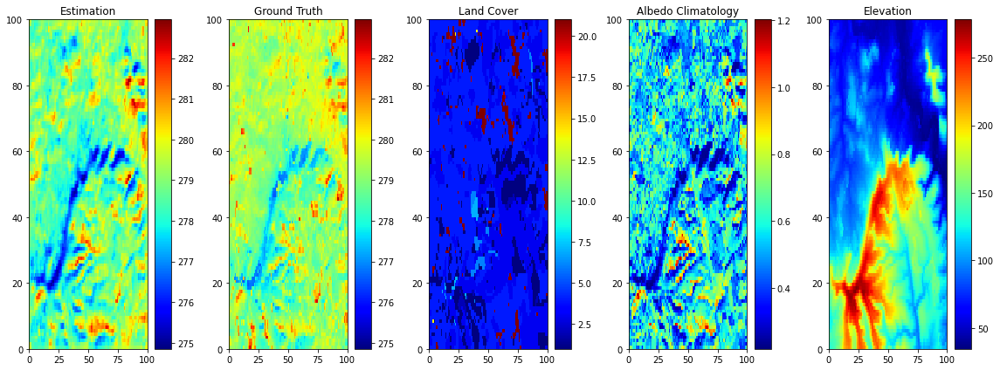

Date: 2021-12-04T11:05:09.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


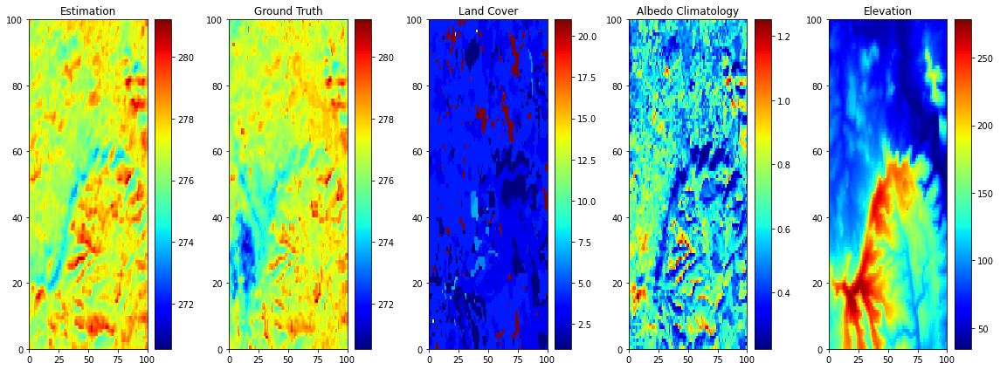

Date: 2022-01-05T11:05:01.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


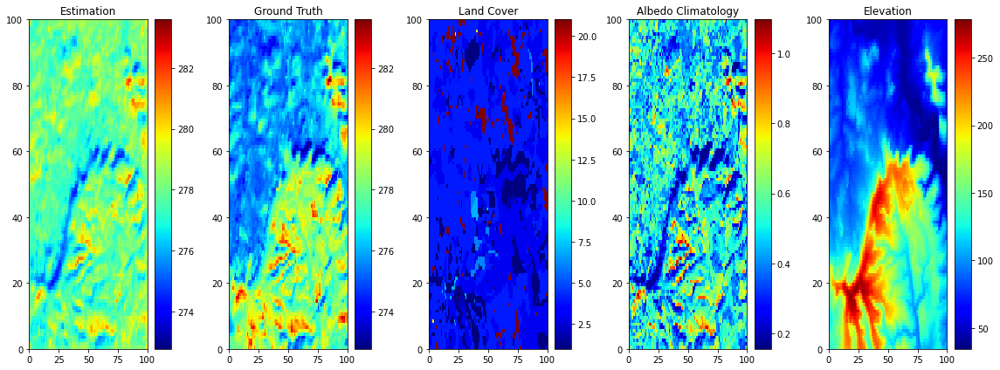

Date: 2022-01-14T10:58:48.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


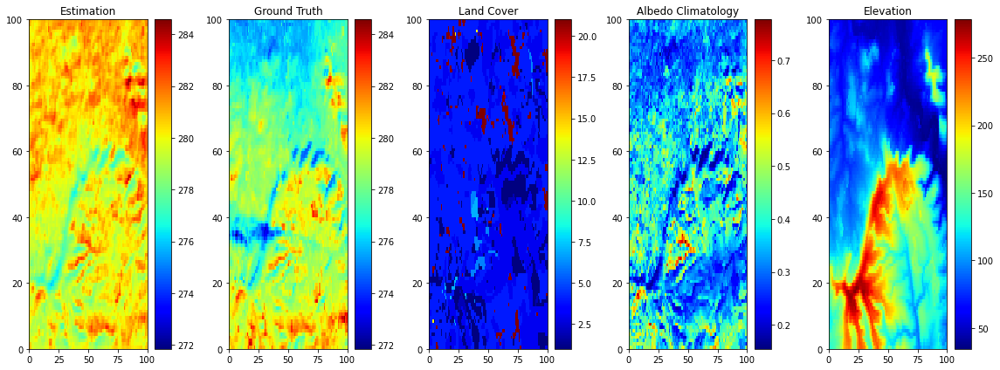

Date: 2022-01-30T10:58:51.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


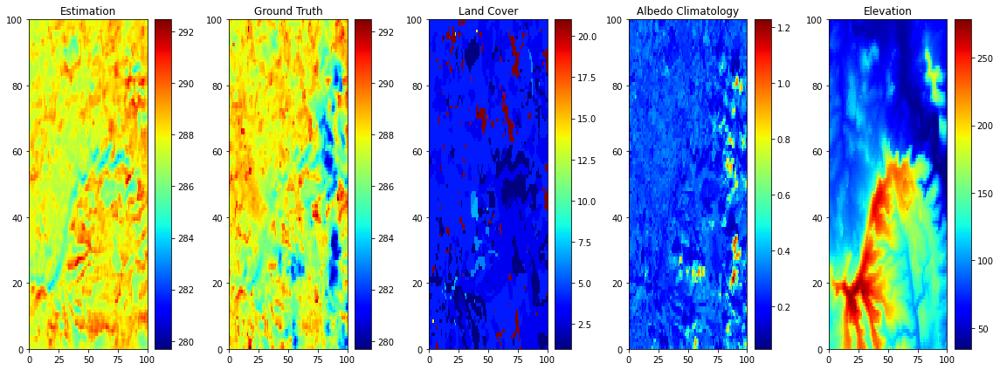

Date: 2022-03-18T11:04:39.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


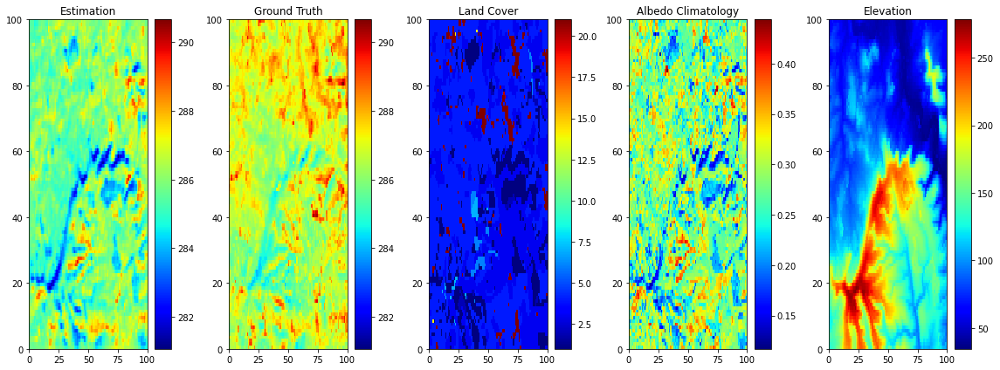

Date: 2022-03-19T10:58:34.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


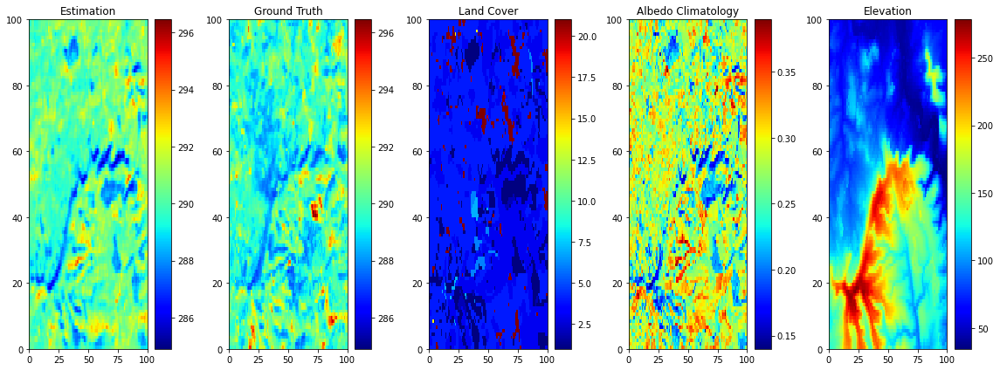

Date: 2022-03-26T11:04:42.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


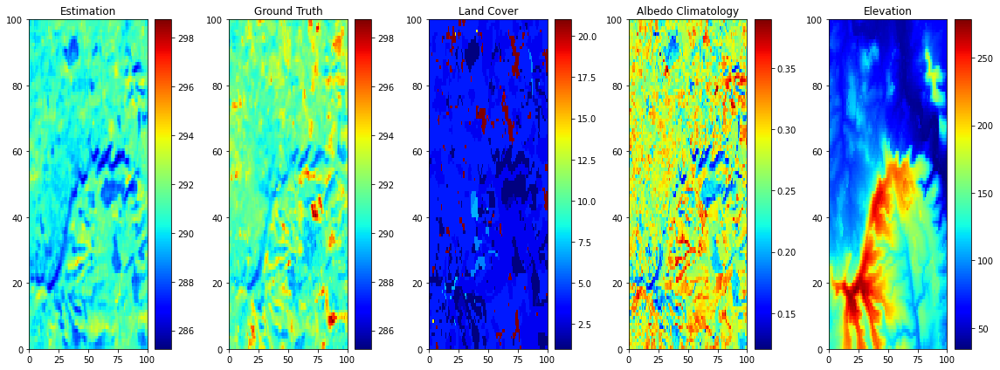

Date: 2022-03-27T10:58:21.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


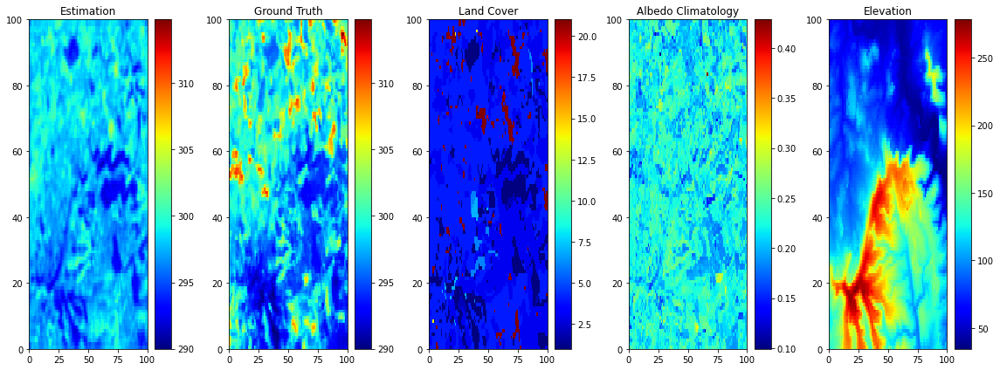

Date: 2022-05-22T10:58:05.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


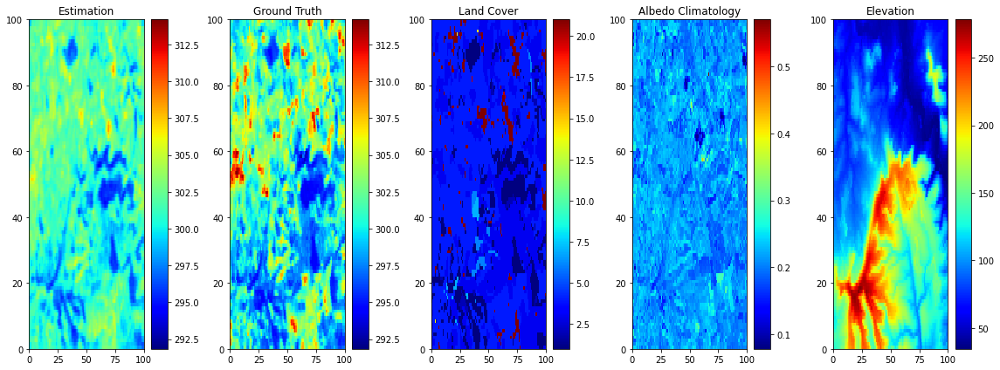

Date: 2022-06-14T11:04:21.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


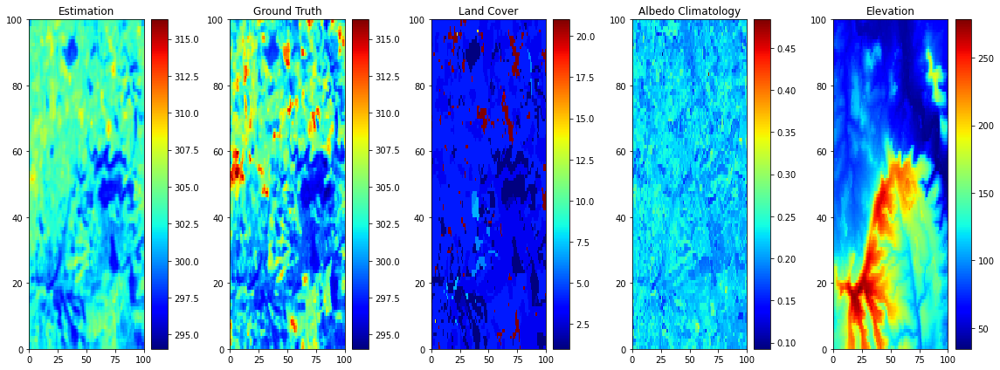

Date: 2022-06-15T10:58:45.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


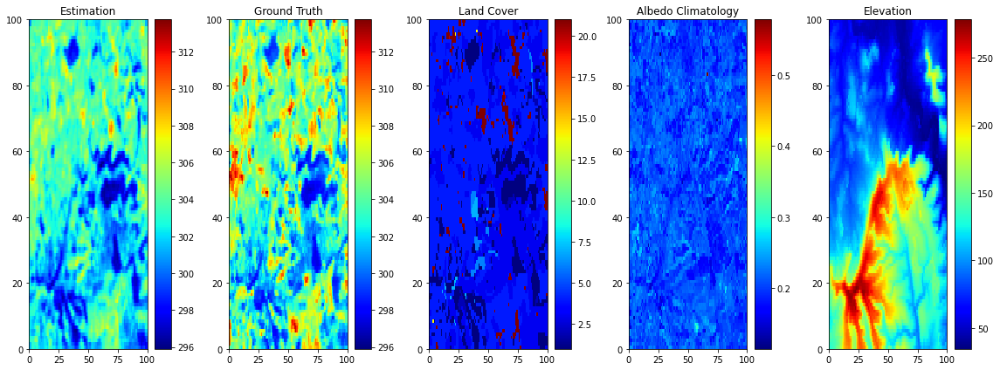

Date: 2022-06-22T11:04:58.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


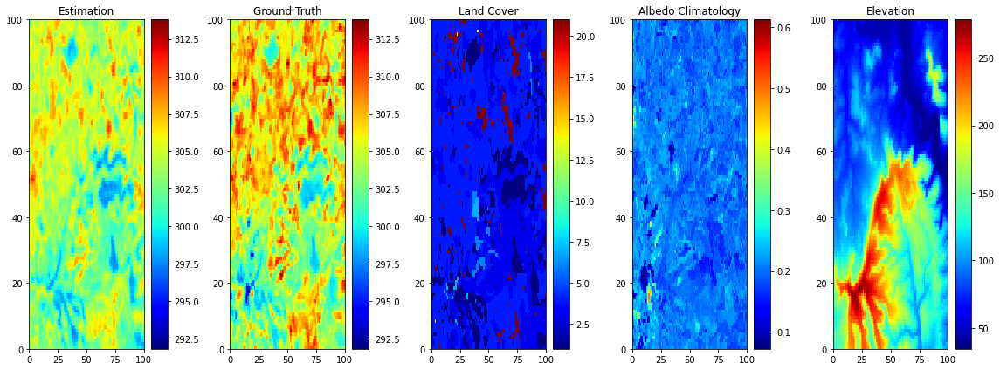

Date: 2022-07-08T11:04:59.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


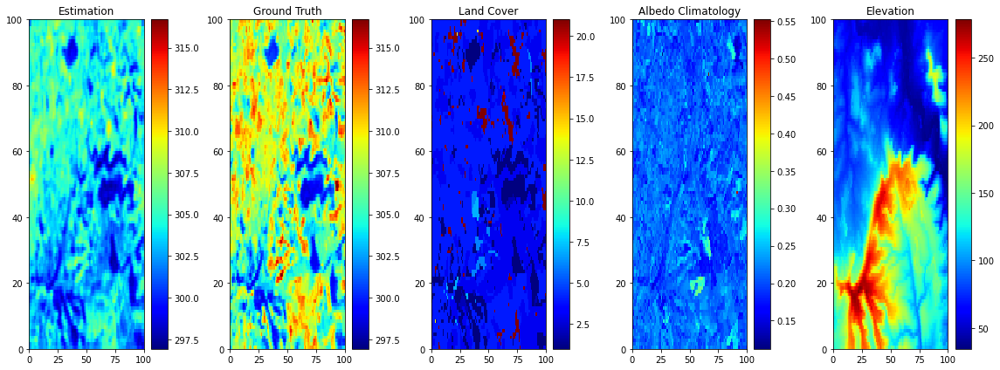

Date: 2022-07-16T11:04:34.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


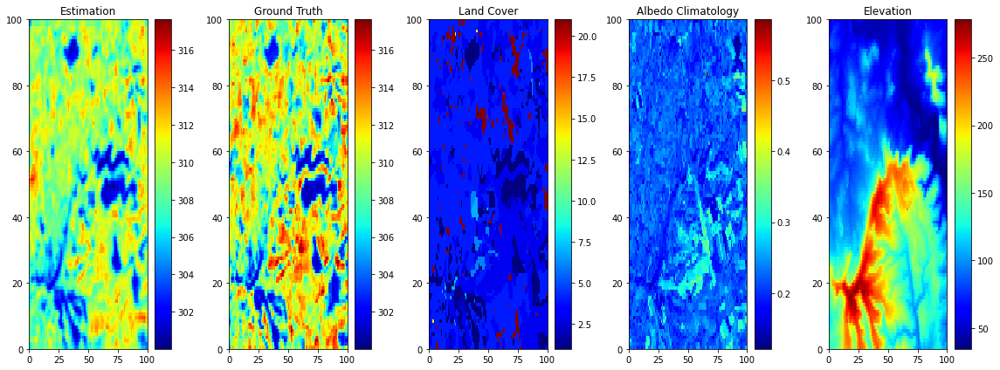

Date: 2022-08-09T11:05:14.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


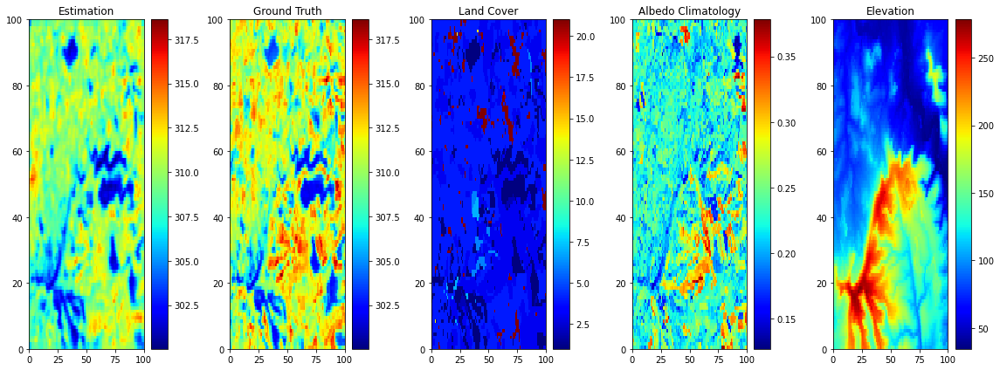

Date: 2022-08-10T10:58:44.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


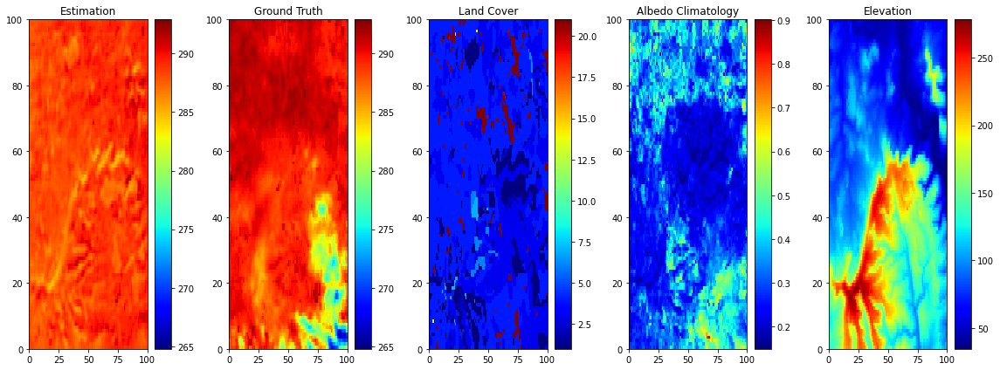

Date: 2022-10-29T10:59:24.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


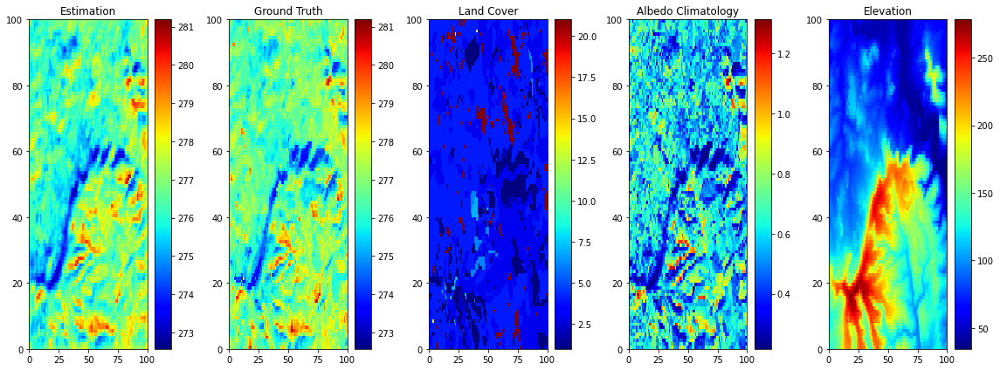

Date: 2022-12-07T11:05:11.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


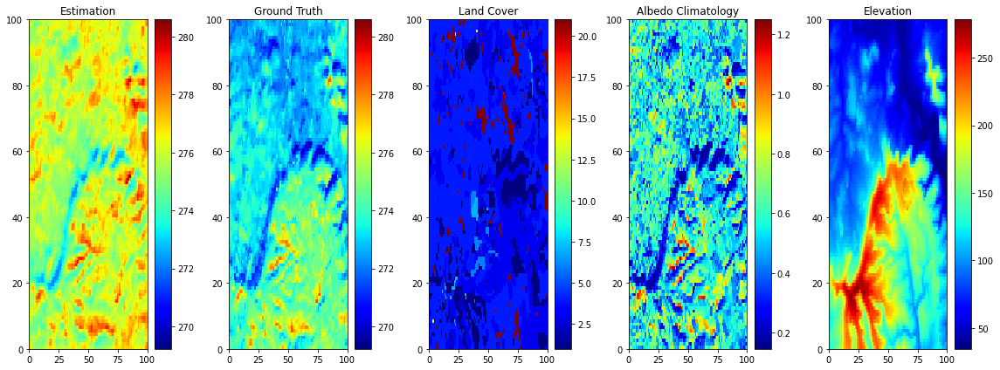

Date: 2022-12-08T10:59:07.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


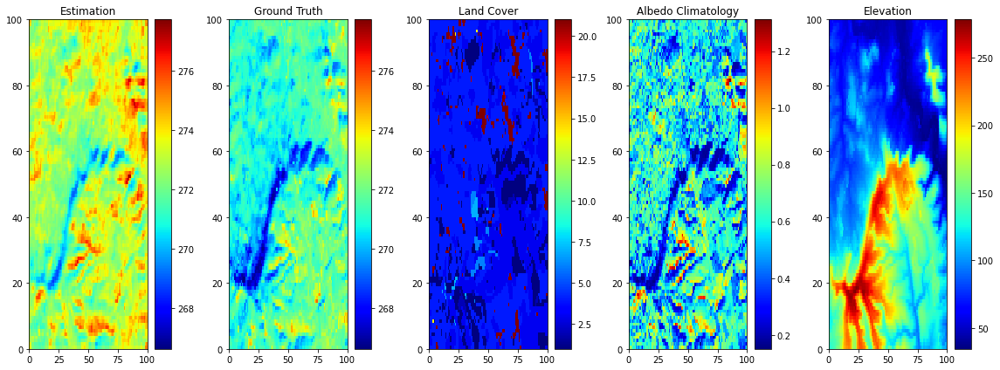

Date: 2022-12-15T11:05:38.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


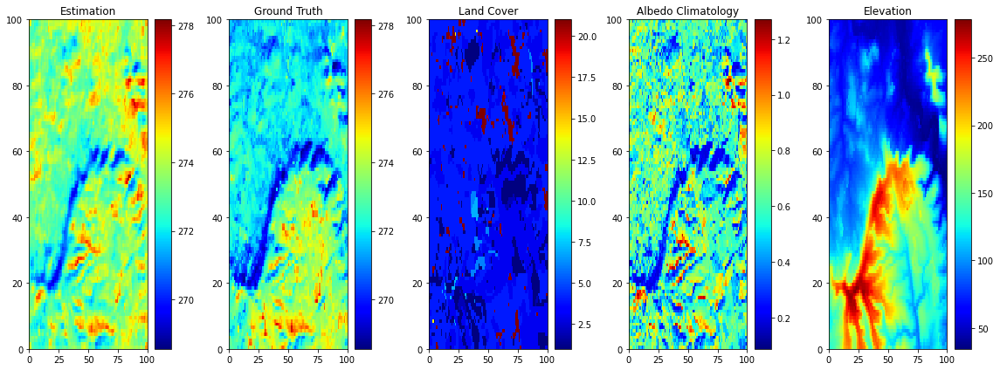

Date: 2022-12-16T10:59:25.000000000
GPS Location (lat, lon): (50.880628, -2.270732)
Easting, Northing: (381050, 109050)


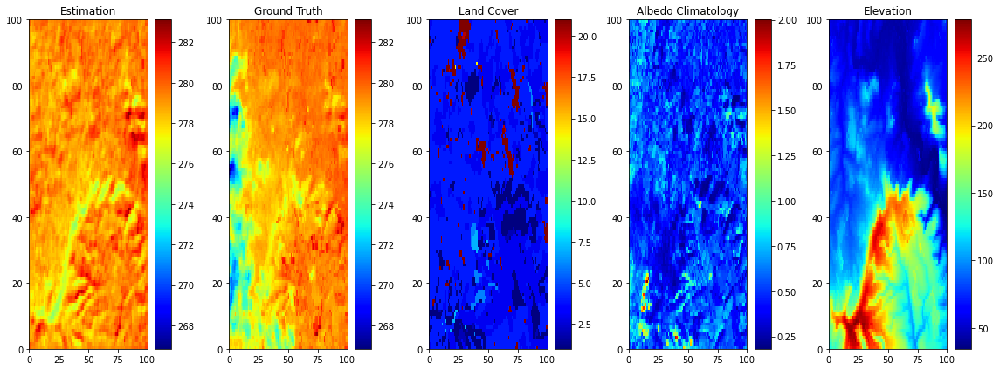

Date: 2020-01-17T10:58:44.000000000
GPS Location (lat, lon): (50.889620, -2.270784)
Easting, Northing: (381050, 110050)


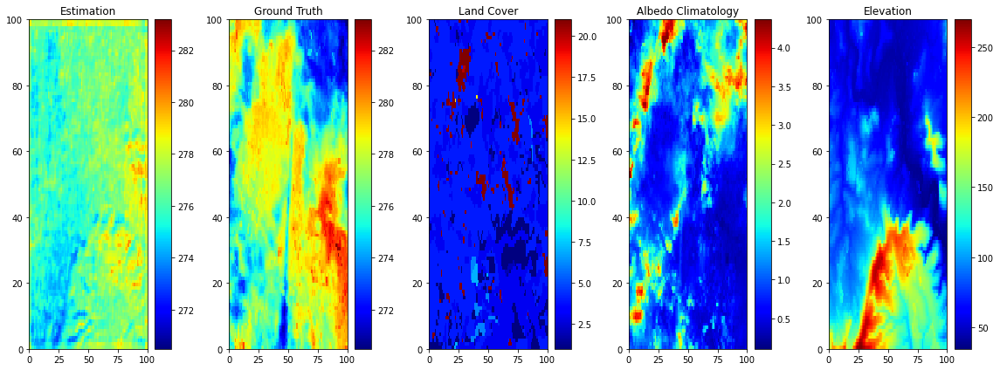

Date: 2015-01-03T10:59:00.000000000
GPS Location (lat, lon): (50.898613, -2.270836)
Easting, Northing: (381050, 111050)


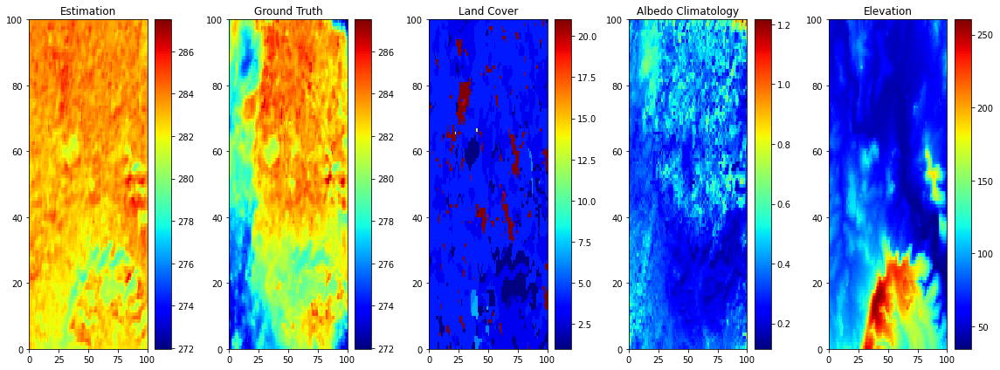

Date: 2021-11-03T10:58:59.000000000
GPS Location (lat, lon): (50.907605, -2.270888)
Easting, Northing: (381050, 112050)


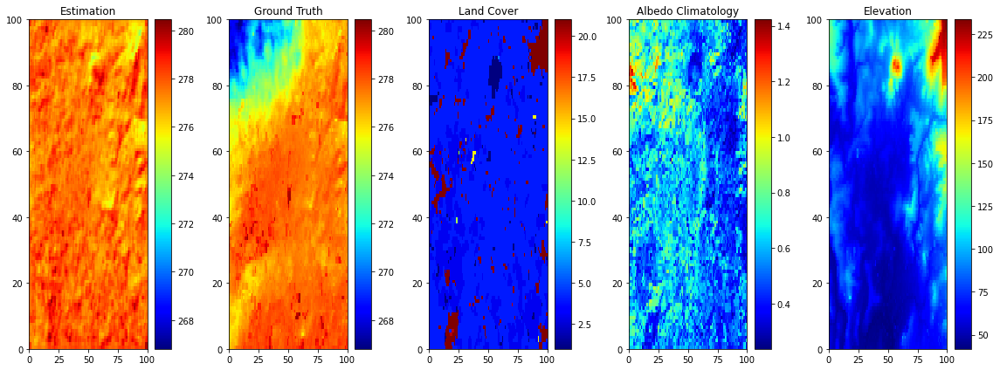

Date: 2017-12-26T10:59:09.000000000
GPS Location (lat, lon): (50.970583, -2.257013)
Easting, Northing: (382050, 119050)


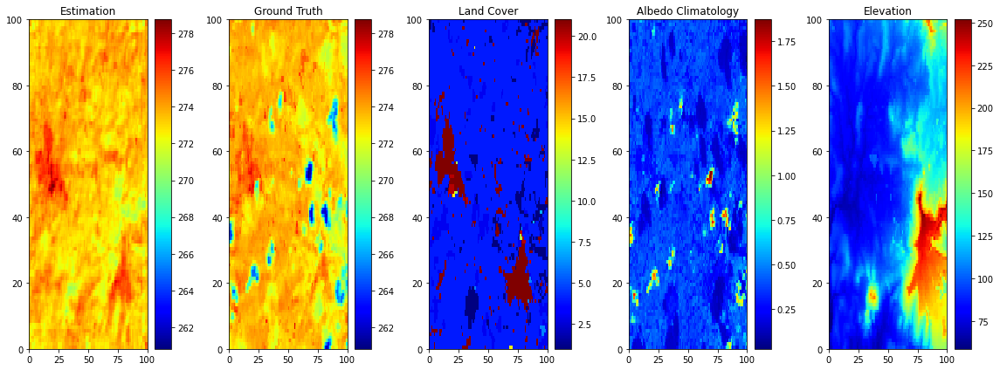

Date: 2018-02-28T10:58:17.000000000
GPS Location (lat, lon): (51.033587, -2.228839)
Easting, Northing: (384050, 126050)


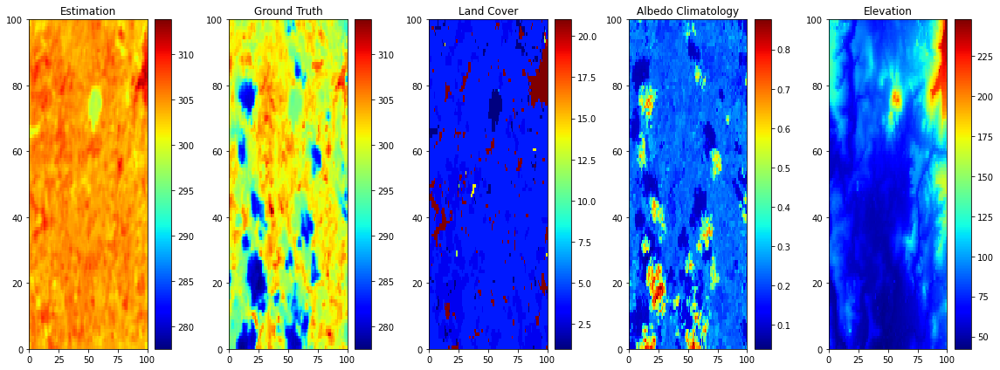

Date: 2014-07-02T11:04:32.000000000
GPS Location (lat, lon): (50.979575, -2.257063)
Easting, Northing: (382050, 120050)


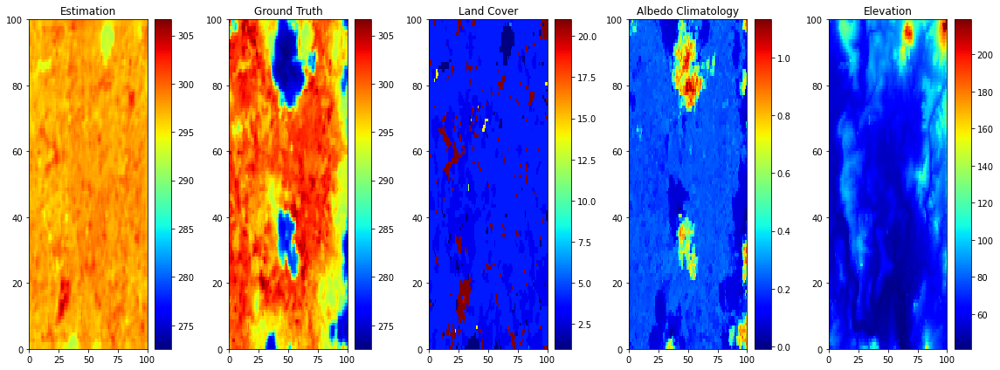

Date: 2020-08-03T11:04:42.000000000
GPS Location (lat, lon): (50.961558, -2.271202)
Easting, Northing: (381050, 118050)


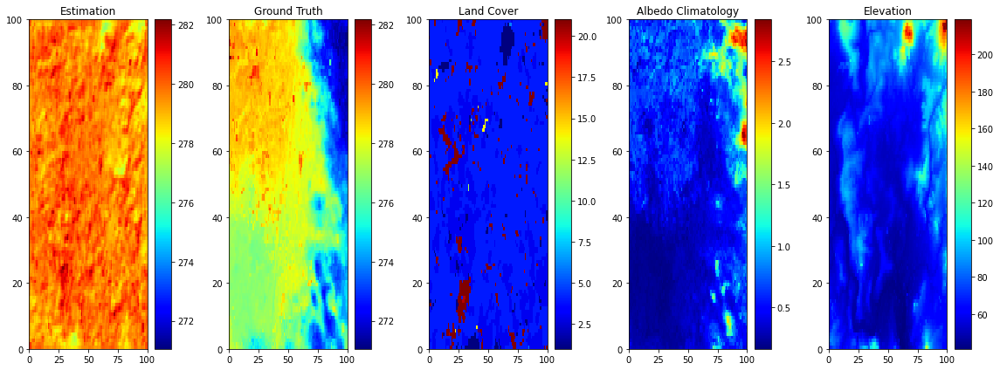

Date: 2021-12-05T10:58:56.000000000
GPS Location (lat, lon): (50.961558, -2.271202)
Easting, Northing: (381050, 118050)


In [6]:
try:
    location_name = "New Forest"  # Replace with the desired location name
    lon, lat = get_coordinates(location_name, all_locations)
    print(f"Coordinates for {location_name}: lon={lon}, lat={lat}")

    # Assuming ds_test_toy is defined as your xarray dataset
    all_closest_scenes = find_all_closest_scenes(ds_test_toy, lon, lat, max_distance=50000)

    # Print all the closest scenes
    for box_index, distance in all_closest_scenes:
        print(f"Scene (Box): {box_index}, Distance: {distance:.2f} meters")

except ValueError as e:
    print(e)
    
for box_index, distance in all_closest_scenes:
    estimation = ds_test_toy.hires_estimate[box_index, 0, :, :].values
    ground_truth = ds_test_toy.ST_slices[box_index, 0, :, :].values

    vmin = min(estimation.min(), ground_truth.min())
    vmax = max(estimation.max(), ground_truth.max())

    plt.figure(figsize=(16, 6))  # Set a larger figure size

    # estimated high resolution
    plt.subplot(1, 5, 1)  # 1 row, 5 columns, 1st subplot
    plt.pcolormesh(estimation, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Estimation")

    # actual high resolution (ground truth)
    plt.subplot(1, 5, 2)  # 1 row, 5 columns, 2nd subplot
    plt.pcolormesh(ground_truth, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Ground Truth")

    # the land cover
    plt.subplot(1, 5, 3)  # 1 row, 5 columns, 3rd subplot
    plt.pcolormesh(ds_test_toy.land_cover[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Land Cover")   

    # the albedo
    plt.subplot(1, 5, 4)  # 1 row, 5 columns, 4th subplot
    plt.pcolormesh(ds_test_toy.albedo[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Albedo Climatology")     

    # the elevation
    plt.subplot(1, 5, 5)  # 1 row, 5 columns, 5th subplot
    plt.pcolormesh(ds_test_toy.elevation[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Elevation")        

    plt.tight_layout()
    plt.show()

    eastings = ds_test_toy.x_eastings[box_index, :].values
    northings = ds_test_toy.y_northings[box_index, :].values
    middle_easting = eastings[len(eastings) // 2]
    middle_northing = northings[len(northings) // 2]

    # Convert middle point back to GPS coordinates
    lon, lat = transformer_to_gps.transform(middle_easting, middle_northing)

    # Print additional information
    print(f"Date: {ds_test_toy.box_time[box_index].values}")
    print(f"GPS Location (lat, lon): ({lat:.6f}, {lon:.6f})")
    print(f"Easting, Northing: ({middle_easting}, {middle_northing})")    
    

Coordinates for Lake District (Scafell Pike): lon=-3.2115, lat=54.4549
Scene (Box): 2715, Distance: 16556.58 meters
Scene (Box): 2720, Distance: 16556.58 meters
Scene (Box): 2724, Distance: 16556.58 meters
Scene (Box): 2727, Distance: 16556.58 meters
Scene (Box): 2730, Distance: 16556.58 meters
Scene (Box): 2733, Distance: 16556.58 meters
Scene (Box): 2736, Distance: 16556.58 meters
Scene (Box): 2739, Distance: 16556.58 meters
Scene (Box): 2742, Distance: 16556.58 meters
Scene (Box): 2745, Distance: 16556.58 meters
Scene (Box): 2746, Distance: 16556.58 meters
Scene (Box): 2749, Distance: 16556.58 meters
Scene (Box): 2752, Distance: 16556.58 meters
Scene (Box): 2754, Distance: 16556.58 meters
Scene (Box): 2757, Distance: 16556.58 meters
Scene (Box): 2761, Distance: 16556.58 meters
Scene (Box): 2713, Distance: 17032.78 meters
Scene (Box): 2721, Distance: 17454.05 meters
Scene (Box): 2744, Distance: 17553.08 meters
Scene (Box): 2716, Distance: 18362.11 meters
Scene (Box): 2753, Distance: 

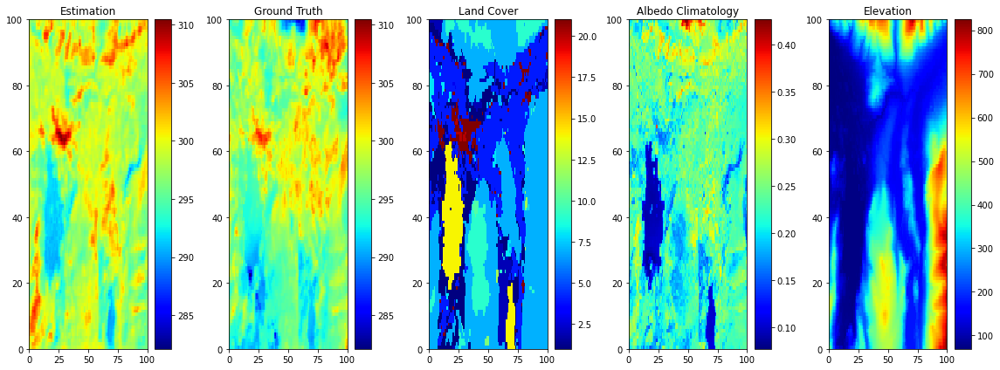

Date: 2013-07-22T11:12:05.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


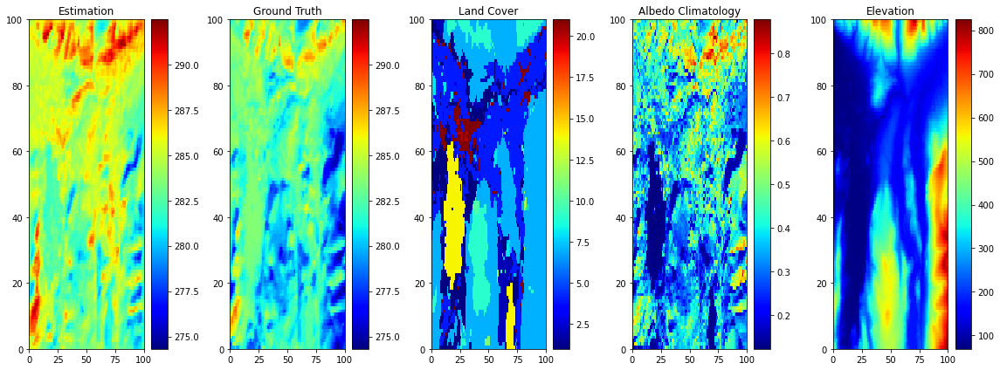

Date: 2014-10-29T11:10:18.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


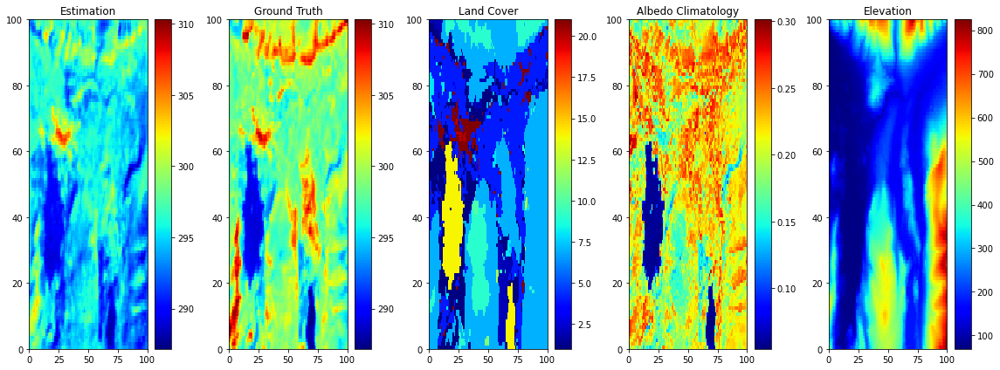

Date: 2015-06-10T11:09:23.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


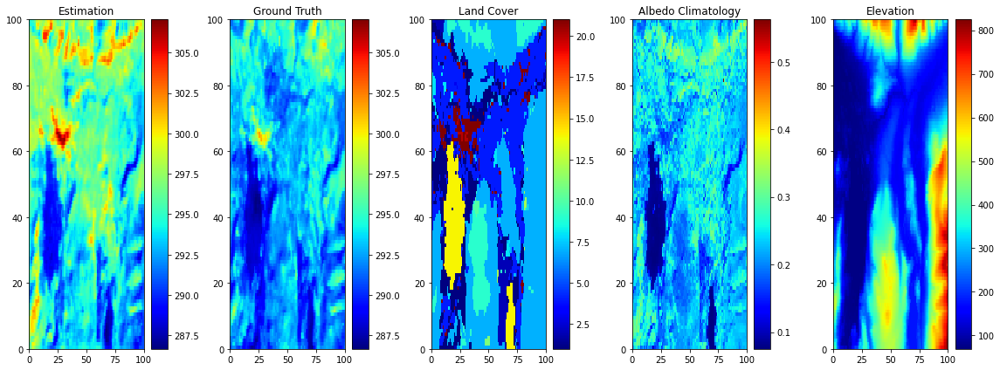

Date: 2015-08-13T11:09:50.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


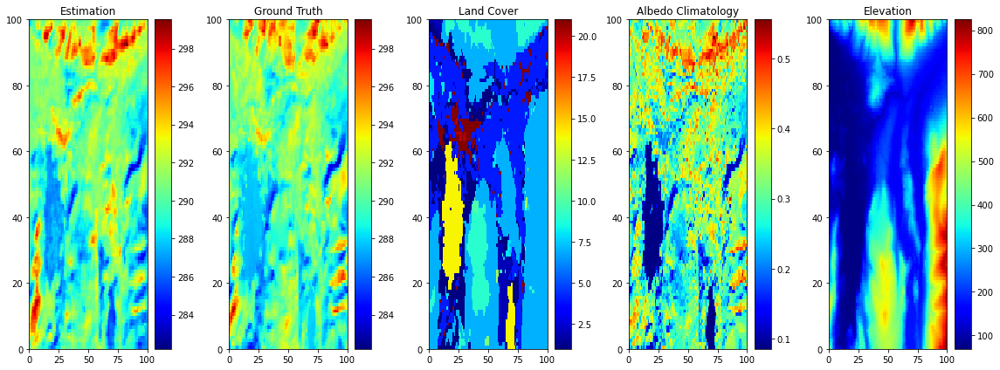

Date: 2015-09-30T11:10:09.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


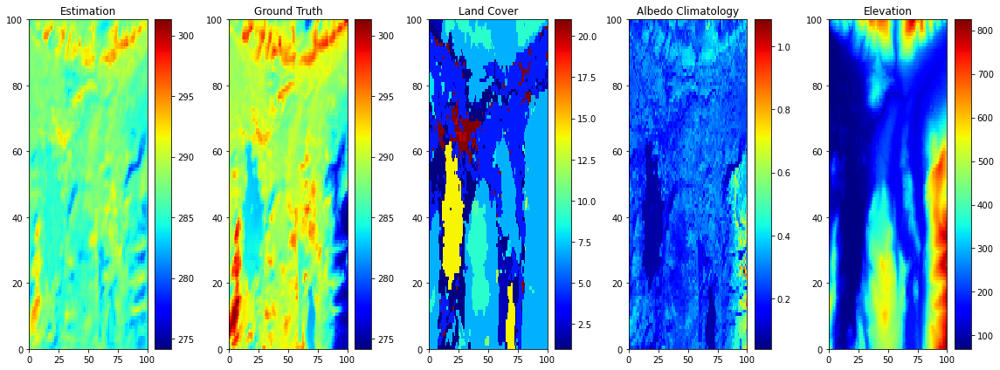

Date: 2017-03-27T11:09:44.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


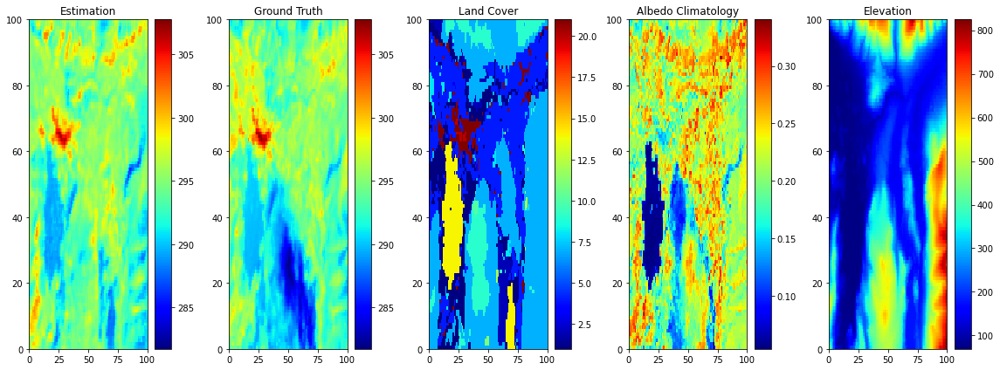

Date: 2017-07-01T11:09:55.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


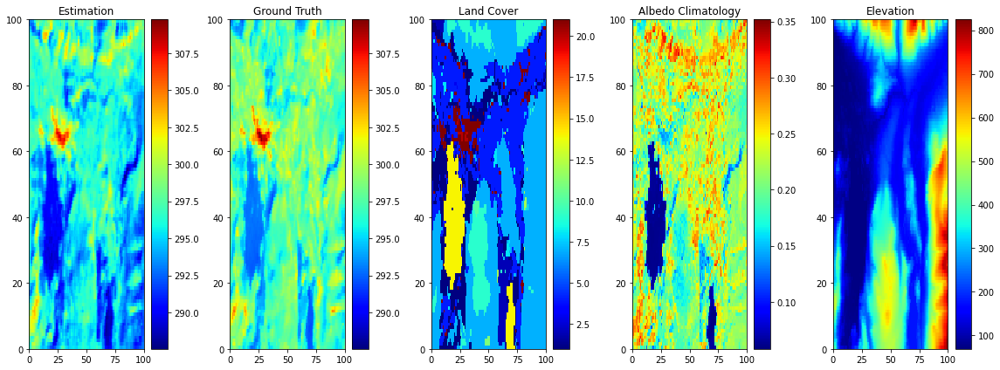

Date: 2017-07-17T11:09:59.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


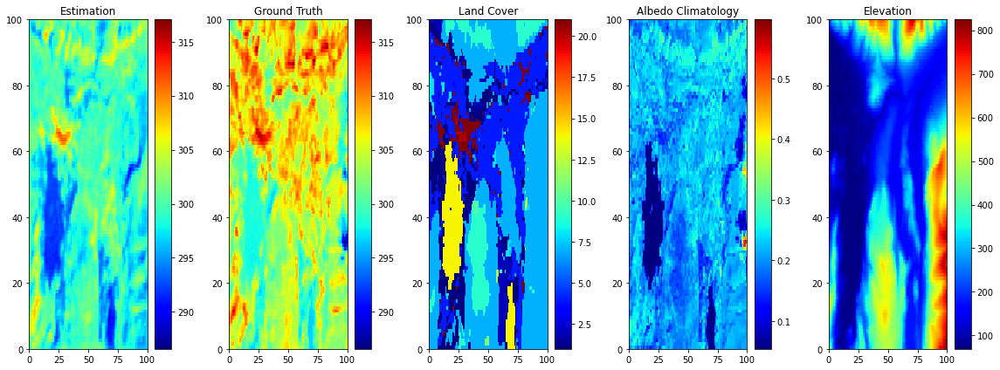

Date: 2018-07-04T11:09:13.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


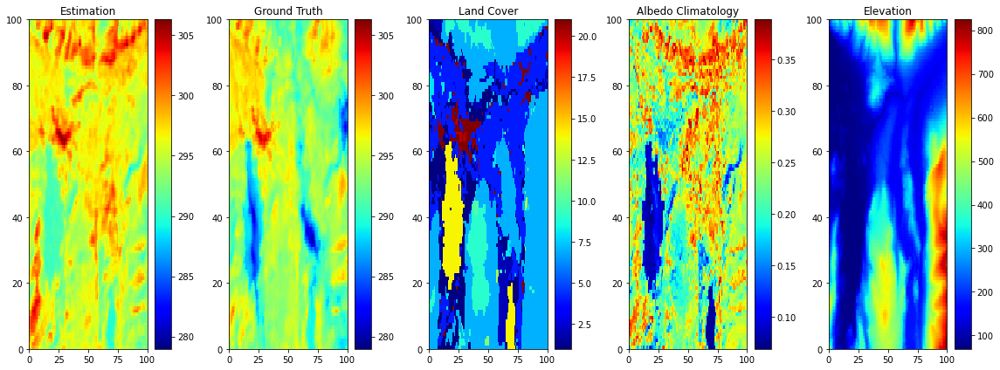

Date: 2019-08-24T11:10:18.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


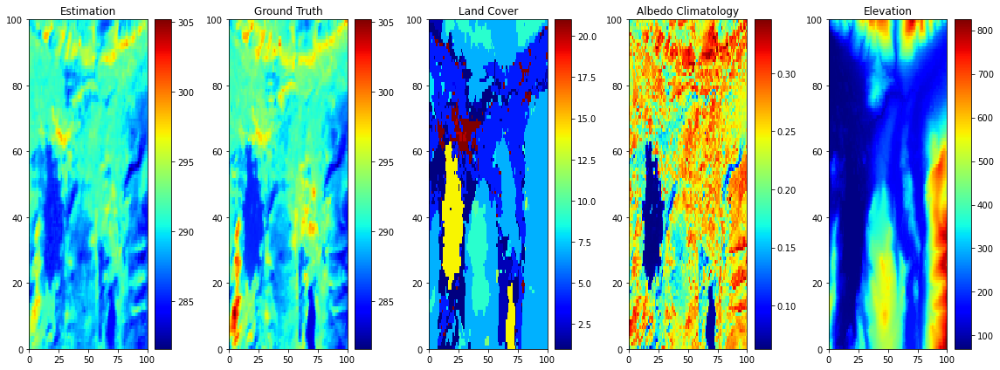

Date: 2020-04-20T11:09:42.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


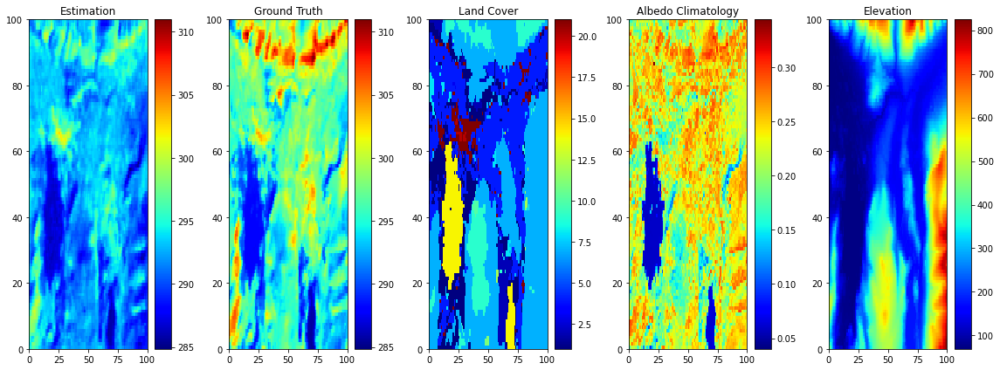

Date: 2020-05-06T11:09:33.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


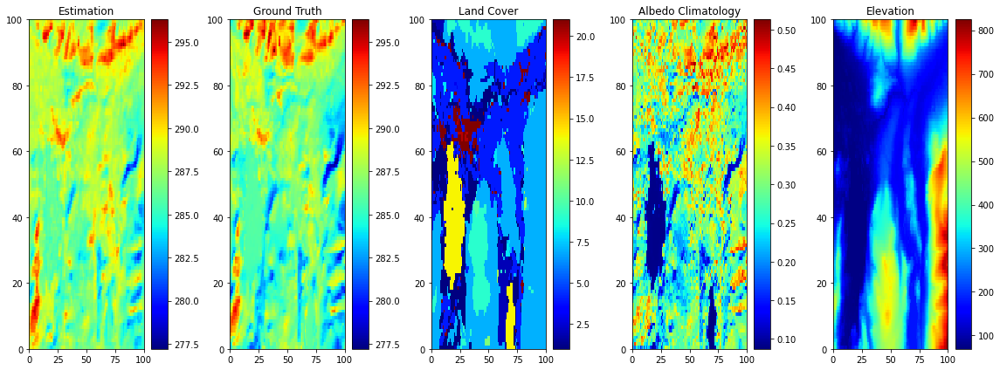

Date: 2020-09-27T11:10:26.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


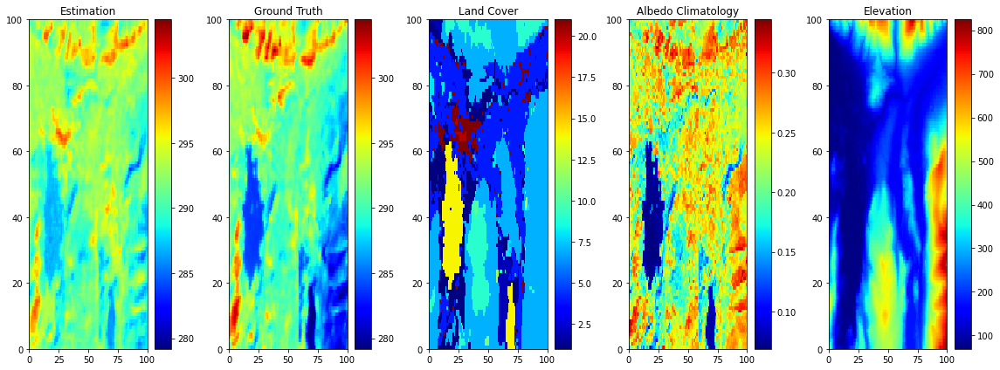

Date: 2021-04-23T11:09:45.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


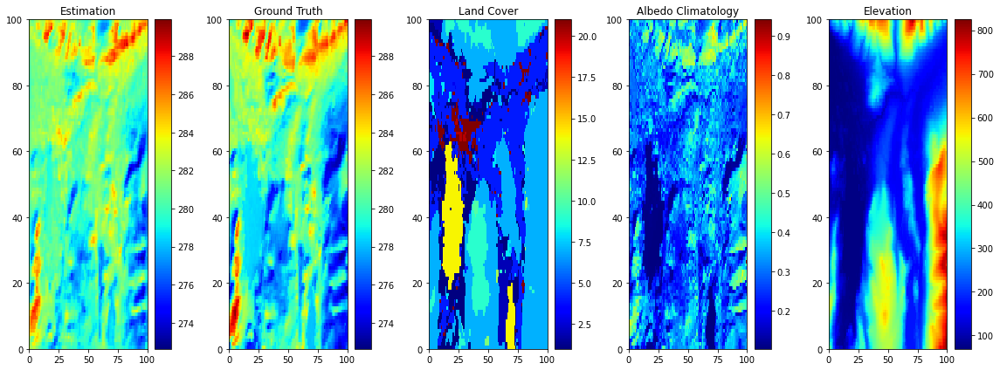

Date: 2022-03-01T11:10:09.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


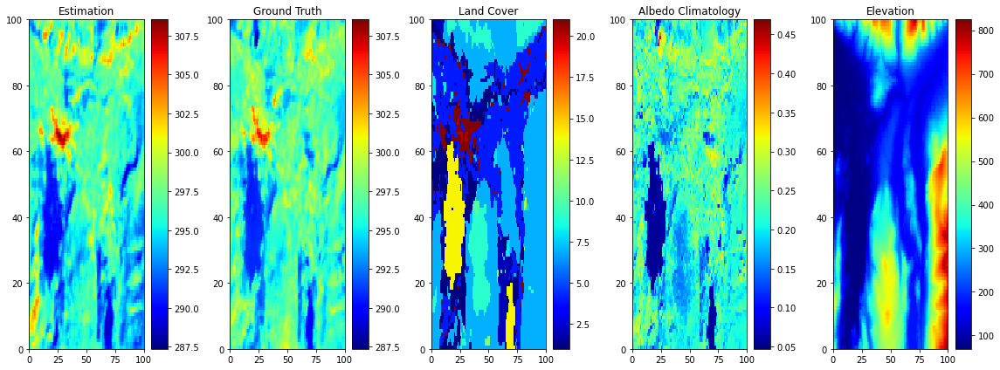

Date: 2022-07-07T11:09:59.000000000
GPS Location (lat, lon): (54.588641, -3.099439)
Easting, Northing: (329050, 522050)


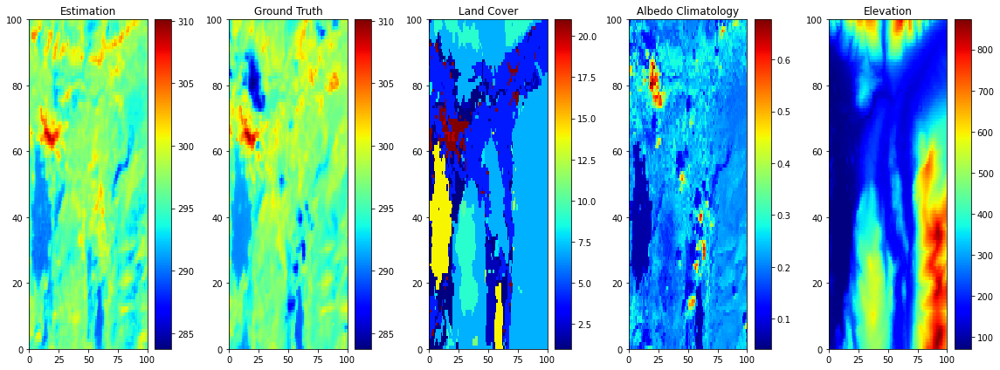

Date: 2013-07-06T11:12:07.000000000
GPS Location (lat, lon): (54.588781, -3.083968)
Easting, Northing: (330050, 522050)


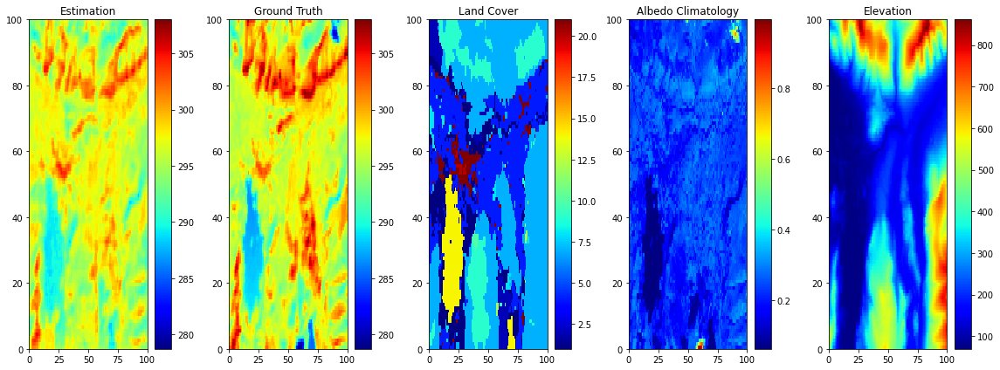

Date: 2015-04-23T11:09:29.000000000
GPS Location (lat, lon): (54.597626, -3.099681)
Easting, Northing: (329050, 523050)


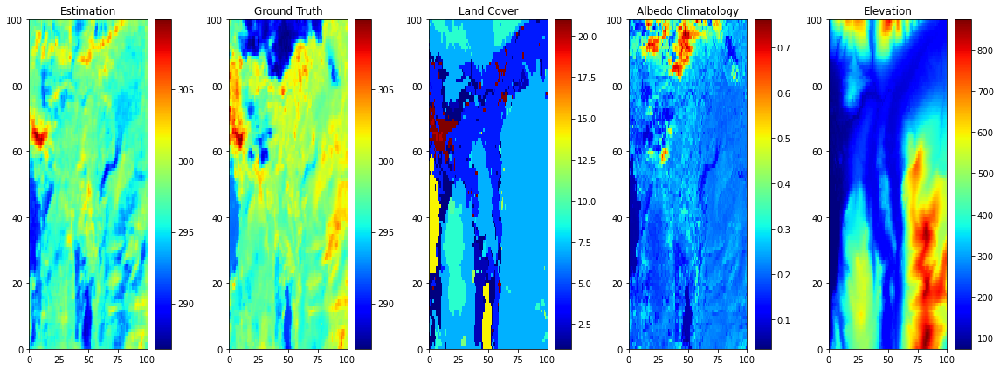

Date: 2019-07-23T11:10:07.000000000
GPS Location (lat, lon): (54.588918, -3.068496)
Easting, Northing: (331050, 522050)


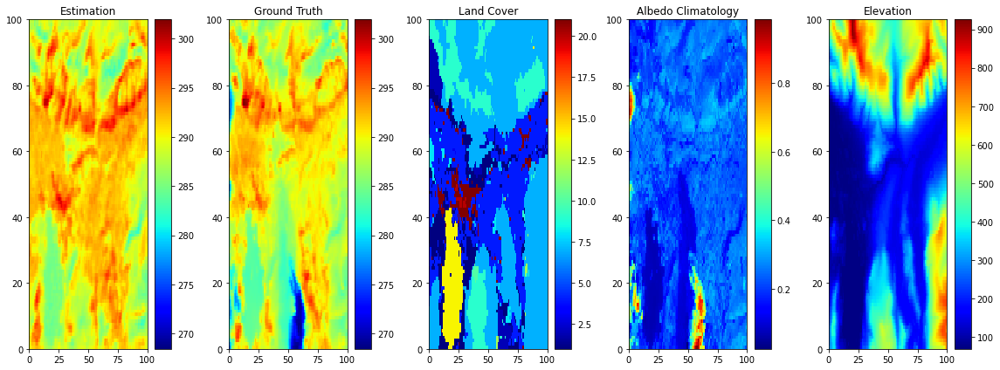

Date: 2014-04-20T11:10:02.000000000
GPS Location (lat, lon): (54.606611, -3.099924)
Easting, Northing: (329050, 524050)


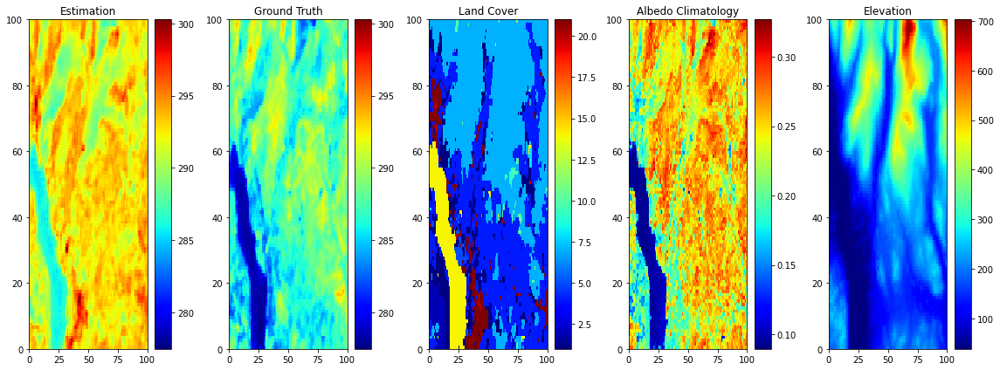

Date: 2021-04-23T11:09:45.000000000
GPS Location (lat, lon): (54.410585, -2.894366)
Easting, Northing: (342050, 502050)


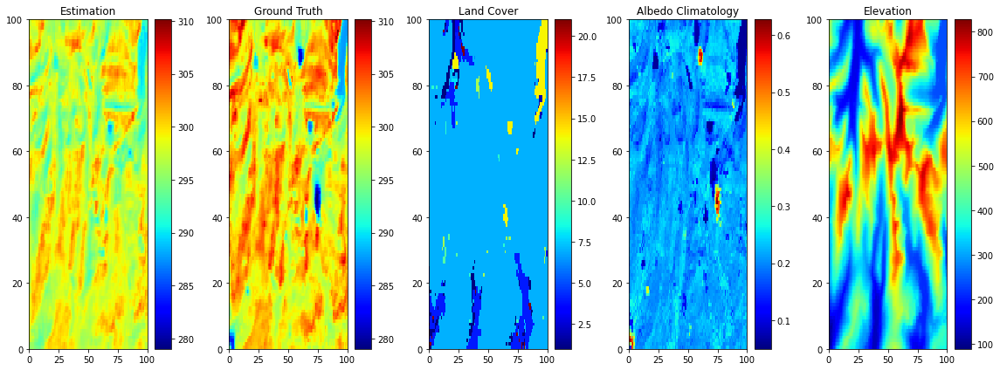

Date: 2015-06-10T11:09:23.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


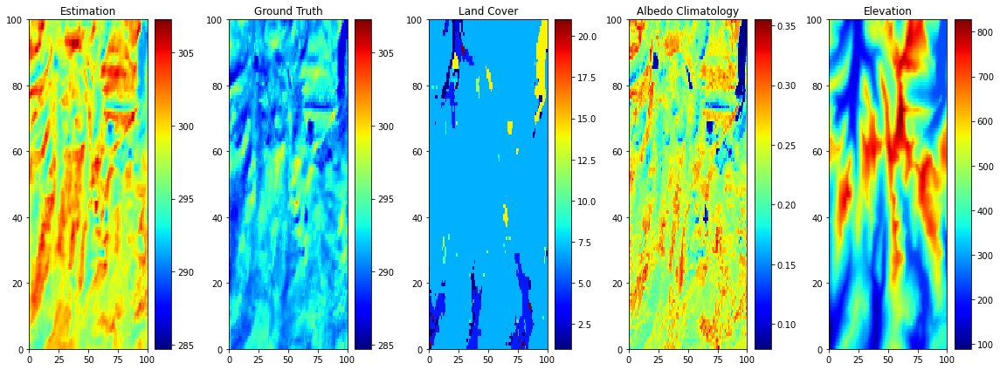

Date: 2015-08-13T11:09:50.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


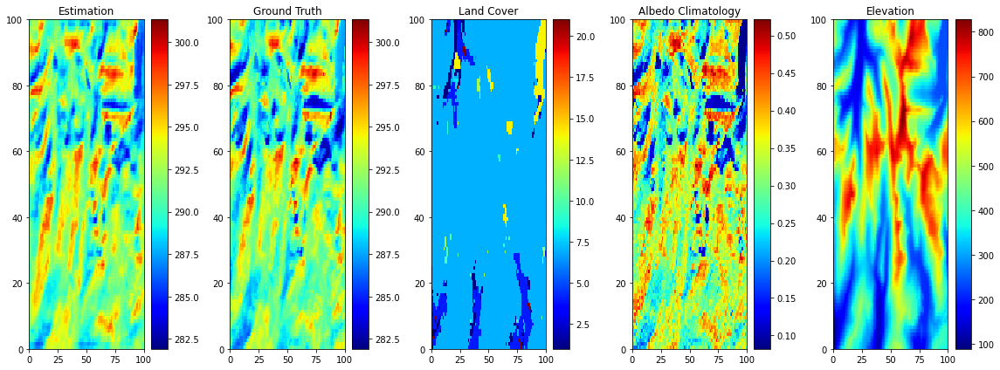

Date: 2015-09-30T11:10:09.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


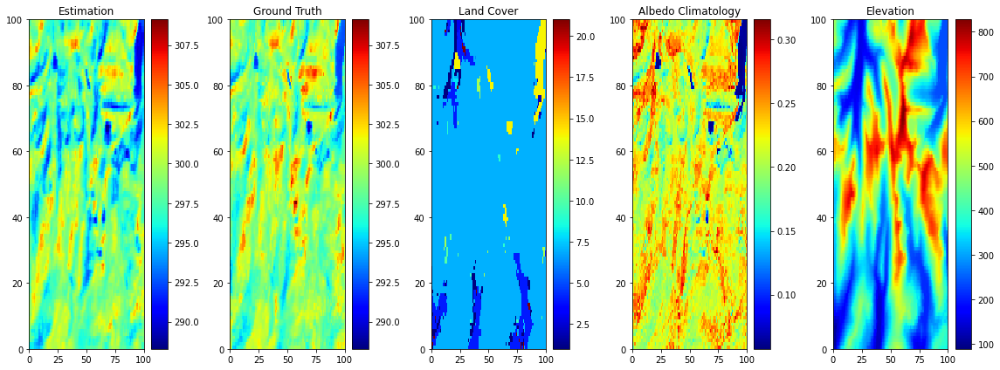

Date: 2017-07-17T11:09:59.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


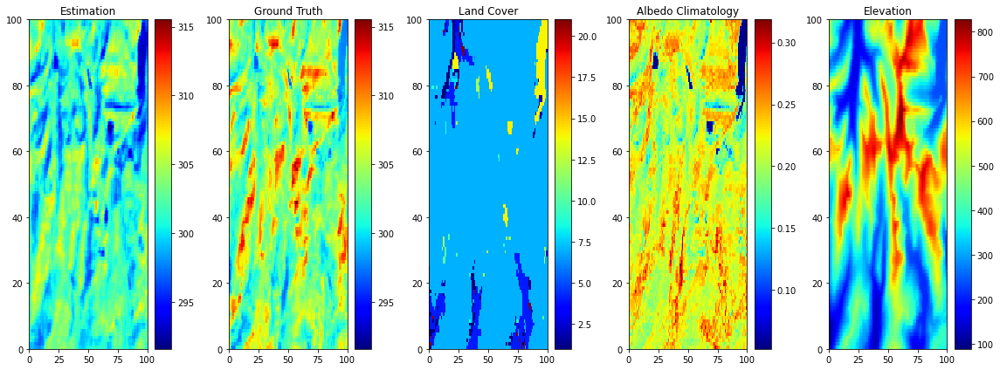

Date: 2018-07-04T11:09:13.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


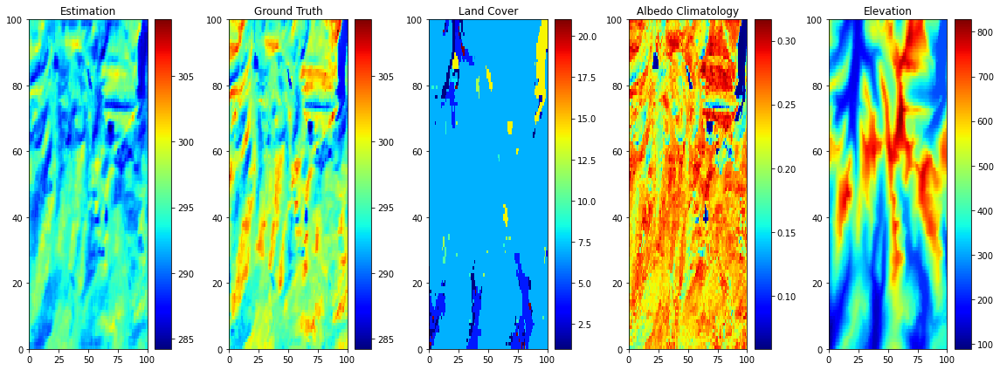

Date: 2020-05-06T11:09:33.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


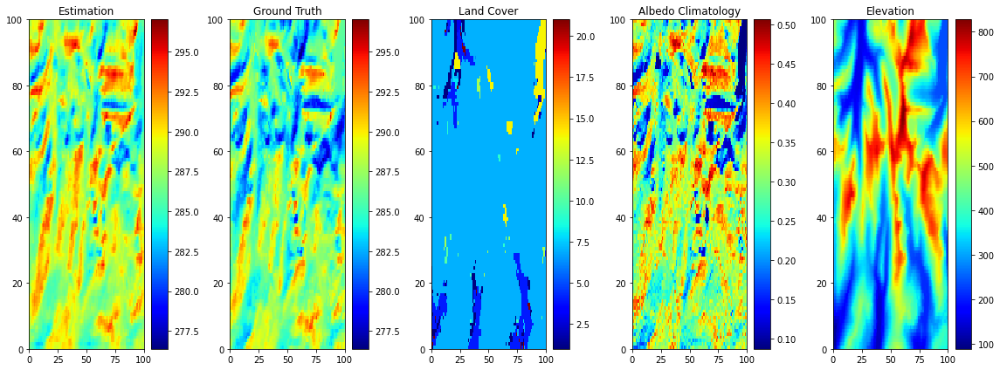

Date: 2020-09-27T11:10:26.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


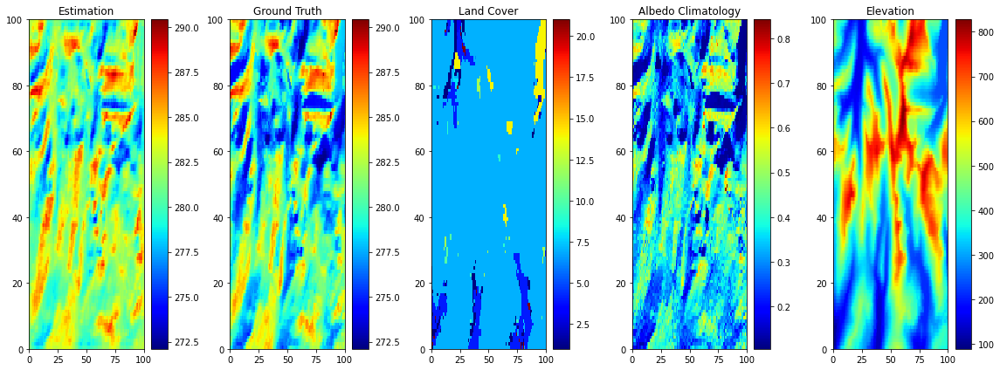

Date: 2022-03-01T11:10:09.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


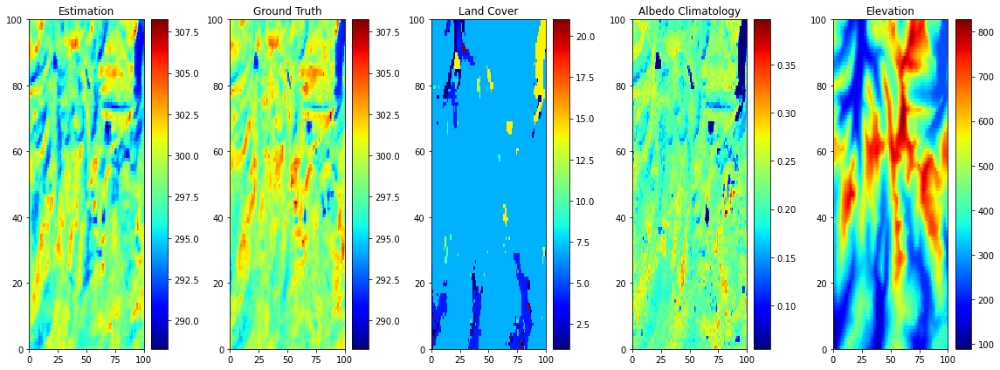

Date: 2022-07-07T11:09:59.000000000
GPS Location (lat, lon): (54.473600, -2.880309)
Easting, Northing: (343050, 509050)


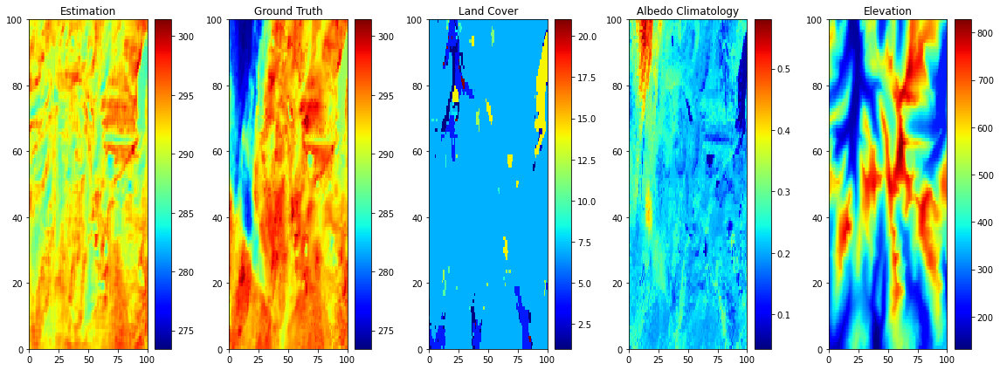

Date: 2017-07-01T11:09:55.000000000
GPS Location (lat, lon): (54.482586, -2.880502)
Easting, Northing: (343050, 510050)


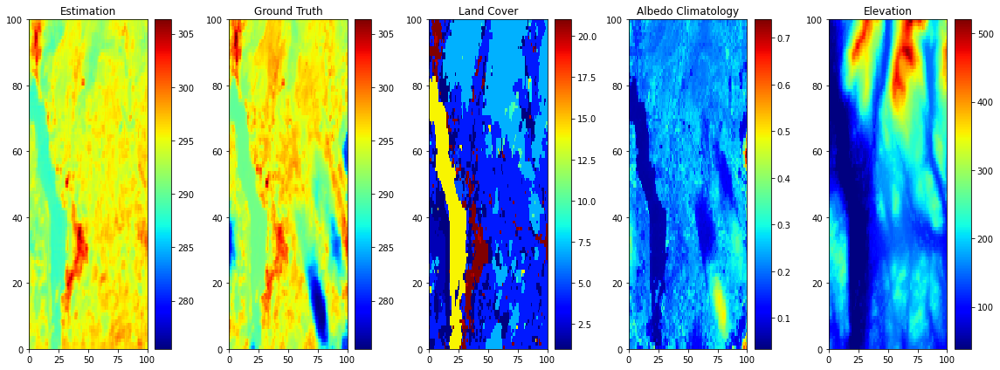

Date: 2017-07-01T11:09:55.000000000
GPS Location (lat, lon): (54.392613, -2.893975)
Easting, Northing: (342050, 500050)


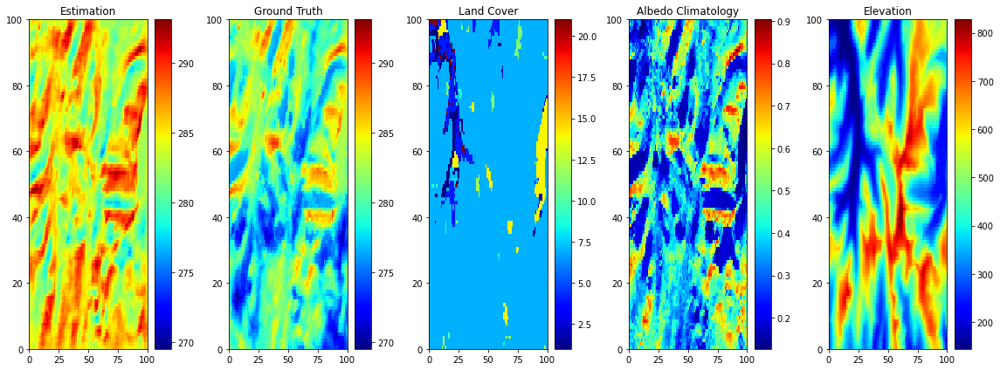

Date: 2014-10-29T11:10:18.000000000
GPS Location (lat, lon): (54.500557, -2.880888)
Easting, Northing: (343050, 512050)


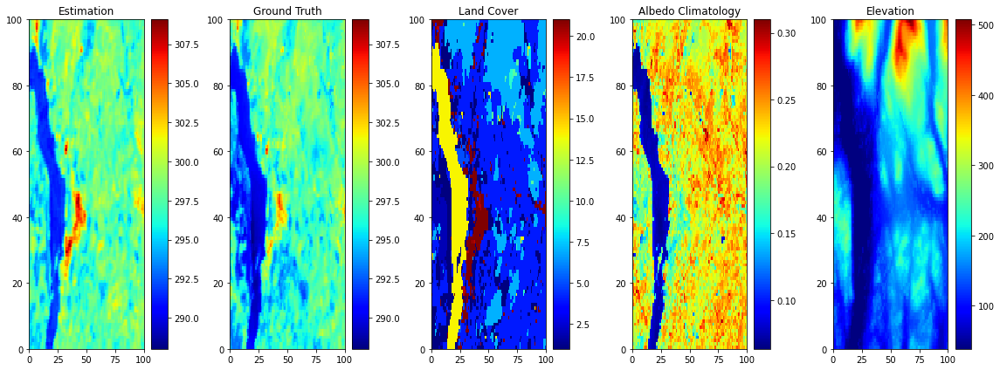

Date: 2013-07-06T11:12:07.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


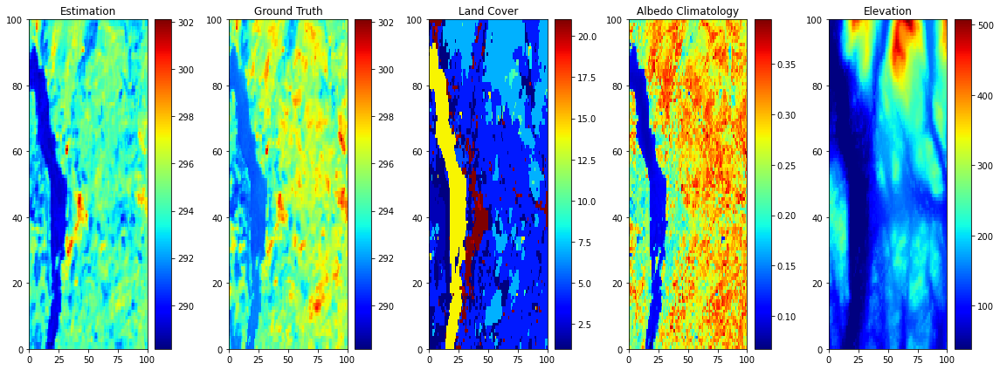

Date: 2014-09-11T11:10:17.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


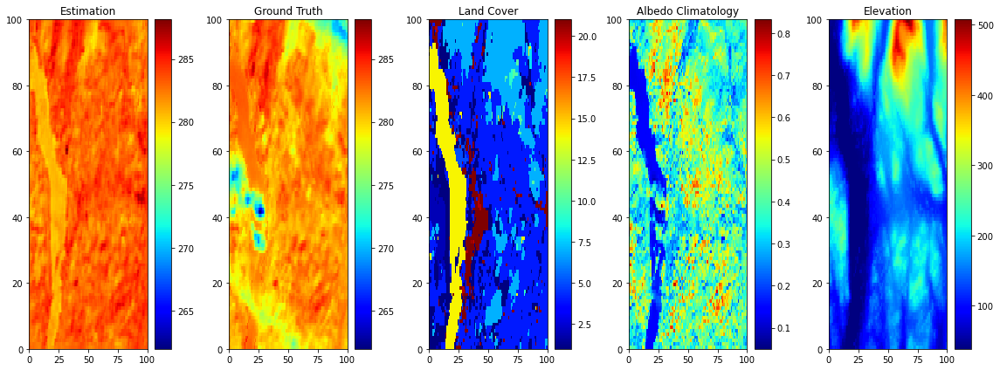

Date: 2014-10-29T11:10:18.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


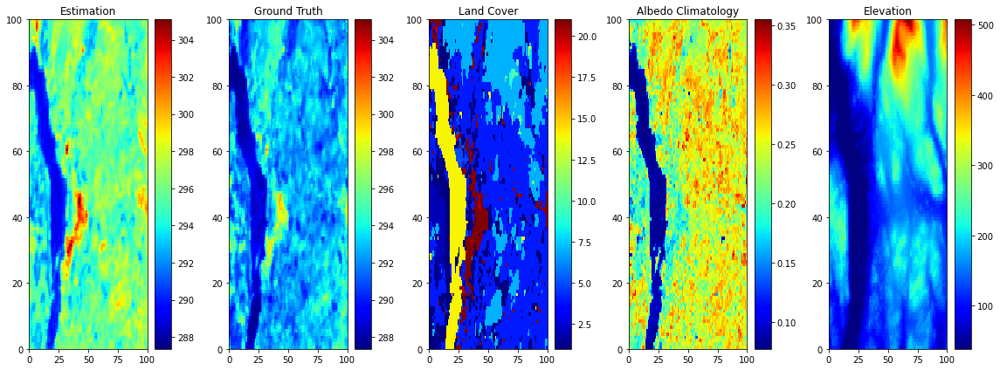

Date: 2015-08-13T11:09:50.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


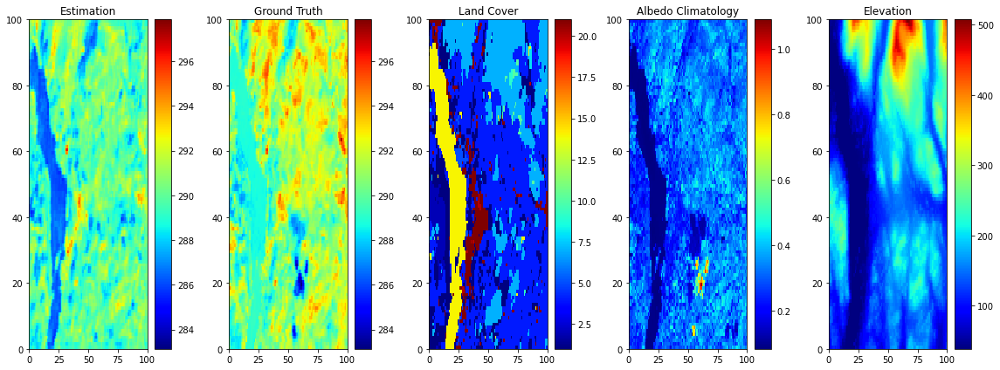

Date: 2015-09-30T11:10:09.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


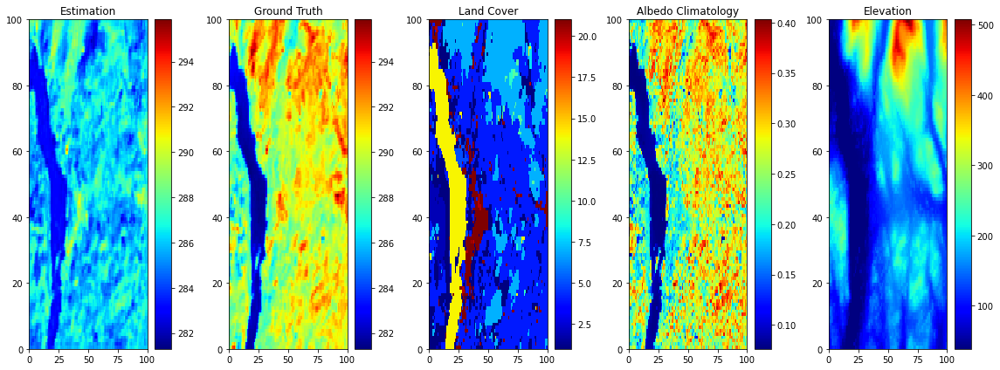

Date: 2017-03-27T11:09:44.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


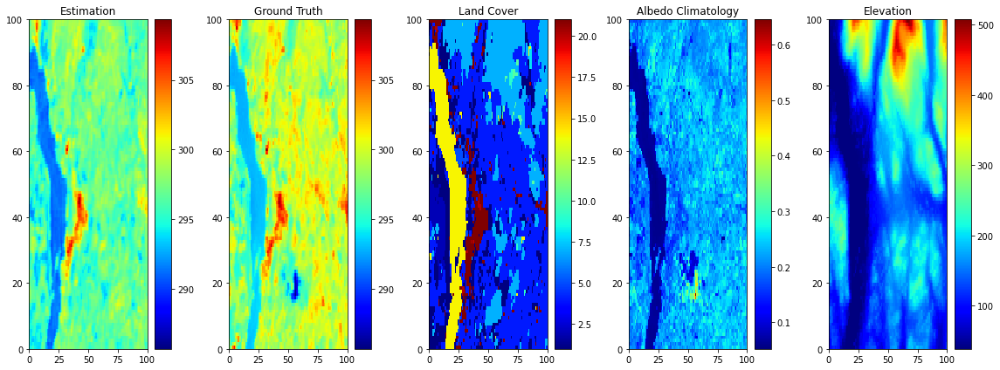

Date: 2017-07-17T11:09:59.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


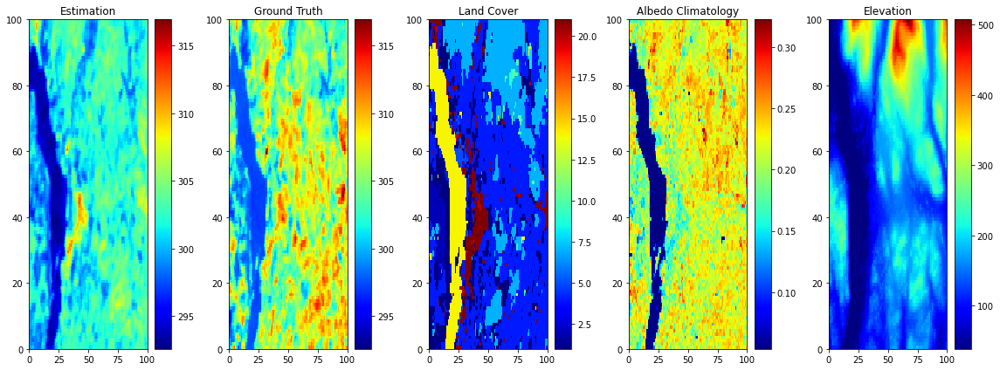

Date: 2018-07-04T11:09:13.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


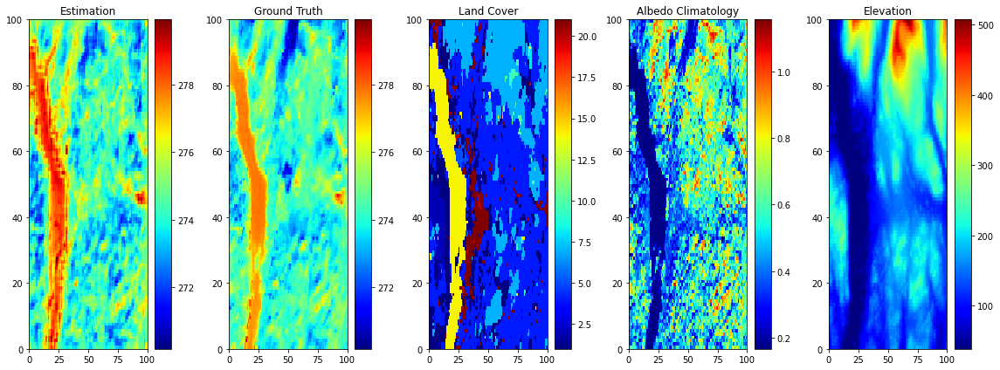

Date: 2019-01-28T11:09:55.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


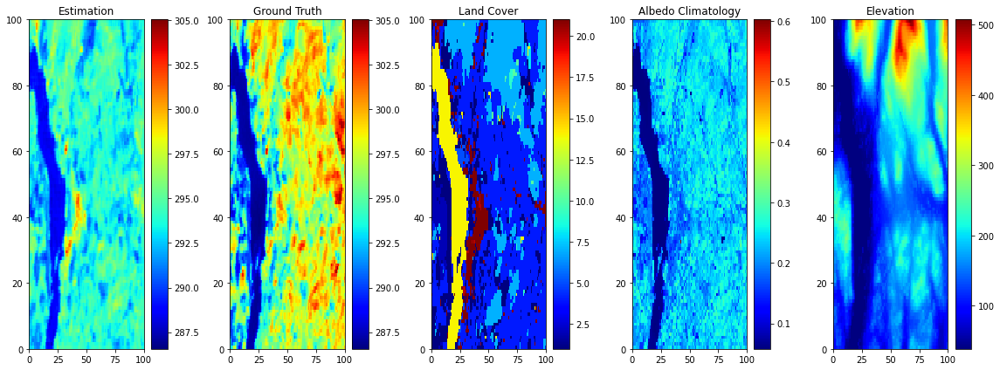

Date: 2020-05-06T11:09:33.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


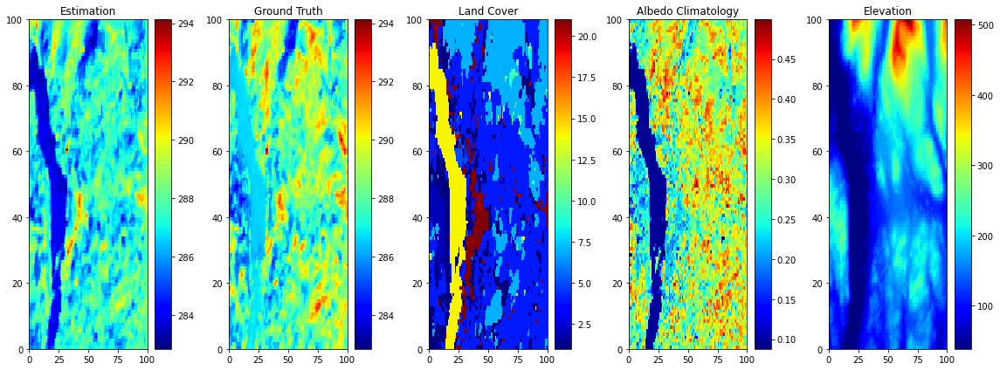

Date: 2020-09-27T11:10:26.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


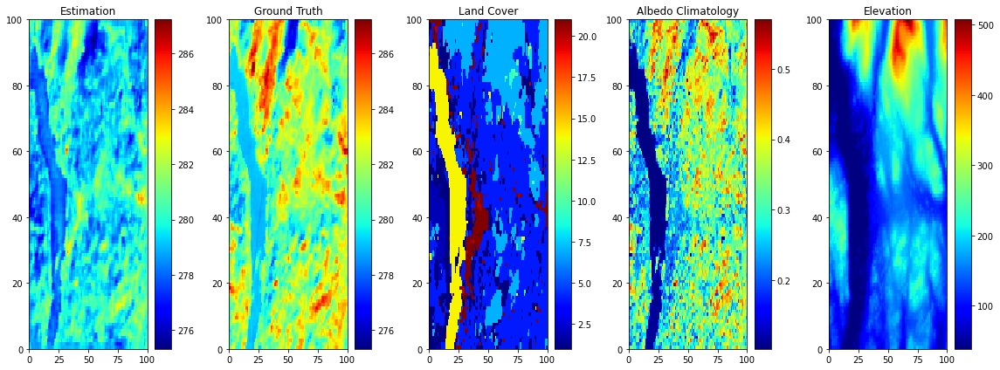

Date: 2022-03-01T11:10:09.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


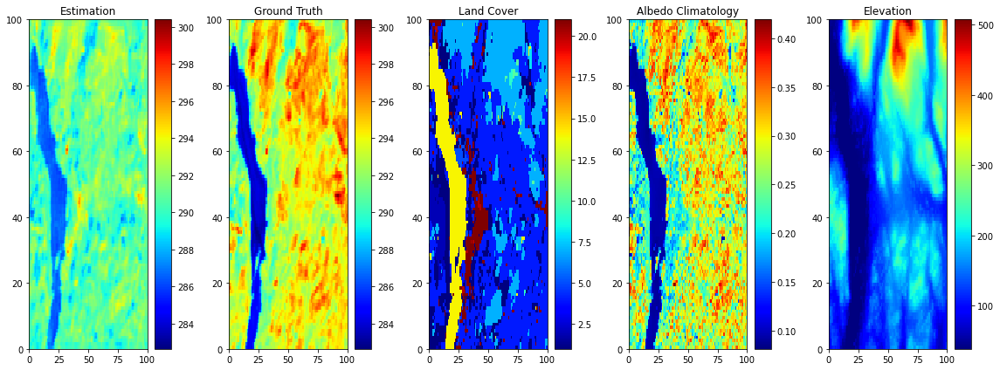

Date: 2022-03-25T11:09:56.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


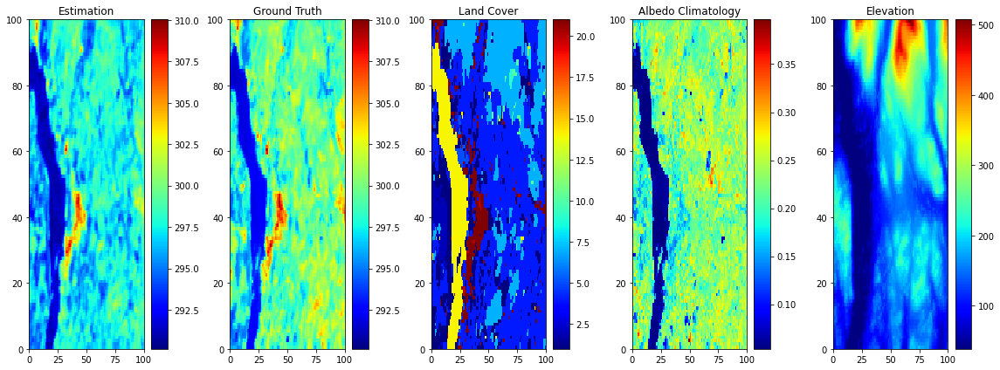

Date: 2022-07-07T11:09:59.000000000
GPS Location (lat, lon): (54.383627, -2.893779)
Easting, Northing: (342050, 499050)


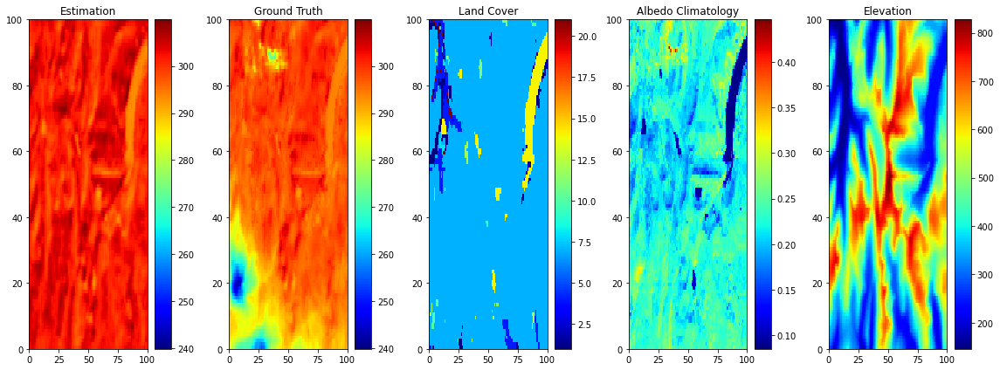

Date: 2013-07-22T11:12:05.000000000
GPS Location (lat, lon): (54.491683, -2.865259)
Easting, Northing: (344050, 511050)


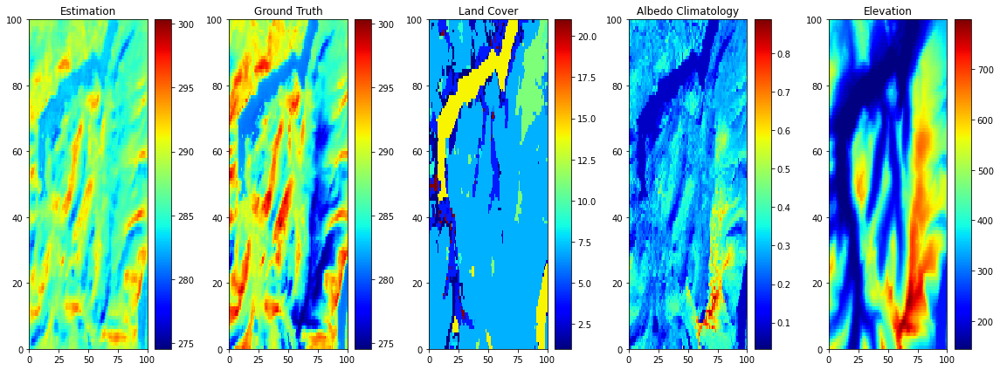

Date: 2017-03-27T11:09:44.000000000
GPS Location (lat, lon): (54.545486, -2.881856)
Easting, Northing: (343050, 517050)


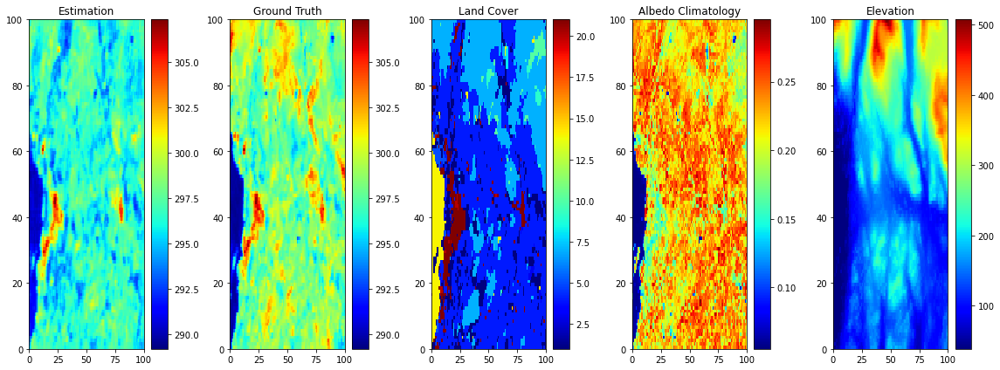

Date: 2015-06-10T11:09:23.000000000
GPS Location (lat, lon): (54.383852, -2.862989)
Easting, Northing: (344050, 499050)


In [7]:
try:
    location_name = "Lake District (Scafell Pike)"  # Replace with the desired location name
    lon, lat = get_coordinates(location_name, all_locations)
    print(f"Coordinates for {location_name}: lon={lon}, lat={lat}")

    # Assuming ds_test_toy is defined as your xarray dataset
    all_closest_scenes = find_all_closest_scenes(ds_test_toy, lon, lat, max_distance=40000)

    # Print all the closest scenes
    for box_index, distance in all_closest_scenes:
        print(f"Scene (Box): {box_index}, Distance: {distance:.2f} meters")

except ValueError as e:
    print(e)
    
for box_index, distance in all_closest_scenes:
    # Extract ground truth and estimation data
    estimation = ds_test_toy.hires_estimate[box_index, 0, :, :].values
    ground_truth = ds_test_toy.ST_slices[box_index, 0, :, :].values

    # Determine shared color scale limits
    vmin = min(estimation.min(), ground_truth.min())
    vmax = max(estimation.max(), ground_truth.max())

    plt.figure(figsize=(16, 6))  # Set a larger figure size

    # Plot the estimated high resolution
    plt.subplot(1, 5, 1)  # 1 row, 5 columns, 1st subplot
    plt.pcolormesh(estimation, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Estimation")

    # Plot the actual high resolution (ground truth)
    plt.subplot(1, 5, 2)  # 1 row, 5 columns, 2nd subplot
    plt.pcolormesh(ground_truth, cmap='jet', vmin=vmin, vmax=vmax)
    plt.colorbar()
    plt.title("Ground Truth")

    # Plot the land cover
    plt.subplot(1, 5, 3)  # 1 row, 5 columns, 3rd subplot
    plt.pcolormesh(ds_test_toy.land_cover[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Land Cover")   

    # Plot the albedo
    plt.subplot(1, 5, 4)  # 1 row, 5 columns, 4th subplot
    plt.pcolormesh(ds_test_toy.albedo[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Albedo Climatology")     

    # Plot the elevation
    plt.subplot(1, 5, 5)  # 1 row, 5 columns, 5th subplot
    plt.pcolormesh(ds_test_toy.elevation[box_index, 0, :, :], cmap='jet')
    plt.colorbar()
    plt.title("Elevation")        

    plt.tight_layout()
    plt.show()

    # Extract easting and northing for the center of the box
    eastings = ds_test_toy.x_eastings[box_index, :].values
    northings = ds_test_toy.y_northings[box_index, :].values

    # Calculate the middle point
    middle_easting = eastings[len(eastings) // 2]
    middle_northing = northings[len(northings) // 2]

    # Convert middle point back to GPS coordinates
    lon, lat = transformer_to_gps.transform(middle_easting, middle_northing)

    # Print additional information
    print(f"Date: {ds_test_toy.box_time[box_index].values}")
    print(f"GPS Location (lat, lon): ({lat:.6f}, {lon:.6f})")
    print(f"Easting, Northing: ({middle_easting}, {middle_northing})")   